# Proportional Control using EMG Data

In [4]:
import scipy.io
from scipy.signal import filtfilt, butter
from scipy import stats
from scipy.stats import zscore
from scipy.interpolate import interp1d
from sklearn.metrics import mutual_info_score
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import datasets, layers, models
from tensorflow.keras.regularizers import l1, l2
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense, Conv2D, Conv2DTranspose, MaxPooling2D, UpSampling2D, LeakyReLU, GRU
from tensorflow.keras.callbacks import LearningRateScheduler, ReduceLROnPlateau, EarlyStopping, ModelCheckpoint
import tensorflow_model_optimization as tfmot
import tempfile
from sklearn.model_selection import train_test_split, RepeatedKFold, cross_val_score, KFold
#from scikeras.wrappers import KerasRegressor
from sklearn import preprocessing
import pytest
import sklearn
import pandas
from tensorflow.keras import regularizers
from matrix_factorization import multiplication_update

import pandas as pd
from sklearn.datasets import fetch_20newsgroups
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn. decomposition import NMF
from my_helper import *
from my_helper_Transformer import *

## HCM Lab Data Visualization, Synergy Extraction, and Model Training

In [26]:
# HCM Lab data Visualization and Extraction
# Hamdy Osama 26/12/2023

#read Matlab file of Subject1

print("Starting Reading Data of Subject 1")

#INDEX Motion
#s1_mat1 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject1/Trial 1/MF_index_Processed.mat')

#MIDDLE Motion
#s1_mat2 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject1/Trial 1/MF_middle_Processed.mat')

#RING Motion
#s1_mat3 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject1/Trial 1/MF_ring_Processed.mat')

#PINKY Motion
#s1_mat4 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject1/Trial 1/MF_pinky_Processed.mat')

#THUMB Motion
#s1_mat5 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject1/Trial 1/MF_thumb_Processed.mat')

print("Finished Reading Data of Subject 1")

#######################################################################################

#read Matlab file of Subject2

print("Starting Reading Data of Subject 2")

#INDEX Motion
#s2_mat1 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 1/HO_index_Processed.mat')

#MIDDLE Motion
#s2_mat2 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 1/HO_middle_Processed.mat')

#RING Motion
#s2_mat3 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 1/HO_ring_Processed.mat')

#PINKY Motion
#s2_mat4 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 1/HO_pinky_Processed.mat')

#THUMB Motion
#s2_mat5 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 1/HO_thumb_Processed.mat')

###################Trial 2####################
##INDEX Motion
#s2_t2_mat1 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 2/HO_index_Processed.mat')
#
##MIDDLE Motion
#s2_t2_mat2 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 2/HO_middle_Processed.mat')
#
##RING Motion
##s2_t2_mat3 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 2/HO_ring_Processed.mat')
#
##PINKY Motion
#s2_t2_mat4 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 2/HO_pinky_Processed.mat')
#
##THUMB Motion
#s2_t2_mat5 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 2/HO_thumb_Processed.mat')
#
###################Trial 3####################
##INDEX Motion
#s2_t3_mat1 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 3/HO_index_Processed.mat')
#
##MIDDLE Motion
#s2_t3_mat2 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 3/HO_middle_Processed.mat')
#
##RING Motion
#s2_t3_mat3 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 3/HO_ring_Processed.mat')
#
##PINKY Motion
##s2_t3_mat4 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 3/HO_pinky_Processed.mat')
#
##THUMB Motion
#s2_t3_mat5 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 3/HO_thumb_Processed.mat')
#

###################Trial 4####################
##INDEX Motion
s2_t4_mat1 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 4/HO_index_S_Processed.mat')

#MIDDLE Motion
s2_t4_mat2 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 4/HO_middle_S_Processed.mat')

#RING Motion
s2_t4_mat3 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 4/HO_ring_S_Processed.mat')

#PINKY Motion
s2_t4_mat4 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 4/HO_pinky_S_Processed.mat')

#THUMB Motion
#s2_t4_mat5 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 4/HO_thumb_S_Processed.mat')


##INDEX Motion
s2_t5_mat1 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 4/HO_index_F_Processed.mat')

#MIDDLE Motion
s2_t5_mat2 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 4/HO_middle_F_Processed.mat')

#RING Motion
s2_t5_mat3 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 4/HO_ring_F_Processed.mat')

#PINKY Motion
s2_t5_mat4 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 4/HO_pinky_F_Processed.mat')

#THUMB Motion
s2_t5_mat5 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 4/HO_thumb_F_Processed.mat')


print("Finished Reading Data of Subject 2")

#######################################################################################

#read Matlab file of Subject3

print("Starting Reading Data of Subject 3")

#INDEX Motion
#s3_mat1 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject3/Trial 1/SR_index_Processed.mat')

#MIDDLE Motion
#s3_mat2 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject3/Trial 1/SR_middle_Processed.mat')

#RING Motion
#s3_mat3 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject3/Trial 1/SR_ring_Processed.mat')

#PINKY Motion
#s3_mat4 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject3/Trial 1/SR_pinky_Processed.mat')

#THUMB Motion
#s3_mat5 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject3/Trial 1/SR_thumb_Processed.mat')

print("Finished Reading Data of Subject 3")

#######################################################################################

#read Matlab file of Subject1

print("Starting Reading Data of Subject 4")

#INDEX Motion
#s4_mat1 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject4/Trial 1/WA_index_Processed.mat')

#MIDDLE Motion
#s4_mat2 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject4/Trial 1/WA_middle_Processed.mat')

#RING Motion
#s4_mat3 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject4/Trial 1/WA_ring_Processed.mat')

#PINKY Motion
#s4_mat4 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject4/Trial 1/WA_pinky_Processed.mat')

#THUMB Motion
#s4_mat5 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject4/Trial 1/WA_thumb_Processed.mat')

print("Finished Reading Data of Subject 4")

#######################################################################################

Starting Reading Data of Subject 1
Finished Reading Data of Subject 1
Starting Reading Data of Subject 2
Finished Reading Data of Subject 2
Starting Reading Data of Subject 3
Finished Reading Data of Subject 3
Starting Reading Data of Subject 4
Finished Reading Data of Subject 4


In [27]:
# 17/1/2024. Made by Hamdy Osama
# window_duration_sec = 0.075, window_overlap_percentage=50, rows = 12, thickness = 12 ---> For EMG_per_trial of 144 samples
# window_duration_sec = 0.208, window_overlap_percentage=50, rows = 20, thickness = 20 ---> For EMG_per_trial of 400 samples

# Performing Dataset Preparation on all data of all subjects
EMG_MODE = "raw"
ACC_DATA = True
UP_SAMPLE = False

#[EMG_per_trial, S1_ALL_EMG_NORM, S1_EMG_SEQ_SET, S1_EMG_3D_SET, S1_ALL_KIN_OVERSAMPLE, 
#S1_KIN_RAW_SET, S1_KIN_NORM_SET, S1_ALL_EMG, S1_ALL_EMG_UP, S1_ALL_EMG_REC, S1_ALL_KIN] = HCM_EMG_PIPELINE(s1_mat1, s1_mat2, 
#                                                                                            s1_mat3, s1_mat4, s1_mat5, 
#                                                                                            window_duration_sec = 0.208, 
#                                                                                            window_overlap_percentage=50,
#                                                                                            rows = 20, thickness = 20,
#                                                                                            return_all = True, 
#                                                                                            EMG_mode = EMG_MODE,
#                                                                                            ACC_Data = ACC_DATA,
#                                                                                            Up_Sample = UP_SAMPLE)
#
#print("#################################################### FINISHED S1 ################################################")
#
#[EMG_per_trial, S2_ALL_EMG_NORM, S2_EMG_SEQ_SET, S2_EMG_3D_SET, S2_ALL_KIN_OVERSAMPLE, 
#S2_KIN_RAW_SET, S2_KIN_NORM_SET, S2_ALL_EMG, S2_ALL_EMG_UP, S2_ALL_EMG_REC, S2_ALL_KIN] = HCM_EMG_PIPELINE(s2_mat1, s2_mat2, 
#                                                                                            s2_mat3, s2_mat4, s2_mat5, 
#                                                                                            window_duration_sec = 0.208, 
#                                                                                            window_overlap_percentage=50,
#                                                                                            rows = 20, thickness = 20,
#                                                                                            return_all = True,
#                                                                                            EMG_mode = EMG_MODE,
#                                                                                            ACC_Data = ACC_DATA,
#                                                                                            Up_Sample = UP_SAMPLE)

#[EMG_per_trial, S2T2_ALL_EMG_NORM, S2T2_EMG_SEQ_SET, S2T2_EMG_3D_SET, S2T2_ALL_KIN_OVERSAMPLE, 
#S2T2_KIN_RAW_SET, S2T2_KIN_NORM_SET, S2T2_ALL_EMG, S2T2_ALL_EMG_UP, S2T2_ALL_EMG_REC, S2T2_ALL_KIN] = HCM_EMG_PIPELINE(s2_t2_mat1, s2_t2_mat2, 
#                                                                                            s2_t2_mat4, s2_t2_mat5, 
#                                                                                            window_duration_sec = 0.208, 
#                                                                                            window_overlap_percentage=50,
#                                                                                            rows = 20, thickness = 20,
#                                                                                            return_all = True,
#                                                                                            EMG_mode = EMG_MODE,
#                                                                                            ACC_Data = ACC_DATA,
#                                                                                            Up_Sample = UP_SAMPLE)
#
#[EMG_per_trial, S2T3_ALL_EMG_NORM, S2T3_EMG_SEQ_SET, S2T3_EMG_3D_SET, S2T3_ALL_KIN_OVERSAMPLE, 
#S2T3_KIN_RAW_SET, S2T3_KIN_NORM_SET, S2T3_ALL_EMG, S2T3_ALL_EMG_UP, S2T3_ALL_EMG_REC, S2T3_ALL_KIN] = HCM_EMG_PIPELINE(s2_t3_mat1, s2_t3_mat2, 
#                                                                                            s2_t3_mat3, s2_t3_mat5, 
#                                                                                            window_duration_sec = 0.208, 
#                                                                                            window_overlap_percentage=50,
#                                                                                            rows = 20, thickness = 20,
#                                                                                            return_all = True,
#                                                                                            EMG_mode = EMG_MODE,
#                                                                                            ACC_Data = ACC_DATA,
#                                                                                            Up_Sample = UP_SAMPLE)
#


[EMG_per_trial, S2T4_ALL_EMG_NORM, S2T4_EMG_SEQ_SET, S2T4_EMG_3D_SET, S2T4_ALL_KIN_OVERSAMPLE, 
S2T4_KIN_RAW_SET, S2T4_KIN_NORM_SET, S2T4_ALL_EMG, S2T4_ALL_EMG_UP, S2T4_ALL_EMG_REC, S2T4_ALL_KIN] = HCM_EMG_PIPELINE(s2_t4_mat1, s2_t4_mat2, 
                                                                                            s2_t4_mat3, s2_t4_mat4,  
                                                                                            window_duration_sec = 0.208, 
                                                                                            window_overlap_percentage=50,
                                                                                            rows = 20, thickness = 20,
                                                                                            return_all = True,
                                                                                            EMG_mode = EMG_MODE,
                                                                                            ACC_Data = ACC_DATA,
                                                                                            Up_Sample = UP_SAMPLE)


[EMG_per_trial, S2T5_ALL_EMG_NORM, S2T5_EMG_SEQ_SET, S2T5_EMG_3D_SET, S2T5_ALL_KIN_OVERSAMPLE, 
S2T5_KIN_RAW_SET, S2T5_KIN_NORM_SET, S2T5_ALL_EMG, S2T5_ALL_EMG_UP, S2T5_ALL_EMG_REC, S2T5_ALL_KIN] = HCM_EMG_PIPELINE(s2_t5_mat1, s2_t5_mat2, 
                                                                                            s2_t5_mat3, s2_t5_mat4, s2_t5_mat5, 
                                                                                            window_duration_sec = 0.208, 
                                                                                            window_overlap_percentage=50,
                                                                                            rows = 20, thickness = 20,
                                                                                            return_all = True,
                                                                                            EMG_mode = EMG_MODE,
                                                                                            ACC_Data = ACC_DATA,
                                                                                            Up_Sample = UP_SAMPLE)


print("#################################################### FINISHED S2 ################################################")

#[EMG_per_trial, S3_ALL_EMG_NORM, S3_EMG_SEQ_SET, S3_EMG_3D_SET, S3_ALL_KIN_OVERSAMPLE, 
#S3_KIN_RAW_SET, S3_KIN_NORM_SET, S3_ALL_EMG, S3_ALL_EMG_UP, S3_ALL_EMG_REC, S3_ALL_KIN] = HCM_EMG_PIPELINE(s3_mat1, s3_mat2, 
#                                                                                            s3_mat3, s3_mat4, s3_mat5, 
#                                                                                            window_duration_sec = 0.208, 
#                                                                                            window_overlap_percentage=50,
#                                                                                            rows = 20, thickness = 20,
#                                                                                            return_all = True,
#                                                                                            EMG_mode = EMG_MODE,
#                                                                                            ACC_Data = ACC_DATA,
#                                                                                            Up_Sample = UP_SAMPLE)
#
#print("#################################################### FINISHED S3 ################################################")
#
#[EMG_per_trial, S4_ALL_EMG_NORM, S4_EMG_SEQ_SET, S4_EMG_3D_SET, S4_ALL_KIN_OVERSAMPLE, 
#S4_KIN_RAW_SET, S4_KIN_NORM_SET, S4_ALL_EMG, S4_ALL_EMG_UP, S4_ALL_EMG_REC, S4_ALL_KIN] = HCM_EMG_PIPELINE(s4_mat1, s4_mat2, 
#                                                                                            s4_mat3, s4_mat4, s4_mat5, 
#                                                                                            window_duration_sec = 0.208, 
#                                                                                            window_overlap_percentage=50,
#                                                                                            rows = 20, thickness = 20,
#                                                                                            return_all = True,
#                                                                                            EMG_mode = EMG_MODE,
#                                                                                            ACC_Data = ACC_DATA,
#                                                                                            Up_Sample = UP_SAMPLE)
#
#print("#################################################### FINISHED S4 ################################################")



Extracted Data shape: (21978,)
Extracted Data shape: (21978,)
Extracted Data shape: (21978,)
Extracted Data shape: (21978,)
Extracted Data shape: (21978,)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093, 1)
Extracted Data shape: (141093

Finished data extraction for finger  4
#######################################################################################
Finished oversampling kinematics data for finger 1
Finished normalizing EMG data for finger 1
EMG Data shape after window splitting is:
(703, 400, 4, 14)
Kinmatics Data shape after window splitting is:
(703, 5)
Finished normalizing Kinematics Data for finger 1
(703, 400, 4, 14)
Finished dataset creation for finger 1
#######################################################################################
Finished oversampling kinematics data for finger 2
Finished normalizing EMG data for finger 2
EMG Data shape after window splitting is:
(751, 400, 4, 14)
Kinmatics Data shape after window splitting is:
(751, 5)
Finished normalizing Kinematics Data for finger 2
(751, 400, 4, 14)
Finished dataset creation for finger 2
#######################################################################################
Finished oversampling kinematics data for finger 3
Finished n

Finished data extraction for finger  4
#######################################################################################
Extracted Data shape: (5417,)
Extracted Data shape: (5417,)
Extracted Data shape: (5417,)
Extracted Data shape: (5417,)
Extracted Data shape: (5417,)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 1)
Extracted Data shape: (34775, 

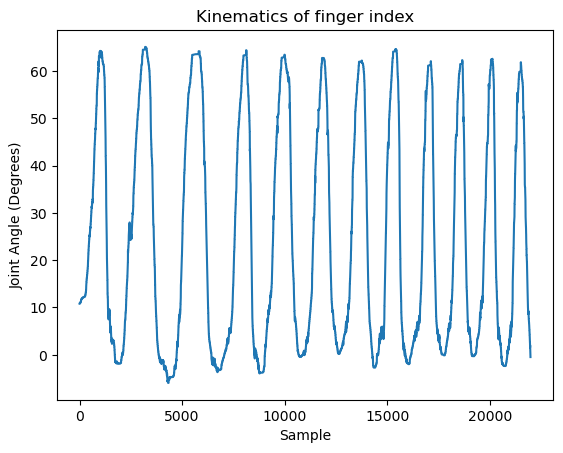

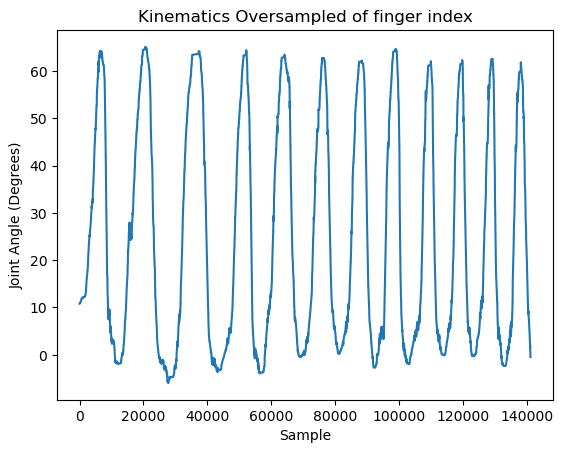

EMG Shape for Sequential Machine Learning models from trial 0 is :
(703, 1600, 14)
EMG Shape for 3D Machine Learning models from trial 0 is :
(703, 40, 40, 14)


<function matplotlib.pyplot.show(close=None, block=None)>

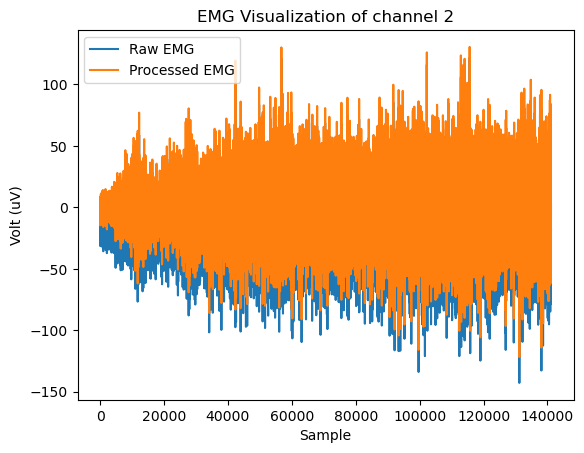

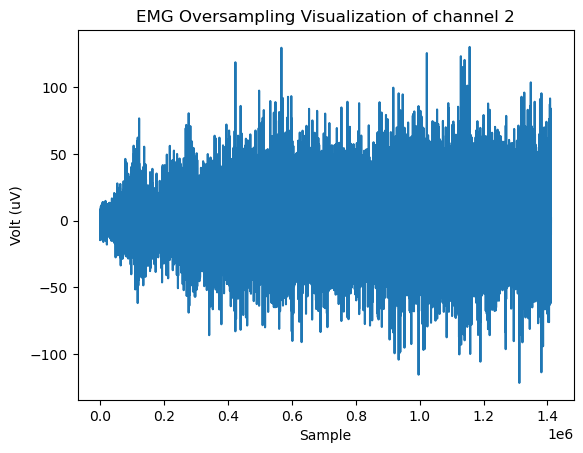

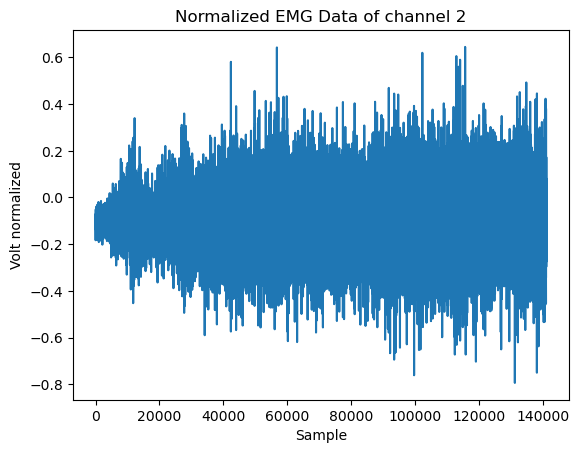

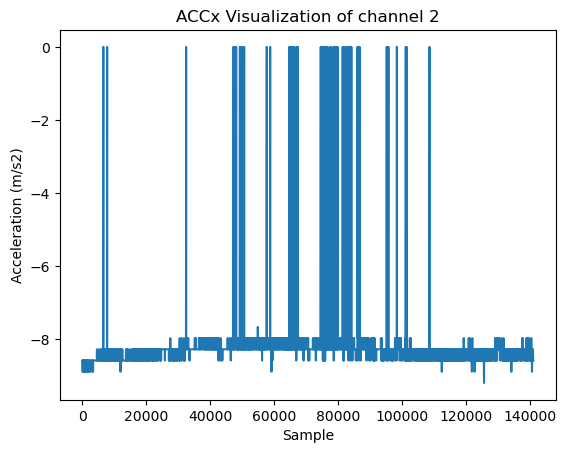

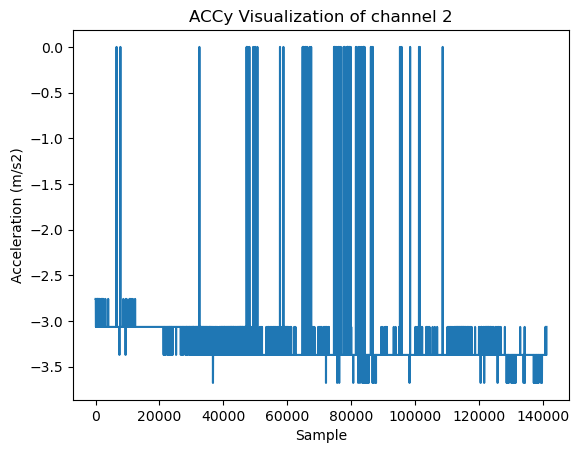

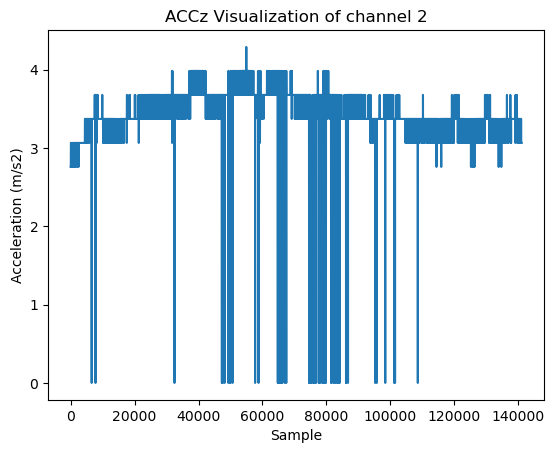

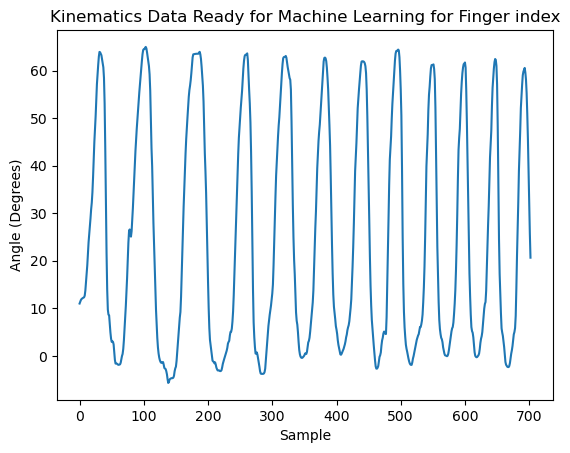

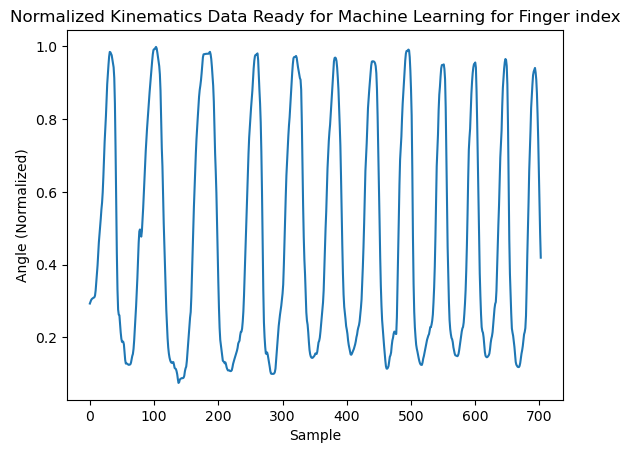

In [4]:
# Validation that Dataset Extraction is complete

trial_selected = 0    # Selection here is based on trial movement:   0->index , 1->middle, 2->ring, 3->pinky, 4->thumb
finger_selected = 0   # Selection here is based on finger number:   0->index , 1->middle, 2->ring, 3->pinky, 4->thumb
channel_selected = 2  # Selection here is based on channel number: from 1 to 12

if (finger_selected == 0):
    finger = 'index'
elif (finger_selected == 1):
    finger = 'middle'
elif (finger_selected == 2):
    finger = 'ring'
elif (finger_selected == 3):
    finger = 'pinky'
elif (finger_selected == 4):
    finger = 'thumb'

#plot Kinematics data for validation
plt.figure()
plt.plot(S2T4_ALL_KIN[trial_selected][:,finger_selected])
plt.title('Kinematics of finger '+ finger)
plt.xlabel('Sample')
plt.ylabel('Joint Angle (Degrees)')
plt.show()

#plot Kinematics oversampled data for validation
plt.figure()
plt.plot(S2T4_ALL_KIN_OVERSAMPLE[trial_selected][:,finger_selected])
plt.title('Kinematics Oversampled of finger '+ finger)
plt.xlabel('Sample')
plt.ylabel('Joint Angle (Degrees)')
plt.show()

# Validation of EMG Data Extraction and its rectified, bias removed version
plt.figure()
plt.plot(S2T4_ALL_EMG[trial_selected][:,channel_selected-1]) #channel 1 EMG Data
if (ACC_DATA == True):
    plt.plot(S2T4_ALL_EMG_REC[trial_selected][:, 0, channel_selected-1]) #channel 1 EMG Data
else:
    plt.plot(S2T4_ALL_EMG_REC[trial_selected][:, channel_selected-1]) #channel 1 EMG Data

plt.title('EMG Visualization of channel '+ str(channel_selected))
plt.xlabel('Sample')
plt.ylabel('Volt (uV)')
plt.legend(labels= ['Raw EMG', 'Processed EMG'], loc='upper left')
plt.show

# Validation of EMG Data Upsampling Operation
plt.figure()
if (ACC_DATA == True):
    plt.plot(S2T4_ALL_EMG_UP[trial_selected][:, 0, channel_selected-1]) #channel 1 EMG Data
else:
    plt.plot(S2T4_ALL_EMG_UP[trial_selected][:, channel_selected-1]) #channel 1 EMG Data

plt.title('EMG Oversampling Visualization of channel '+ str(channel_selected))
plt.xlabel('Sample')
plt.ylabel('Volt (uV)')
plt.show

#Validation of EMG normalization
plt.figure()
if (ACC_DATA == True):
    plt.plot(S2T4_ALL_EMG_NORM[trial_selected][:, 0, channel_selected - 1]) #channel 1 normalized EMG Data
else:
    plt.plot(S2T4_ALL_EMG_NORM[trial_selected][:, channel_selected-1]) #channel 1 normalized EMG Data

plt.title('Normalized EMG Data of channel '+ str(channel_selected))
plt.xlabel('Sample')
plt.ylabel('Volt normalized')
plt.show

# Validation of ACC Data Extraction and its rectified, bias removed version
if (ACC_DATA == True):
    plt.figure()
    plt.plot(S2T4_ALL_EMG_REC[trial_selected][:, 1, channel_selected-1]) #channel 1 ACCx Data
    plt.title('ACCx Visualization of channel '+ str(channel_selected))
    plt.xlabel('Sample')
    plt.ylabel('Acceleration (m/s2)')
    plt.show
    plt.figure()
    plt.plot(S2T4_ALL_EMG_REC[trial_selected][:, 2, channel_selected-1]) #channel 1 ACCx Data
    plt.title('ACCy Visualization of channel '+ str(channel_selected))
    plt.xlabel('Sample')
    plt.ylabel('Acceleration (m/s2)')
    plt.show
    plt.figure()
    plt.plot(S2T4_ALL_EMG_REC[trial_selected][:, 3, channel_selected-1]) #channel 1 ACCx Data
    plt.title('ACCz Visualization of channel '+ str(channel_selected))
    plt.xlabel('Sample')
    plt.ylabel('Acceleration (m/s2)')
    plt.show

#plot data for validation of Kinematics Dataset Creation and Print EMG Input Shape
print("EMG Shape for Sequential Machine Learning models from trial " + str(trial_selected) + " is :")
print(S2T4_EMG_SEQ_SET[trial_selected].shape)
plt.figure()
plt.plot(S2T4_KIN_RAW_SET[trial_selected][:,finger_selected])
plt.title('Kinematics Data Ready for Machine Learning for Finger '+ finger)
plt.xlabel('Sample')
plt.ylabel('Angle (Degrees)')
plt.show

#plot data for validation of Kinematics Normalized Dataset Creation
print("EMG Shape for 3D Machine Learning models from trial " + str(trial_selected) + " is :")
print(S2T4_EMG_3D_SET[trial_selected].shape)
plt.figure()
plt.plot(S2T4_KIN_NORM_SET[trial_selected][:,finger_selected])
plt.title('Normalized Kinematics Data Ready for Machine Learning for Finger '+ finger)
plt.xlabel('Sample')
plt.ylabel('Angle (Normalized)')
plt.show

In [5]:
# Test Mutual Information between input and Output
# RETURN TO THIS HAMDY TO PREPARE BAR GRAPHS

if (ACC_DATA == True):
    MI_Data = HCM_MI_Test(S2T4_ALL_EMG_NORM[0][:,0,:], S2T4_ALL_KIN_OVERSAMPLE[0])
else:
    MI_Data = HCM_MI_Test(S2T4_ALL_EMG_NORM[0], S2T4_ALL_KIN_OVERSAMPLE[0])
print(MI_Data)



Mutual Information between channel  1 and joint  1 is:  0.5076976091437406
Mutual Information between channel  1 and joint  2 is:  0.49552655201662327
Mutual Information between channel  1 and joint  3 is:  0.513314212652096
Mutual Information between channel  1 and joint  4 is:  0.4530021372409239
Mutual Information between channel  1 and joint  5 is:  0.36585333673736353
Mutual Information between channel  2 and joint  1 is:  0.5817823922817464
Mutual Information between channel  2 and joint  2 is:  0.5673819243770748
Mutual Information between channel  2 and joint  3 is:  0.5927111158805267
Mutual Information between channel  2 and joint  4 is:  0.5247728629689591
Mutual Information between channel  2 and joint  5 is:  0.4267856910489113
Mutual Information between channel  3 and joint  1 is:  0.5400452742374615
Mutual Information between channel  3 and joint  2 is:  0.5269934602871529
Mutual Information between channel  3 and joint  3 is:  0.5435758710104113
Mutual Information betwe

In [28]:
# MRMR Study to select best performing 14 channels as model input

opt_arr1 = HCM_MRMR_data(S2T4_ALL_EMG_NORM, S2T4_ALL_KIN_OVERSAMPLE, 14)
opt_arr2 = HCM_MRMR_data(S2T5_ALL_EMG_NORM, S2T5_ALL_KIN_OVERSAMPLE, 14)
opt_arr_all = opt_arr1 + opt_arr2

S2T4_ALL_EMG_NORM_optimized = HCM_Optimize_Input_Data(S2T4_ALL_EMG_NORM, opt_arr_all, 14)
S2T5_ALL_EMG_NORM_optimized = HCM_Optimize_Input_Data(S2T5_ALL_EMG_NORM, opt_arr_all, 14)

 
S2T4_EMG_3D_SET_optimized = []

for i in range(len(S2T4_ALL_EMG_NORM_optimized)):
    # Prepare dataset trials by sizing windows of EMG and averaged Kinematics data.
    emg_samples, kinematics_samples, EMG_per_trial = HCM_Create_Dataset(S2T4_ALL_EMG_NORM_optimized[i],
                                                                        S2T4_ALL_KIN[i], window_duration_sec = 0.208, 
                                                                        window_overlap_percentage=50, ACC_Data = False)
    emg_samples_3D = HCM_reshape_trials_to_3d(emg_samples, rows=20, thickness=20, ACC_Data = False)
    S2T4_EMG_3D_SET_optimized.append(emg_samples_3D)

S2T5_EMG_3D_SET_optimized = []

for i in range(len(S2T5_ALL_EMG_NORM_optimized)):
    # Prepare dataset trials by sizing windows of EMG and averaged Kinematics data.
    emg_samples, kinematics_samples, EMG_per_trial = HCM_Create_Dataset(S2T5_ALL_EMG_NORM_optimized[i],
                                                                        S2T5_ALL_KIN[i], window_duration_sec = 0.208, 
                                                                        window_overlap_percentage=50, ACC_Data = False)
    emg_samples_3D = HCM_reshape_trials_to_3d(emg_samples, rows=20, thickness=20, ACC_Data = False)
    S2T5_EMG_3D_SET_optimized.append(emg_samples_3D)

[['ACCz 13', 'ACCz 6', 'ACCz 2', 'ACCy 5', 'ACCx 0', 'ACCz 8', 'ACCz 0', 'ACCy 4', 'ACCx 2', 'ACCx 6', 'ACCz 7', 'ACCx 8', 'ACCz 4', 'ACCx 11']]
[['ACCz 6', 'ACCz 7', 'ACCx 6', 'ACCy 4', 'ACCz 8', 'ACCy 5', 'ACCx 2', 'ACCx 8', 'ACCx 0', 'ACCz 2', 'ACCz 4', 'ACCz 0', 'ACCy 3', 'ACCx 7']]
[['ACCz 7', 'ACCz 6', 'ACCy 4', 'ACCz 8', 'ACCy 5', 'ACCz 13', 'ACCx 2', 'ACCx 6', 'ACCz 4', 'ACCx 0', 'ACCz 2', 'ACCx 8', 'ACCy 2', 'ACCz 0']]
[['ACCz 7', 'ACCz 6', 'ACCy 4', 'ACCz 0', 'ACCz 2', 'ACCx 0', 'ACCy 5', 'ACCz 8', 'ACCz 4', 'ACCz 13', 'ACCx 2', 'ACCx 6', 'ACCx 11', 'ACCx 8']]
[['ACCz 7', 'ACCz 6', 'ACCz 0', 'ACCy 5', 'ACCz 2', 'ACCx 0', 'ACCz 13', 'ACCx 2', 'ACCy 3', 'ACCx 4', 'ACCx 11', 'ACCy 2', 'ACCx 7', 'ACCz 1']]
[['ACCz 13', 'ACCy 10', 'EMG 10', 'EMG 4', 'EMG 12', 'EMG 6', 'ACCz 6', 'EMG 3', 'EMG 13', 'EMG 11', 'ACCy 11', 'EMG 1', 'EMG 8', 'ACCz 10']]
[['ACCz 7', 'ACCy 3', 'EMG 3', 'ACCx 8', 'ACCz 4', 'EMG 7', 'EMG 11', 'ACCz 8', 'ACCy 5', 'EMG 4', 'EMG 12', 'EMG 10', 'EMG 13', 'ACCy 4

In [29]:
S2T4_EMG_3D_SET_optimized[0].shape 

print(opt_arr_all) # Total number of trials is 45

[ 1.  9.  6. 10. 32. 12. 21.  6.  4.  9.  8. 14. 35. 13. 11.  5. 22.  0.
 13. 10. 18. 12. 23.  6.  1. 16. 10. 11.  1.  1. 18. 22. 30. 23.  0.  0.
  2.  4.  3. 12.  1.  2.  8.  8. 17.  0. 12. 16. 29. 18. 21.  2.  6. 15.
  6. 15.]


In [ ]:
# Transformer Model Training

# Step 1: Build the model
maxlen = EMG_per_trial  # Replace with the number of EMG samples per trial
embed_dim = 12  # Replace with the number of EMG channels
num_heads = 4 # Replace with your desired number of heads
ff_dim = 32  # Replace with your feed-forward dimension
num_transformer_blocks = 4  # Replace with your desired number of transformer blocks
mlp_units = [128, 64, 32]  # Replace with your desired MLP units
angles_studied = 5  # Replace with the number of angles studied

model = build_transformer_model(maxlen, embed_dim, num_heads, ff_dim, num_transformer_blocks, mlp_units, angles_studied)
model.summary()


# Step 2: Prepare the data Training and Validation Sets

# Split the data into training and testing sets
X_train, X_test = HCM_split_data(*S1_EMG_SEQ_SET, *S2_EMG_SEQ_SET, *S3_EMG_SEQ_SET
                                 , *S4_EMG_SEQ_SET, percentage = 0.70)#, emg_samples2_3D)
y_train, y_test = HCM_split_data(*S1_KIN_NORM_SET, *S2_KIN_NORM_SET
                                 , *S3_KIN_NORM_SET, *S4_KIN_NORM_SET
                                 , percentage = 0.70)#, kinematics_samples2[:,0])  

#train_test_split(
#    Transformer_EMG_Data, Transformer_Kinematics_Data, test_size=0.2, random_state=42
#)

# Print the shapes to verify
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)
print("X_test shape:", X_test.shape)
print("y_test shape:", y_test.shape)



#Step 3: Train the model

# X_train, y_train represent your training data and labels

# Compile the model
opt = keras.optimizers.Adam(learning_rate = 0.01)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=50, min_lr=0.00000001)
callback = EarlyStopping(monitor='val_loss', patience=100)

model.compile(optimizer=opt, loss=keras.losses.MeanSquaredError(), 
              metrics=pearson_r)#[tf.keras.metrics.MeanAbsolutePercentageError()])

# Train the model
transformer_specs = model.fit(X_train, y_train, epochs=100, shuffle = False, 
                              batch_size=32, validation_data=(X_test, y_test), callbacks=[reduce_lr, callback])

# Save the trained model
model.save("HCM_transformer_model.h5")


In [ ]:
# Step 4: Evaluation and Predictions
# Evaluate the model
plt.clf()
plt.plot(transformer_specs.history['pearson_r'], label='pearson_r')
plt.plot(transformer_specs.history['val_pearson_r'], label = 'val_pearson_r')
plt.xlabel('Epoch')
plt.ylabel('Correlation Coefficient')
#plt.ylim([-0.1, 0.95])
plt.legend(loc='lower right')
plt.show()
plt.plot(transformer_specs.history['loss'], label='loss')
plt.plot(transformer_specs.history['val_loss'], label = 'val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.ylim([0, 0.2])
plt.legend(loc='lower right')
plt.show()

# Make a prediction on test data
prediction_data = X_test
print(prediction_data.shape)
prediction = model.predict(prediction_data)
prediction_of_training = model.predict(X_train)
# Prepare prediction data shape to compare with labels
print(prediction.shape)
print (y_test.shape)

[0.19932798 0.24948518 0.20827253 0.18199024 0.63064355]
[0.15956129 0.36273086 0.22218014 0.17343651 0.5490817 ]


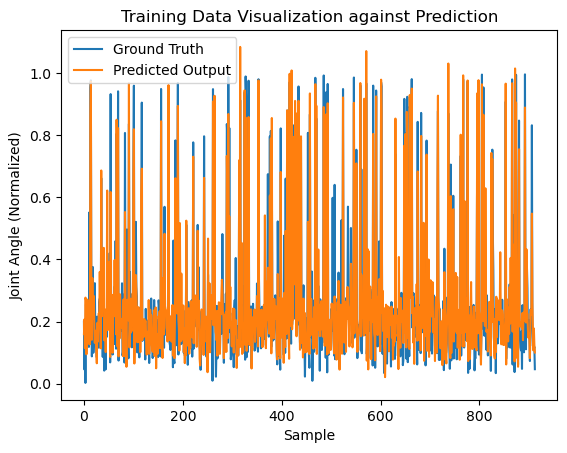

67/67 [==============================] - 31s 455ms/step


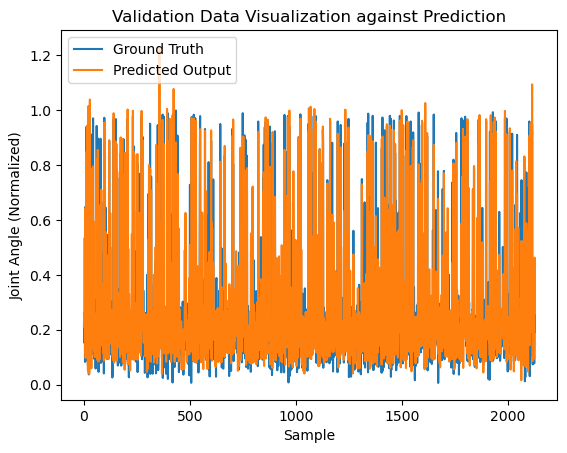

In [7]:
prediction_sample = 0
finger_to_plot = 0
print (y_test[prediction_sample])
print (prediction[prediction_sample])


plt.figure()
plt.plot(y_test[:,finger_to_plot])
plt.plot(prediction[:,finger_to_plot])
plt.title("Training Data Visualization against Prediction")
plt.xlabel('Sample')
plt.ylabel('Joint Angle (Normalized)')
plt.legend(labels= ['Ground Truth', 'Predicted Output'], loc='upper left')
plt.show()

prediction_of_training = model.predict(X_train)
plt.figure()
plt.plot(y_train[:,finger_to_plot])
plt.plot(prediction_of_training[:,finger_to_plot])
plt.title("Validation Data Visualization against Prediction")
plt.xlabel('Sample')
plt.ylabel('Joint Angle (Normalized)')
plt.legend(labels= ['Ground Truth', 'Predicted Output'], loc='upper left')
plt.show()

In [8]:
# Save the trained model
model.save("HCM_GRU_model.h5")

C:\Users\Hamdy\anaconda3\Lib\site-packages\keras\src\engine\training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_6 (GRU)                 (None, 1600, 128)         55296     
                                                                 
 gru_7 (GRU)                 (None, 1600, 64)          37248     
                                                                 
 gru_8 (GRU)                 (None, 1600, 32)          9408      
                                                                 
 gru_9 (GRU)                 (None, 1600, 16)          2400      
                                                                 
 gru_10 (GRU)                (None, 1600, 8)           624       
                                                                 
 gru_11 (GRU)                (None, 1600, 64)          14208     
                                                                 
 flatten_1 (Flatten)         (None, 102400)           

Epoch 40/100
67/67 [==============================] - 133s 2s/step - loss: 0.0144 - pearson_r: 0.8830 - val_loss: 0.0132 - val_pearson_r: 0.8885 - lr: 0.0100
Epoch 41/100
67/67 [==============================] - 132s 2s/step - loss: 0.0147 - pearson_r: 0.8809 - val_loss: 0.0137 - val_pearson_r: 0.8893 - lr: 0.0100
Epoch 42/100
67/67 [==============================] - 133s 2s/step - loss: 0.0143 - pearson_r: 0.8857 - val_loss: 0.0165 - val_pearson_r: 0.8666 - lr: 0.0100
Epoch 43/100
67/67 [==============================] - 134s 2s/step - loss: 0.0147 - pearson_r: 0.8824 - val_loss: 0.0179 - val_pearson_r: 0.8679 - lr: 0.0100
Epoch 44/100
67/67 [==============================] - 134s 2s/step - loss: 0.0152 - pearson_r: 0.8792 - val_loss: 0.0184 - val_pearson_r: 0.8475 - lr: 0.0100
Epoch 45/100
67/67 [==============================] - 134s 2s/step - loss: 0.0146 - pearson_r: 0.8835 - val_loss: 0.0182 - val_pearson_r: 0.8584 - lr: 0.0100
Epoch 46/100
67/67 [==============================] 

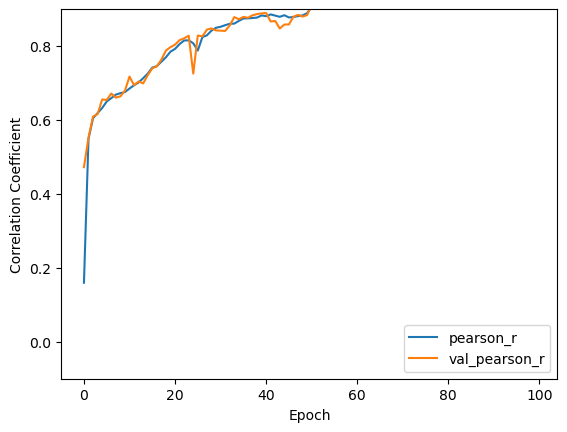

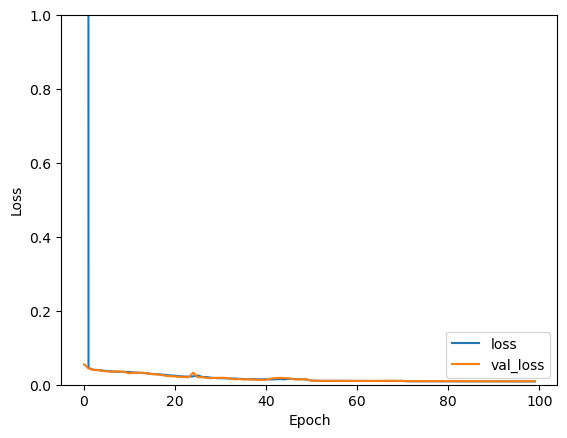

(913, 1600, 14)
29/29 [==============================] - 13s 432ms/step
(913, 5)
(913, 5)


In [5]:
# Define the GRU-based model
model = Sequential()
model.add(GRU(128, input_shape=(1600, 14), return_sequences=True))  # First GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(32, return_sequences=True))  # Second GRU layer
model.add(GRU(16, return_sequences=True))  # Second GRU layer
model.add(GRU(8, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(layers.Flatten())
model.add(Dense(64,activation='relu'))
model.add(Dense(64,activation='relu'))
model.add(Dense(32,activation='relu'))
model.add(Dense(32,activation='relu'))
model.add(Dense(5, activation='linear'))  # Assuming a regression task


# Load data and split as needed
all_inputs, test_inputs = HCM_split_data(*S2T4_EMG_SEQ_SET, *S2T5_EMG_SEQ_SET, percentage = 0.83)
all_outputs, test_outputs = HCM_split_data(*S2T4_KIN_NORM_SET, *S2T5_KIN_NORM_SET, percentage = 0.83)

X_train, X_test, y_train, y_test = train_test_split(all_inputs, all_outputs, test_size=0.3)

# Compile the model
opt = keras.optimizers.Adam(learning_rate = 0.01)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=10, min_lr=0.00000001)
callback = EarlyStopping(monitor='val_loss', patience=50)

model.compile(optimizer=opt, loss=tf.keras.losses.MeanSquaredError(), metrics=[pearson_r])

# Print the model summary
model.summary()

# Train the model
GRU_specs = model.fit(X_train, y_train, epochs=100, batch_size=32, shuffle=False, validation_data=(X_test, y_test), callbacks=[reduce_lr, callback])

# Step 4: Evaluation and Predictions
# Evaluate the model
plt.clf()
plt.plot(GRU_specs.history['pearson_r'], label='pearson_r')
plt.plot(GRU_specs.history['val_pearson_r'], label = 'val_pearson_r')
plt.xlabel('Epoch')
plt.ylabel('Correlation Coefficient')
plt.ylim([-0.1, 0.9])
plt.legend(loc='lower right')
plt.show()
plt.plot(GRU_specs.history['loss'], label='loss')
plt.plot(GRU_specs.history['val_loss'], label = 'val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.ylim([0, 1])
plt.legend(loc='lower right')
plt.show()

# Make a prediction on test data
prediction_data = X_test
print(prediction_data.shape)
prediction = model.predict(prediction_data)

# Prepare prediction data shape to compare with labels
print(prediction.shape)
print (y_test.shape)

In [12]:
# CNN Model for Proportional Control (Original unoptimized model)

# Building CNN Model
padding = 'same'

model = models.Sequential()
model.add(layers.Conv2D(128, (3, 3), activation='relu',  padding=padding, input_shape=(20, 20, 14)))
model.add(layers.Conv2D(64, (3, 3), activation='relu',  padding=padding))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.Conv2D(64, (3, 3), activation='relu',  padding=padding))
model.add(layers.Conv2D(64, (3, 3), activation='relu',  padding=padding))
model.add(layers.Conv2D(64, (3, 3), activation='relu',  padding=padding))
model.add(layers.Conv2D(64, (3, 3), activation='relu',  padding=padding))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.Conv2D(64, (3, 3), activation='relu',  padding=padding))
model.add(tf.keras.layers.BatchNormalization())

model.add(layers.Dropout(0.4))
model.add(layers.Conv2D(32, (3, 3), activation='relu', padding=padding, kernel_regularizer=l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())
model.add(layers.Conv2D(32, (3, 3), activation='relu', padding=padding, kernel_regularizer=l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())
model.add(layers.Conv2D(32, (3, 3), activation='relu', padding=padding, kernel_regularizer=l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())
model.add(layers.Conv2D(32, (3, 3), activation='relu', kernel_regularizer=l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())


model.add(layers.Dropout(0.4))
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dense(64, activation='relu'))
model.add(layers.Dropout(0.2))
model.add(layers.Dense(32, activation='relu', kernel_regularizer=l2(0.01)))
model.add(layers.Dense(5, activation='linear')) #leaky_relu

model.summary()


# Step 2: Prepare the data Training and Validation Sets

# Split the data into training and testing sets

#all_inputs = np.vstack((S2T4_EMG_3D_SET[0],S2T4_EMG_3D_SET[1],S2T4_EMG_3D_SET[2],S2T4_EMG_3D_SET[3],S2T4_EMG_3D_SET[4]))
#all_outputs = np.vstack((S2T4_KIN_NORM_SET[0],S2T4_KIN_NORM_SET[1],S2T4_KIN_NORM_SET[2],S2T4_KIN_NORM_SET[3],S2T4_KIN_NORM_SET[4]))

all_inputs, test_inputs = HCM_split_data(*S2T4_EMG_3D_SET_optimized, *S2T5_EMG_3D_SET_optimized, percentage = 0.83)
all_outputs, test_outputs = HCM_split_data(*S2T4_KIN_NORM_SET, *S2T5_KIN_NORM_SET, percentage = 0.83)

X_train, X_test, y_train, y_test = train_test_split(all_inputs, all_outputs, test_size=0.3, shuffle=True)

#X_train, X_test = HCM_split_data(*S2T4_EMG_3D_SET)        #(*S1_EMG_3D_SET, *S2_EMG_3D_SET, *S3_EMG_3D_SET
                                        # , *S4_EMG_3D_SET, percentage = 0.70)#, emg_samples2_3D)
#y_train, y_test = HCM_split_data(*S2T4_KIN_NORM_SET)        #(*S1_KIN_NORM_SET, *S2_KIN_NORM_SET
                                        # , *S3_KIN_NORM_SET, *S4_KIN_NORM_SET
                                        # , percentage = 0.70)#, kinematics_samples2[:,0])  


# Print the shapes to verify
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)
print("X_test shape:", X_test.shape)
print("y_test shape:", y_test.shape)



#Step 3: Train the model

# X_train, y_train represent your training data and labels

# Compile the model
opt = tf.keras.optimizers.Adam(learning_rate = 0.001)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=50, min_lr=0.00000001)
ES_callback = EarlyStopping(monitor='val_loss', patience=300)#200

model.compile(optimizer=opt, loss=tf.keras.losses.MeanSquaredError(), 
              metrics=[pearson_r2, tf.keras.metrics.RootMeanSquaredError()])


# Define the checkpoint filepath
checkpoint_filepath = "HCM_CNN_model_rand_big.h5"

# Define the ModelCheckpoint callback
checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,  # Filepath to save the checkpoint
    monitor='val_loss',        # Quantity to monitor for saving the model
    save_best_only=True,           # Save only the best models
    save_weights_only=False,        # Save only the model's weights
    mode='min',                    # 'max' for accuracy, 'min' for loss, etc.
    verbose=1                      # Verbosity level: 0 or 1
)



# Train the model
CNN_specs = model.fit(X_train, y_train, epochs=1000, shuffle = True, 
                              batch_size=128, validation_data=(X_test, y_test), callbacks=[reduce_lr, ES_callback, checkpoint_callback])


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_13 (Conv2D)          (None, 20, 20, 128)       16256     
                                                                 
 conv2d_14 (Conv2D)          (None, 20, 20, 64)        73792     
                                                                 
 conv2d_15 (Conv2D)          (None, 18, 18, 64)        36928     
                                                                 
 conv2d_16 (Conv2D)          (None, 18, 18, 64)        36928     
                                                                 
 conv2d_17 (Conv2D)          (None, 18, 18, 64)        36928     
                                                                 
 conv2d_18 (Conv2D)          (None, 18, 18, 64)        36928     
                                                                 
 conv2d_19 (Conv2D)          (None, 18, 18, 64)       

D:\Anaconda\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


17/17 [==============================] - ETA: 0s - loss: 1.7409 - pearson_r2: 0.1187 - root_mean_squared_error: 0.2787
Epoch 2: val_loss improved from 1.87918 to 1.74226, saving model to HCM_CNN_model_rand_big.h5
17/17 [==============================] - 4s 237ms/step - loss: 1.7409 - pearson_r2: 0.1187 - root_mean_squared_error: 0.2787 - val_loss: 1.7423 - val_pearson_r2: 0.0638 - val_root_mean_squared_error: 0.3993 - lr: 0.0010
Epoch 3/1000
17/17 [==============================] - ETA: 0s - loss: 1.5749 - pearson_r2: 0.1553 - root_mean_squared_error: 0.2535
Epoch 3: val_loss improved from 1.74226 to 1.52785, saving model to HCM_CNN_model_rand_big.h5
17/17 [==============================] - 4s 232ms/step - loss: 1.5749 - pearson_r2: 0.1553 - root_mean_squared_error: 0.2535 - val_loss: 1.5279 - val_pearson_r2: 0.1169 - val_root_mean_squared_error: 0.3203 - lr: 0.0010
Epoch 4/1000
17/17 [==============================] - ETA: 0s - loss: 1.4098 - pearson_r2: 0.1975 - root_mean_squared_err

17/17 [==============================] - 4s 244ms/step - loss: 0.1599 - pearson_r2: 0.7490 - root_mean_squared_error: 0.1263 - val_loss: 0.1896 - val_pearson_r2: 0.2262 - val_root_mean_squared_error: 0.2374 - lr: 0.0010
Epoch 21/1000
17/17 [==============================] - ETA: 0s - loss: 0.1409 - pearson_r2: 0.7523 - root_mean_squared_error: 0.1262
Epoch 21: val_loss improved from 0.18963 to 0.16940, saving model to HCM_CNN_model_rand_big.h5
17/17 [==============================] - 4s 236ms/step - loss: 0.1409 - pearson_r2: 0.7523 - root_mean_squared_error: 0.1262 - val_loss: 0.1694 - val_pearson_r2: 0.2363 - val_root_mean_squared_error: 0.2315 - lr: 0.0010
Epoch 22/1000
17/17 [==============================] - ETA: 0s - loss: 0.1244 - pearson_r2: 0.7545 - root_mean_squared_error: 0.1250
Epoch 22: val_loss improved from 0.16940 to 0.15605, saving model to HCM_CNN_model_rand_big.h5
17/17 [==============================] - 4s 233ms/step - loss: 0.1244 - pearson_r2: 0.7545 - root_mean_s

Epoch 59/1000
17/17 [==============================] - ETA: 0s - loss: 0.0137 - pearson_r2: 0.8425 - root_mean_squared_error: 0.0999
Epoch 59: val_loss improved from 0.01996 to 0.01983, saving model to HCM_CNN_model_rand_big.h5
17/17 [==============================] - 4s 228ms/step - loss: 0.0137 - pearson_r2: 0.8425 - root_mean_squared_error: 0.0999 - val_loss: 0.0198 - val_pearson_r2: 0.7925 - val_root_mean_squared_error: 0.1276 - lr: 0.0010
Epoch 60/1000
17/17 [==============================] - ETA: 0s - loss: 0.0145 - pearson_r2: 0.8318 - root_mean_squared_error: 0.1046
Epoch 60: val_loss did not improve from 0.01983
17/17 [==============================] - 4s 220ms/step - loss: 0.0145 - pearson_r2: 0.8318 - root_mean_squared_error: 0.1046 - val_loss: 0.1068 - val_pearson_r2: 0.3315 - val_root_mean_squared_error: 0.3211 - lr: 0.0010
Epoch 61/1000
17/17 [==============================] - ETA: 0s - loss: 0.0134 - pearson_r2: 0.8498 - root_mean_squared_error: 0.0985
Epoch 61: val_loss

17/17 [==============================] - ETA: 0s - loss: 0.0105 - pearson_r2: 0.8604 - root_mean_squared_error: 0.0944
Epoch 99: val_loss did not improve from 0.01221
17/17 [==============================] - 4s 220ms/step - loss: 0.0105 - pearson_r2: 0.8604 - root_mean_squared_error: 0.0944 - val_loss: 0.0268 - val_pearson_r2: 0.6471 - val_root_mean_squared_error: 0.1585 - lr: 0.0010
Epoch 100/1000
17/17 [==============================] - ETA: 0s - loss: 0.0100 - pearson_r2: 0.8703 - root_mean_squared_error: 0.0912
Epoch 100: val_loss did not improve from 0.01221
17/17 [==============================] - 4s 220ms/step - loss: 0.0100 - pearson_r2: 0.8703 - root_mean_squared_error: 0.0912 - val_loss: 0.0239 - val_pearson_r2: 0.6718 - val_root_mean_squared_error: 0.1491 - lr: 0.0010
Epoch 101/1000
17/17 [==============================] - ETA: 0s - loss: 0.0099 - pearson_r2: 0.8700 - root_mean_squared_error: 0.0914
Epoch 101: val_loss did not improve from 0.01221
17/17 [====================

17/17 [==============================] - ETA: 0s - loss: 0.0103 - pearson_r2: 0.8716 - root_mean_squared_error: 0.0905
Epoch 139: val_loss did not improve from 0.01110
17/17 [==============================] - 4s 220ms/step - loss: 0.0103 - pearson_r2: 0.8716 - root_mean_squared_error: 0.0905 - val_loss: 0.0284 - val_pearson_r2: 0.6610 - val_root_mean_squared_error: 0.1626 - lr: 0.0010
Epoch 140/1000
17/17 [==============================] - ETA: 0s - loss: 0.0103 - pearson_r2: 0.8699 - root_mean_squared_error: 0.0918
Epoch 140: val_loss did not improve from 0.01110
17/17 [==============================] - 4s 219ms/step - loss: 0.0103 - pearson_r2: 0.8699 - root_mean_squared_error: 0.0918 - val_loss: 0.0189 - val_pearson_r2: 0.7469 - val_root_mean_squared_error: 0.1312 - lr: 0.0010
Epoch 141/1000
17/17 [==============================] - ETA: 0s - loss: 0.0109 - pearson_r2: 0.8560 - root_mean_squared_error: 0.0956
Epoch 141: val_loss did not improve from 0.01110
17/17 [===================

17/17 [==============================] - 4s 220ms/step - loss: 0.0086 - pearson_r2: 0.8856 - root_mean_squared_error: 0.0859 - val_loss: 0.0173 - val_pearson_r2: 0.7998 - val_root_mean_squared_error: 0.1268 - lr: 0.0010
Epoch 160/1000
17/17 [==============================] - ETA: 0s - loss: 0.0092 - pearson_r2: 0.8764 - root_mean_squared_error: 0.0889
Epoch 160: val_loss did not improve from 0.01110
17/17 [==============================] - 4s 219ms/step - loss: 0.0092 - pearson_r2: 0.8764 - root_mean_squared_error: 0.0889 - val_loss: 0.0257 - val_pearson_r2: 0.6768 - val_root_mean_squared_error: 0.1560 - lr: 0.0010
Epoch 161/1000
17/17 [==============================] - ETA: 0s - loss: 0.0088 - pearson_r2: 0.8831 - root_mean_squared_error: 0.0857
Epoch 161: val_loss did not improve from 0.01110
17/17 [==============================] - 4s 218ms/step - loss: 0.0088 - pearson_r2: 0.8831 - root_mean_squared_error: 0.0857 - val_loss: 0.0345 - val_pearson_r2: 0.6200 - val_root_mean_squared_e

Epoch 180/1000
17/17 [==============================] - ETA: 0s - loss: 0.0076 - pearson_r2: 0.8949 - root_mean_squared_error: 0.0815
Epoch 180: val_loss did not improve from 0.01110
17/17 [==============================] - 4s 218ms/step - loss: 0.0076 - pearson_r2: 0.8949 - root_mean_squared_error: 0.0815 - val_loss: 0.0218 - val_pearson_r2: 0.7390 - val_root_mean_squared_error: 0.1445 - lr: 5.0000e-04
Epoch 181/1000
17/17 [==============================] - ETA: 0s - loss: 0.0077 - pearson_r2: 0.8928 - root_mean_squared_error: 0.0822
Epoch 181: val_loss did not improve from 0.01110
17/17 [==============================] - 4s 219ms/step - loss: 0.0077 - pearson_r2: 0.8928 - root_mean_squared_error: 0.0822 - val_loss: 0.0192 - val_pearson_r2: 0.7098 - val_root_mean_squared_error: 0.1351 - lr: 5.0000e-04
Epoch 182/1000
17/17 [==============================] - ETA: 0s - loss: 0.0075 - pearson_r2: 0.8982 - root_mean_squared_error: 0.0807
Epoch 182: val_loss did not improve from 0.01110
17/

17/17 [==============================] - ETA: 0s - loss: 0.0070 - pearson_r2: 0.9035 - root_mean_squared_error: 0.0785
Epoch 200: val_loss did not improve from 0.01015
17/17 [==============================] - 4s 218ms/step - loss: 0.0070 - pearson_r2: 0.9035 - root_mean_squared_error: 0.0785 - val_loss: 0.0132 - val_pearson_r2: 0.8201 - val_root_mean_squared_error: 0.1114 - lr: 5.0000e-04
Epoch 201/1000
17/17 [==============================] - ETA: 0s - loss: 0.0069 - pearson_r2: 0.9047 - root_mean_squared_error: 0.0778
Epoch 201: val_loss improved from 0.01015 to 0.00871, saving model to HCM_CNN_model_rand_big.h5
17/17 [==============================] - 4s 228ms/step - loss: 0.0069 - pearson_r2: 0.9047 - root_mean_squared_error: 0.0778 - val_loss: 0.0087 - val_pearson_r2: 0.8743 - val_root_mean_squared_error: 0.0886 - lr: 5.0000e-04
Epoch 202/1000
17/17 [==============================] - ETA: 0s - loss: 0.0072 - pearson_r2: 0.9020 - root_mean_squared_error: 0.0789
Epoch 202: val_loss 

17/17 [==============================] - ETA: 0s - loss: 0.0064 - pearson_r2: 0.9125 - root_mean_squared_error: 0.0751
Epoch 240: val_loss did not improve from 0.00790
17/17 [==============================] - 4s 232ms/step - loss: 0.0064 - pearson_r2: 0.9125 - root_mean_squared_error: 0.0751 - val_loss: 0.0197 - val_pearson_r2: 0.7626 - val_root_mean_squared_error: 0.1378 - lr: 5.0000e-04
Epoch 241/1000
17/17 [==============================] - ETA: 0s - loss: 0.0068 - pearson_r2: 0.9085 - root_mean_squared_error: 0.0776
Epoch 241: val_loss did not improve from 0.00790
17/17 [==============================] - 4s 221ms/step - loss: 0.0068 - pearson_r2: 0.9085 - root_mean_squared_error: 0.0776 - val_loss: 0.0103 - val_pearson_r2: 0.8553 - val_root_mean_squared_error: 0.0976 - lr: 5.0000e-04
Epoch 242/1000
17/17 [==============================] - ETA: 0s - loss: 0.0065 - pearson_r2: 0.9109 - root_mean_squared_error: 0.0754
Epoch 242: val_loss did not improve from 0.00790
17/17 [===========

17/17 [==============================] - ETA: 0s - loss: 0.0065 - pearson_r2: 0.9102 - root_mean_squared_error: 0.0757
Epoch 280: val_loss improved from 0.00773 to 0.00765, saving model to HCM_CNN_model_rand_big.h5
17/17 [==============================] - 4s 233ms/step - loss: 0.0065 - pearson_r2: 0.9102 - root_mean_squared_error: 0.0757 - val_loss: 0.0077 - val_pearson_r2: 0.8834 - val_root_mean_squared_error: 0.0827 - lr: 5.0000e-04
Epoch 281/1000
17/17 [==============================] - ETA: 0s - loss: 0.0061 - pearson_r2: 0.9167 - root_mean_squared_error: 0.0730
Epoch 281: val_loss did not improve from 0.00765
17/17 [==============================] - 4s 219ms/step - loss: 0.0061 - pearson_r2: 0.9167 - root_mean_squared_error: 0.0730 - val_loss: 0.0114 - val_pearson_r2: 0.8446 - val_root_mean_squared_error: 0.1031 - lr: 5.0000e-04
Epoch 282/1000
17/17 [==============================] - ETA: 0s - loss: 0.0060 - pearson_r2: 0.9178 - root_mean_squared_error: 0.0722
Epoch 282: val_loss 

17/17 [==============================] - ETA: 0s - loss: 0.0059 - pearson_r2: 0.9188 - root_mean_squared_error: 0.0719
Epoch 320: val_loss did not improve from 0.00765
17/17 [==============================] - 4s 219ms/step - loss: 0.0059 - pearson_r2: 0.9188 - root_mean_squared_error: 0.0719 - val_loss: 0.0116 - val_pearson_r2: 0.8349 - val_root_mean_squared_error: 0.1040 - lr: 5.0000e-04
Epoch 321/1000
17/17 [==============================] - ETA: 0s - loss: 0.0054 - pearson_r2: 0.9278 - root_mean_squared_error: 0.0680
Epoch 321: val_loss did not improve from 0.00765
17/17 [==============================] - 4s 219ms/step - loss: 0.0054 - pearson_r2: 0.9278 - root_mean_squared_error: 0.0680 - val_loss: 0.0099 - val_pearson_r2: 0.8742 - val_root_mean_squared_error: 0.0959 - lr: 2.5000e-04
Epoch 322/1000
17/17 [==============================] - ETA: 0s - loss: 0.0052 - pearson_r2: 0.9301 - root_mean_squared_error: 0.0669
Epoch 322: val_loss did not improve from 0.00765
17/17 [===========

17/17 [==============================] - ETA: 0s - loss: 0.0044 - pearson_r2: 0.9388 - root_mean_squared_error: 0.0626
Epoch 360: val_loss did not improve from 0.00666
17/17 [==============================] - 4s 219ms/step - loss: 0.0044 - pearson_r2: 0.9388 - root_mean_squared_error: 0.0626 - val_loss: 0.0115 - val_pearson_r2: 0.8603 - val_root_mean_squared_error: 0.1048 - lr: 2.5000e-04
Epoch 361/1000
17/17 [==============================] - ETA: 0s - loss: 0.0045 - pearson_r2: 0.9363 - root_mean_squared_error: 0.0638
Epoch 361: val_loss did not improve from 0.00666
17/17 [==============================] - 4s 218ms/step - loss: 0.0045 - pearson_r2: 0.9363 - root_mean_squared_error: 0.0638 - val_loss: 0.0083 - val_pearson_r2: 0.8840 - val_root_mean_squared_error: 0.0887 - lr: 2.5000e-04
Epoch 362/1000
17/17 [==============================] - ETA: 0s - loss: 0.0047 - pearson_r2: 0.9343 - root_mean_squared_error: 0.0649
Epoch 362: val_loss did not improve from 0.00666
17/17 [===========

17/17 [==============================] - ETA: 0s - loss: 0.0039 - pearson_r2: 0.9448 - root_mean_squared_error: 0.0592
Epoch 400: val_loss did not improve from 0.00666
17/17 [==============================] - 4s 230ms/step - loss: 0.0039 - pearson_r2: 0.9448 - root_mean_squared_error: 0.0592 - val_loss: 0.0088 - val_pearson_r2: 0.8901 - val_root_mean_squared_error: 0.0914 - lr: 1.2500e-04
Epoch 401/1000
17/17 [==============================] - ETA: 0s - loss: 0.0037 - pearson_r2: 0.9485 - root_mean_squared_error: 0.0573
Epoch 401: val_loss improved from 0.00666 to 0.00650, saving model to HCM_CNN_model_rand_big.h5
17/17 [==============================] - 4s 233ms/step - loss: 0.0037 - pearson_r2: 0.9485 - root_mean_squared_error: 0.0573 - val_loss: 0.0065 - val_pearson_r2: 0.9051 - val_root_mean_squared_error: 0.0781 - lr: 1.2500e-04
Epoch 402/1000
17/17 [==============================] - ETA: 0s - loss: 0.0037 - pearson_r2: 0.9480 - root_mean_squared_error: 0.0578
Epoch 402: val_loss 

17/17 [==============================] - ETA: 0s - loss: 0.0035 - pearson_r2: 0.9506 - root_mean_squared_error: 0.0562
Epoch 440: val_loss did not improve from 0.00642
17/17 [==============================] - 4s 219ms/step - loss: 0.0035 - pearson_r2: 0.9506 - root_mean_squared_error: 0.0562 - val_loss: 0.0065 - val_pearson_r2: 0.9081 - val_root_mean_squared_error: 0.0783 - lr: 1.2500e-04
Epoch 441/1000
17/17 [==============================] - ETA: 0s - loss: 0.0036 - pearson_r2: 0.9491 - root_mean_squared_error: 0.0568
Epoch 441: val_loss did not improve from 0.00642
17/17 [==============================] - 4s 219ms/step - loss: 0.0036 - pearson_r2: 0.9491 - root_mean_squared_error: 0.0568 - val_loss: 0.0076 - val_pearson_r2: 0.8993 - val_root_mean_squared_error: 0.0853 - lr: 1.2500e-04
Epoch 442/1000
17/17 [==============================] - ETA: 0s - loss: 0.0034 - pearson_r2: 0.9513 - root_mean_squared_error: 0.0555
Epoch 442: val_loss did not improve from 0.00642
17/17 [===========

17/17 [==============================] - ETA: 0s - loss: 0.0031 - pearson_r2: 0.9569 - root_mean_squared_error: 0.0522
Epoch 480: val_loss did not improve from 0.00614
17/17 [==============================] - 4s 228ms/step - loss: 0.0031 - pearson_r2: 0.9569 - root_mean_squared_error: 0.0522 - val_loss: 0.0071 - val_pearson_r2: 0.8986 - val_root_mean_squared_error: 0.0824 - lr: 1.2500e-04
Epoch 481/1000
17/17 [==============================] - ETA: 0s - loss: 0.0032 - pearson_r2: 0.9553 - root_mean_squared_error: 0.0534
Epoch 481: val_loss did not improve from 0.00614
17/17 [==============================] - 4s 227ms/step - loss: 0.0032 - pearson_r2: 0.9553 - root_mean_squared_error: 0.0534 - val_loss: 0.0077 - val_pearson_r2: 0.8974 - val_root_mean_squared_error: 0.0859 - lr: 1.2500e-04
Epoch 482/1000
17/17 [==============================] - ETA: 0s - loss: 0.0034 - pearson_r2: 0.9532 - root_mean_squared_error: 0.0552
Epoch 482: val_loss did not improve from 0.00614
17/17 [===========

17/17 [==============================] - ETA: 0s - loss: 0.0029 - pearson_r2: 0.9586 - root_mean_squared_error: 0.0513
Epoch 520: val_loss did not improve from 0.00614
17/17 [==============================] - 4s 240ms/step - loss: 0.0029 - pearson_r2: 0.9586 - root_mean_squared_error: 0.0513 - val_loss: 0.0097 - val_pearson_r2: 0.8603 - val_root_mean_squared_error: 0.0967 - lr: 6.2500e-05
Epoch 521/1000
17/17 [==============================] - ETA: 0s - loss: 0.0027 - pearson_r2: 0.9623 - root_mean_squared_error: 0.0489
Epoch 521: val_loss did not improve from 0.00614
17/17 [==============================] - 4s 237ms/step - loss: 0.0027 - pearson_r2: 0.9623 - root_mean_squared_error: 0.0489 - val_loss: 0.0063 - val_pearson_r2: 0.9091 - val_root_mean_squared_error: 0.0775 - lr: 6.2500e-05
Epoch 522/1000
17/17 [==============================] - ETA: 0s - loss: 0.0028 - pearson_r2: 0.9602 - root_mean_squared_error: 0.0502
Epoch 522: val_loss did not improve from 0.00614
17/17 [===========

17/17 [==============================] - ETA: 0s - loss: 0.0025 - pearson_r2: 0.9644 - root_mean_squared_error: 0.0475
Epoch 560: val_loss did not improve from 0.00614
17/17 [==============================] - 4s 261ms/step - loss: 0.0025 - pearson_r2: 0.9644 - root_mean_squared_error: 0.0475 - val_loss: 0.0069 - val_pearson_r2: 0.9074 - val_root_mean_squared_error: 0.0811 - lr: 3.1250e-05
Epoch 561/1000
17/17 [==============================] - ETA: 0s - loss: 0.0025 - pearson_r2: 0.9648 - root_mean_squared_error: 0.0475
Epoch 561: val_loss did not improve from 0.00614
17/17 [==============================] - 4s 251ms/step - loss: 0.0025 - pearson_r2: 0.9648 - root_mean_squared_error: 0.0475 - val_loss: 0.0067 - val_pearson_r2: 0.9051 - val_root_mean_squared_error: 0.0803 - lr: 3.1250e-05
Epoch 562/1000
17/17 [==============================] - ETA: 0s - loss: 0.0026 - pearson_r2: 0.9637 - root_mean_squared_error: 0.0480
Epoch 562: val_loss did not improve from 0.00614
17/17 [===========

17/17 [==============================] - ETA: 0s - loss: 0.0024 - pearson_r2: 0.9671 - root_mean_squared_error: 0.0458
Epoch 600: val_loss did not improve from 0.00614
17/17 [==============================] - 4s 234ms/step - loss: 0.0024 - pearson_r2: 0.9671 - root_mean_squared_error: 0.0458 - val_loss: 0.0071 - val_pearson_r2: 0.9059 - val_root_mean_squared_error: 0.0826 - lr: 1.5625e-05
Epoch 601/1000
17/17 [==============================] - ETA: 0s - loss: 0.0024 - pearson_r2: 0.9662 - root_mean_squared_error: 0.0465
Epoch 601: val_loss did not improve from 0.00614
17/17 [==============================] - 4s 240ms/step - loss: 0.0024 - pearson_r2: 0.9662 - root_mean_squared_error: 0.0465 - val_loss: 0.0065 - val_pearson_r2: 0.9096 - val_root_mean_squared_error: 0.0792 - lr: 1.5625e-05
Epoch 602/1000
17/17 [==============================] - ETA: 0s - loss: 0.0024 - pearson_r2: 0.9671 - root_mean_squared_error: 0.0456
Epoch 602: val_loss did not improve from 0.00614
17/17 [===========

17/17 [==============================] - ETA: 0s - loss: 0.0023 - pearson_r2: 0.9682 - root_mean_squared_error: 0.0448
Epoch 640: val_loss did not improve from 0.00614
17/17 [==============================] - 4s 227ms/step - loss: 0.0023 - pearson_r2: 0.9682 - root_mean_squared_error: 0.0448 - val_loss: 0.0064 - val_pearson_r2: 0.9112 - val_root_mean_squared_error: 0.0784 - lr: 1.5625e-05
Epoch 641/1000
17/17 [==============================] - ETA: 0s - loss: 0.0023 - pearson_r2: 0.9680 - root_mean_squared_error: 0.0453
Epoch 641: val_loss did not improve from 0.00614
17/17 [==============================] - 4s 223ms/step - loss: 0.0023 - pearson_r2: 0.9680 - root_mean_squared_error: 0.0453 - val_loss: 0.0071 - val_pearson_r2: 0.9047 - val_root_mean_squared_error: 0.0829 - lr: 1.5625e-05
Epoch 642/1000
17/17 [==============================] - ETA: 0s - loss: 0.0023 - pearson_r2: 0.9681 - root_mean_squared_error: 0.0449
Epoch 642: val_loss did not improve from 0.00614
17/17 [===========

17/17 [==============================] - ETA: 0s - loss: 0.0022 - pearson_r2: 0.9694 - root_mean_squared_error: 0.0440
Epoch 680: val_loss did not improve from 0.00614
17/17 [==============================] - 4s 230ms/step - loss: 0.0022 - pearson_r2: 0.9694 - root_mean_squared_error: 0.0440 - val_loss: 0.0066 - val_pearson_r2: 0.9084 - val_root_mean_squared_error: 0.0797 - lr: 7.8125e-06
Epoch 681/1000
17/17 [==============================] - ETA: 0s - loss: 0.0023 - pearson_r2: 0.9678 - root_mean_squared_error: 0.0452
Epoch 681: val_loss did not improve from 0.00614
17/17 [==============================] - 4s 229ms/step - loss: 0.0023 - pearson_r2: 0.9678 - root_mean_squared_error: 0.0452 - val_loss: 0.0067 - val_pearson_r2: 0.9095 - val_root_mean_squared_error: 0.0805 - lr: 7.8125e-06
Epoch 682/1000
17/17 [==============================] - ETA: 0s - loss: 0.0022 - pearson_r2: 0.9692 - root_mean_squared_error: 0.0442
Epoch 682: val_loss did not improve from 0.00614
17/17 [===========

17/17 [==============================] - ETA: 0s - loss: 0.0023 - pearson_r2: 0.9687 - root_mean_squared_error: 0.0447
Epoch 720: val_loss did not improve from 0.00614
17/17 [==============================] - 4s 231ms/step - loss: 0.0023 - pearson_r2: 0.9687 - root_mean_squared_error: 0.0447 - val_loss: 0.0065 - val_pearson_r2: 0.9100 - val_root_mean_squared_error: 0.0792 - lr: 3.9063e-06
Epoch 721/1000
17/17 [==============================] - ETA: 0s - loss: 0.0022 - pearson_r2: 0.9693 - root_mean_squared_error: 0.0442
Epoch 721: val_loss did not improve from 0.00614
17/17 [==============================] - 4s 233ms/step - loss: 0.0022 - pearson_r2: 0.9693 - root_mean_squared_error: 0.0442 - val_loss: 0.0066 - val_pearson_r2: 0.9090 - val_root_mean_squared_error: 0.0798 - lr: 3.9063e-06
Epoch 722/1000
17/17 [==============================] - ETA: 0s - loss: 0.0021 - pearson_r2: 0.9699 - root_mean_squared_error: 0.0434
Epoch 722: val_loss did not improve from 0.00614
17/17 [===========

In [35]:
# CNN Model for Proportional Control

# Step 1: Build the model
ACC_DATA = False # Add this if model input is optimized
if (ACC_DATA == True):
    input_shape=(40, 40, 14)
    padding = "valid"
else:
    input_shape=(20, 20, 14)
    padding = "same"
    
filters_num =  8

# Building CNN Model
model = tf.keras.models.Sequential()#models.Sequential()
model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu',padding=padding, input_shape=input_shape))
model.add(tf.keras.layers.Conv2D((filters_num), (3, 3), activation='relu', padding=padding))
model.add(tf.keras.layers.Conv2D((filters_num), (3, 3), activation='relu'))
model.add(tf.keras.layers.Conv2D((filters_num), (3, 3), activation='relu', padding=padding))
model.add(tf.keras.layers.Conv2D((filters_num), (3, 3), activation='relu', padding=padding))
model.add(tf.keras.layers.Conv2D((filters_num/2), (3, 3), activation='relu', padding=padding))
model.add(tf.keras.layers.Conv2D((filters_num/2), (3, 3), activation='relu', padding=padding))
model.add(tf.keras.layers.Conv2D((filters_num/2), (3, 3), activation='relu'))
model.add(tf.keras.layers.Conv2D((filters_num/2), (3, 3), activation='relu', padding=padding))
model.add(tf.keras.layers.BatchNormalization())

model.add(tf.keras.layers.Dropout(0.4))
model.add(tf.keras.layers.Conv2D((filters_num/4), (3, 3), activation='relu', padding=padding, kernel_regularizer=l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Conv2D((filters_num/4), (3, 3), activation='relu', padding=padding, kernel_regularizer=l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Conv2D((filters_num/4), (3, 3), activation='relu', padding=padding, kernel_regularizer=l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Conv2D((filters_num/4), (3, 3), activation='relu', kernel_regularizer=l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())


model.add(tf.keras.layers.Dropout(0.4))
model.add(tf.keras.layers.Flatten())
model.add(tf.keras.layers.Dense(128, activation='relu'))
model.add(tf.keras.layers.Dense(64, activation='relu'))
model.add(tf.keras.layers.Dropout(0.2))
model.add(tf.keras.layers.Dense(32, activation='relu', kernel_regularizer=l2(0.01)))
model.add(tf.keras.layers.Dense(5, activation='linear')) #leaky_relu

model.summary()


# Step 2: Prepare the data Training and Validation Sets

# Split the data into training and testing sets

#all_inputs = np.vstack((S2T4_EMG_3D_SET[0],S2T4_EMG_3D_SET[1],S2T4_EMG_3D_SET[2],S2T4_EMG_3D_SET[3],S2T4_EMG_3D_SET[4]))
#all_outputs = np.vstack((S2T4_KIN_NORM_SET[0],S2T4_KIN_NORM_SET[1],S2T4_KIN_NORM_SET[2],S2T4_KIN_NORM_SET[3],S2T4_KIN_NORM_SET[4]))

all_inputs, test_inputs = HCM_split_data(*S2T4_EMG_3D_SET_optimized, *S2T5_EMG_3D_SET_optimized, percentage = 0.83)
all_outputs, test_outputs = HCM_split_data(*S2T4_KIN_NORM_SET, *S2T5_KIN_NORM_SET, percentage = 0.83)

X_train, X_test, y_train, y_test = train_test_split(all_inputs, all_outputs, test_size=0.3, shuffle=True)

#X_train, X_test = HCM_split_data(*S2T4_EMG_3D_SET)        #(*S1_EMG_3D_SET, *S2_EMG_3D_SET, *S3_EMG_3D_SET
                                        # , *S4_EMG_3D_SET, percentage = 0.70)#, emg_samples2_3D)
#y_train, y_test = HCM_split_data(*S2T4_KIN_NORM_SET)        #(*S1_KIN_NORM_SET, *S2_KIN_NORM_SET
                                        # , *S3_KIN_NORM_SET, *S4_KIN_NORM_SET
                                        # , percentage = 0.70)#, kinematics_samples2[:,0])  


# Print the shapes to verify
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)
print("X_test shape:", X_test.shape)
print("y_test shape:", y_test.shape)



#Step 3: Train the model

# X_train, y_train represent your training data and labels

# Compile the model
opt = tf.keras.optimizers.Adam(learning_rate = 0.001)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=50, min_lr=0.00000001)
ES_callback = EarlyStopping(monitor='val_loss', patience=100)#200

model.compile(optimizer=opt, loss=tf.keras.losses.MeanSquaredError(), 
              metrics=[pearson_r2, tf.keras.metrics.RootMeanSquaredError()])


# Define the checkpoint filepath
checkpoint_filepath = "HCM_CNN_model_rand.h5"

# Define the ModelCheckpoint callback
checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,  # Filepath to save the checkpoint
    monitor='val_loss',        # Quantity to monitor for saving the model
    save_best_only=True,           # Save only the best models
    save_weights_only=False,        # Save only the model's weights
    mode='min',                    # 'max' for accuracy, 'min' for loss, etc.
    verbose=1                      # Verbosity level: 0 or 1
)



# Train the model
CNN_specs = model.fit(X_train, y_train, epochs=1000, shuffle = True, 
                              batch_size=128, validation_data=(X_test, y_test), callbacks=[reduce_lr, ES_callback, checkpoint_callback])


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_13 (Conv2D)          (None, 20, 20, 64)        8128      
                                                                 
 conv2d_14 (Conv2D)          (None, 20, 20, 8)         4616      
                                                                 
 conv2d_15 (Conv2D)          (None, 18, 18, 8)         584       
                                                                 
 conv2d_16 (Conv2D)          (None, 18, 18, 8)         584       
                                                                 
 conv2d_17 (Conv2D)          (None, 18, 18, 8)         584       
                                                                 
 conv2d_18 (Conv2D)          (None, 18, 18, 4)         292       
                                                                 
 conv2d_19 (Conv2D)          (None, 18, 18, 4)        

D:\Anaconda\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


15/17 [=========================>....] - ETA: 0s - loss: 0.6096 - pearson_r2: 0.0283 - root_mean_squared_error: 0.3655
Epoch 2: val_loss improved from 0.65959 to 0.61633, saving model to HCM_CNN_model_rand.h5
17/17 [==============================] - 1s 41ms/step - loss: 0.6055 - pearson_r2: 0.0287 - root_mean_squared_error: 0.3625 - val_loss: 0.6163 - val_pearson_r2: 0.0473 - val_root_mean_squared_error: 0.4032 - lr: 0.0010
Epoch 3/1000
17/17 [==============================] - ETA: 0s - loss: 0.5281 - pearson_r2: 0.0563 - root_mean_squared_error: 0.3030
Epoch 3: val_loss improved from 0.61633 to 0.56545, saving model to HCM_CNN_model_rand.h5
17/17 [==============================] - 1s 38ms/step - loss: 0.5281 - pearson_r2: 0.0563 - root_mean_squared_error: 0.3030 - val_loss: 0.5655 - val_pearson_r2: 0.1666 - val_root_mean_squared_error: 0.3865 - lr: 0.0010
Epoch 4/1000
16/17 [===========================>..] - ETA: 0s - loss: 0.4770 - pearson_r2: 0.0635 - root_mean_squared_error: 0.2774

Epoch 21/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.1328 - pearson_r2: 0.3911 - root_mean_squared_error: 0.1955
Epoch 21: val_loss improved from 0.15468 to 0.14551, saving model to HCM_CNN_model_rand.h5
17/17 [==============================] - 1s 37ms/step - loss: 0.1325 - pearson_r2: 0.3898 - root_mean_squared_error: 0.1957 - val_loss: 0.1455 - val_pearson_r2: 0.1973 - val_root_mean_squared_error: 0.2344 - lr: 0.0010
Epoch 22/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.1249 - pearson_r2: 0.4169 - root_mean_squared_error: 0.1921
Epoch 22: val_loss improved from 0.14551 to 0.13764, saving model to HCM_CNN_model_rand.h5
17/17 [==============================] - 1s 37ms/step - loss: 0.1246 - pearson_r2: 0.4127 - root_mean_squared_error: 0.1922 - val_loss: 0.1376 - val_pearson_r2: 0.2027 - val_root_mean_squared_error: 0.2309 - lr: 0.0010
Epoch 23/1000
16/17 [===========================>..] - ETA: 0s - loss: 0.1193 - pearson_r2: 0.4055 - root_mean_squ

Epoch 40/1000
17/17 [==============================] - ETA: 0s - loss: 0.0539 - pearson_r2: 0.5728 - root_mean_squared_error: 0.1638
Epoch 40: val_loss did not improve from 0.06582
17/17 [==============================] - 0s 28ms/step - loss: 0.0539 - pearson_r2: 0.5728 - root_mean_squared_error: 0.1638 - val_loss: 0.0936 - val_pearson_r2: 0.0477 - val_root_mean_squared_error: 0.2595 - lr: 0.0010
Epoch 41/1000
16/17 [===========================>..] - ETA: 0s - loss: 0.0504 - pearson_r2: 0.6047 - root_mean_squared_error: 0.1575
Epoch 41: val_loss did not improve from 0.06582
17/17 [==============================] - 0s 30ms/step - loss: 0.0504 - pearson_r2: 0.6074 - root_mean_squared_error: 0.1576 - val_loss: 0.0667 - val_pearson_r2: 0.3503 - val_root_mean_squared_error: 0.2051 - lr: 0.0010
Epoch 42/1000
17/17 [==============================] - ETA: 0s - loss: 0.0503 - pearson_r2: 0.5846 - root_mean_squared_error: 0.1622
Epoch 42: val_loss improved from 0.06582 to 0.05069, saving model t

Epoch 60/1000
16/17 [===========================>..] - ETA: 0s - loss: 0.0258 - pearson_r2: 0.7258 - root_mean_squared_error: 0.1319
Epoch 60: val_loss improved from 0.03373 to 0.03101, saving model to HCM_CNN_model_rand.h5
17/17 [==============================] - 1s 37ms/step - loss: 0.0257 - pearson_r2: 0.7265 - root_mean_squared_error: 0.1316 - val_loss: 0.0310 - val_pearson_r2: 0.6903 - val_root_mean_squared_error: 0.1513 - lr: 0.0010
Epoch 61/1000
16/17 [===========================>..] - ETA: 0s - loss: 0.0246 - pearson_r2: 0.7359 - root_mean_squared_error: 0.1290
Epoch 61: val_loss did not improve from 0.03101
17/17 [==============================] - 0s 29ms/step - loss: 0.0245 - pearson_r2: 0.7372 - root_mean_squared_error: 0.1287 - val_loss: 0.0533 - val_pearson_r2: 0.3537 - val_root_mean_squared_error: 0.2137 - lr: 0.0010
Epoch 62/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0237 - pearson_r2: 0.7428 - root_mean_squared_error: 0.1272
Epoch 62: val_loss impro

Epoch 80/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0180 - pearson_r2: 0.7623 - root_mean_squared_error: 0.1222
Epoch 80: val_loss did not improve from 0.02080
17/17 [==============================] - 1s 32ms/step - loss: 0.0179 - pearson_r2: 0.7666 - root_mean_squared_error: 0.1218 - val_loss: 0.0272 - val_pearson_r2: 0.6309 - val_root_mean_squared_error: 0.1553 - lr: 0.0010
Epoch 81/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0156 - pearson_r2: 0.8010 - root_mean_squared_error: 0.1121
Epoch 81: val_loss improved from 0.02080 to 0.01870, saving model to HCM_CNN_model_rand.h5
17/17 [==============================] - 1s 39ms/step - loss: 0.0156 - pearson_r2: 0.8018 - root_mean_squared_error: 0.1124 - val_loss: 0.0187 - val_pearson_r2: 0.7723 - val_root_mean_squared_error: 0.1254 - lr: 0.0010
Epoch 82/1000
16/17 [===========================>..] - ETA: 0s - loss: 0.0158 - pearson_r2: 0.7982 - root_mean_squared_error: 0.1136
Epoch 82: val_loss did n

17/17 [==============================] - ETA: 0s - loss: 0.0104 - pearson_r2: 0.8530 - root_mean_squared_error: 0.0967
Epoch 120: val_loss did not improve from 0.01090
17/17 [==============================] - 0s 29ms/step - loss: 0.0104 - pearson_r2: 0.8530 - root_mean_squared_error: 0.0967 - val_loss: 0.0111 - val_pearson_r2: 0.8417 - val_root_mean_squared_error: 0.0999 - lr: 0.0010
Epoch 121/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0101 - pearson_r2: 0.8568 - root_mean_squared_error: 0.0948
Epoch 121: val_loss did not improve from 0.01090
17/17 [==============================] - 0s 29ms/step - loss: 0.0100 - pearson_r2: 0.8580 - root_mean_squared_error: 0.0946 - val_loss: 0.0147 - val_pearson_r2: 0.8210 - val_root_mean_squared_error: 0.1171 - lr: 0.0010
Epoch 122/1000
16/17 [===========================>..] - ETA: 0s - loss: 0.0103 - pearson_r2: 0.8549 - root_mean_squared_error: 0.0962
Epoch 122: val_loss improved from 0.01090 to 0.01080, saving model to HCM_CNN

Epoch 160/1000
16/17 [===========================>..] - ETA: 0s - loss: 0.0089 - pearson_r2: 0.8744 - root_mean_squared_error: 0.0900
Epoch 160: val_loss did not improve from 0.00933
17/17 [==============================] - 1s 30ms/step - loss: 0.0088 - pearson_r2: 0.8748 - root_mean_squared_error: 0.0897 - val_loss: 0.0149 - val_pearson_r2: 0.8007 - val_root_mean_squared_error: 0.1189 - lr: 0.0010
Epoch 161/1000
17/17 [==============================] - ETA: 0s - loss: 0.0090 - pearson_r2: 0.8710 - root_mean_squared_error: 0.0909
Epoch 161: val_loss did not improve from 0.00933
17/17 [==============================] - 1s 30ms/step - loss: 0.0090 - pearson_r2: 0.8710 - root_mean_squared_error: 0.0909 - val_loss: 0.0116 - val_pearson_r2: 0.8472 - val_root_mean_squared_error: 0.1043 - lr: 0.0010
Epoch 162/1000
17/17 [==============================] - ETA: 0s - loss: 0.0085 - pearson_r2: 0.8777 - root_mean_squared_error: 0.0880
Epoch 162: val_loss did not improve from 0.00933
17/17 [======

17/17 [==============================] - 0s 28ms/step - loss: 0.0086 - pearson_r2: 0.8765 - root_mean_squared_error: 0.0889 - val_loss: 0.0107 - val_pearson_r2: 0.8433 - val_root_mean_squared_error: 0.0999 - lr: 0.0010
Epoch 181/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0086 - pearson_r2: 0.8761 - root_mean_squared_error: 0.0890
Epoch 181: val_loss did not improve from 0.00933
17/17 [==============================] - 0s 29ms/step - loss: 0.0087 - pearson_r2: 0.8765 - root_mean_squared_error: 0.0893 - val_loss: 0.0132 - val_pearson_r2: 0.8264 - val_root_mean_squared_error: 0.1120 - lr: 0.0010
Epoch 182/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0084 - pearson_r2: 0.8778 - root_mean_squared_error: 0.0878
Epoch 182: val_loss did not improve from 0.00933
17/17 [==============================] - 1s 30ms/step - loss: 0.0083 - pearson_r2: 0.8792 - root_mean_squared_error: 0.0874 - val_loss: 0.0104 - val_pearson_r2: 0.8353 - val_root_mean_squared_erro

Epoch 201/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0072 - pearson_r2: 0.8966 - root_mean_squared_error: 0.0807
Epoch 201: val_loss did not improve from 0.00922
17/17 [==============================] - 1s 31ms/step - loss: 0.0072 - pearson_r2: 0.8964 - root_mean_squared_error: 0.0810 - val_loss: 0.0180 - val_pearson_r2: 0.7362 - val_root_mean_squared_error: 0.1318 - lr: 0.0010
Epoch 202/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0077 - pearson_r2: 0.8893 - root_mean_squared_error: 0.0841
Epoch 202: val_loss did not improve from 0.00922
17/17 [==============================] - 1s 32ms/step - loss: 0.0077 - pearson_r2: 0.8905 - root_mean_squared_error: 0.0838 - val_loss: 0.0097 - val_pearson_r2: 0.8555 - val_root_mean_squared_error: 0.0954 - lr: 0.0010
Epoch 203/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0077 - pearson_r2: 0.8883 - root_mean_squared_error: 0.0841
Epoch 203: val_loss did not improve from 0.00922
17/17 [======

16/17 [===========================>..] - ETA: 0s - loss: 0.0069 - pearson_r2: 0.9018 - root_mean_squared_error: 0.0792
Epoch 241: val_loss did not improve from 0.00883
17/17 [==============================] - 0s 29ms/step - loss: 0.0069 - pearson_r2: 0.9005 - root_mean_squared_error: 0.0796 - val_loss: 0.0089 - val_pearson_r2: 0.8618 - val_root_mean_squared_error: 0.0909 - lr: 0.0010
Epoch 242/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0068 - pearson_r2: 0.9025 - root_mean_squared_error: 0.0786
Epoch 242: val_loss did not improve from 0.00883
17/17 [==============================] - 0s 29ms/step - loss: 0.0068 - pearson_r2: 0.9034 - root_mean_squared_error: 0.0785 - val_loss: 0.0106 - val_pearson_r2: 0.8482 - val_root_mean_squared_error: 0.1001 - lr: 0.0010
Epoch 243/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0068 - pearson_r2: 0.9022 - root_mean_squared_error: 0.0789
Epoch 243: val_loss did not improve from 0.00883
17/17 [=====================

17/17 [==============================] - 1s 29ms/step - loss: 0.0070 - pearson_r2: 0.8999 - root_mean_squared_error: 0.0802 - val_loss: 0.0099 - val_pearson_r2: 0.8437 - val_root_mean_squared_error: 0.0963 - lr: 0.0010
Epoch 282/1000
16/17 [===========================>..] - ETA: 0s - loss: 0.0063 - pearson_r2: 0.9081 - root_mean_squared_error: 0.0759
Epoch 282: val_loss did not improve from 0.00869
17/17 [==============================] - 1s 30ms/step - loss: 0.0063 - pearson_r2: 0.9087 - root_mean_squared_error: 0.0758 - val_loss: 0.0095 - val_pearson_r2: 0.8660 - val_root_mean_squared_error: 0.0946 - lr: 0.0010
Epoch 283/1000
17/17 [==============================] - ETA: 0s - loss: 0.0064 - pearson_r2: 0.9071 - root_mean_squared_error: 0.0763
Epoch 283: val_loss did not improve from 0.00869
17/17 [==============================] - 0s 29ms/step - loss: 0.0064 - pearson_r2: 0.9071 - root_mean_squared_error: 0.0763 - val_loss: 0.0091 - val_pearson_r2: 0.8658 - val_root_mean_squared_erro

Epoch 302/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0054 - pearson_r2: 0.9227 - root_mean_squared_error: 0.0701
Epoch 302: val_loss improved from 0.00869 to 0.00855, saving model to HCM_CNN_model_rand.h5
17/17 [==============================] - 1s 37ms/step - loss: 0.0054 - pearson_r2: 0.9224 - root_mean_squared_error: 0.0702 - val_loss: 0.0085 - val_pearson_r2: 0.8702 - val_root_mean_squared_error: 0.0896 - lr: 5.0000e-04
Epoch 303/1000
16/17 [===========================>..] - ETA: 0s - loss: 0.0053 - pearson_r2: 0.9233 - root_mean_squared_error: 0.0692
Epoch 303: val_loss did not improve from 0.00855
17/17 [==============================] - 0s 29ms/step - loss: 0.0053 - pearson_r2: 0.9236 - root_mean_squared_error: 0.0693 - val_loss: 0.0087 - val_pearson_r2: 0.8709 - val_root_mean_squared_error: 0.0903 - lr: 5.0000e-04
Epoch 304/1000
16/17 [===========================>..] - ETA: 0s - loss: 0.0053 - pearson_r2: 0.9246 - root_mean_squared_error: 0.0690
Epoch 304: 

Epoch 322/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0055 - pearson_r2: 0.9207 - root_mean_squared_error: 0.0708
Epoch 322: val_loss did not improve from 0.00812
17/17 [==============================] - 0s 29ms/step - loss: 0.0055 - pearson_r2: 0.9215 - root_mean_squared_error: 0.0707 - val_loss: 0.0092 - val_pearson_r2: 0.8616 - val_root_mean_squared_error: 0.0937 - lr: 5.0000e-04
Epoch 323/1000
17/17 [==============================] - ETA: 0s - loss: 0.0053 - pearson_r2: 0.9237 - root_mean_squared_error: 0.0693
Epoch 323: val_loss did not improve from 0.00812
17/17 [==============================] - 0s 28ms/step - loss: 0.0053 - pearson_r2: 0.9237 - root_mean_squared_error: 0.0693 - val_loss: 0.0110 - val_pearson_r2: 0.8354 - val_root_mean_squared_error: 0.1025 - lr: 5.0000e-04
Epoch 324/1000
17/17 [==============================] - ETA: 0s - loss: 0.0049 - pearson_r2: 0.9285 - root_mean_squared_error: 0.0668
Epoch 324: val_loss did not improve from 0.00812
17/17

15/17 [=========================>....] - ETA: 0s - loss: 0.0047 - pearson_r2: 0.9324 - root_mean_squared_error: 0.0660
Epoch 362: val_loss did not improve from 0.00812
17/17 [==============================] - 1s 31ms/step - loss: 0.0047 - pearson_r2: 0.9322 - root_mean_squared_error: 0.0657 - val_loss: 0.0083 - val_pearson_r2: 0.8716 - val_root_mean_squared_error: 0.0889 - lr: 2.5000e-04
Epoch 363/1000
17/17 [==============================] - ETA: 0s - loss: 0.0046 - pearson_r2: 0.9334 - root_mean_squared_error: 0.0649
Epoch 363: val_loss improved from 0.00812 to 0.00805, saving model to HCM_CNN_model_rand.h5
17/17 [==============================] - 1s 39ms/step - loss: 0.0046 - pearson_r2: 0.9334 - root_mean_squared_error: 0.0649 - val_loss: 0.0080 - val_pearson_r2: 0.8724 - val_root_mean_squared_error: 0.0875 - lr: 2.5000e-04
Epoch 364/1000
17/17 [==============================] - ETA: 0s - loss: 0.0047 - pearson_r2: 0.9315 - root_mean_squared_error: 0.0659
Epoch 364: val_loss did no

15/17 [=========================>....] - ETA: 0s - loss: 0.0044 - pearson_r2: 0.9362 - root_mean_squared_error: 0.0636
Epoch 402: val_loss did not improve from 0.00805
17/17 [==============================] - 1s 32ms/step - loss: 0.0044 - pearson_r2: 0.9356 - root_mean_squared_error: 0.0638 - val_loss: 0.0084 - val_pearson_r2: 0.8738 - val_root_mean_squared_error: 0.0898 - lr: 2.5000e-04
Epoch 403/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0044 - pearson_r2: 0.9364 - root_mean_squared_error: 0.0634
Epoch 403: val_loss did not improve from 0.00805
17/17 [==============================] - 1s 31ms/step - loss: 0.0044 - pearson_r2: 0.9361 - root_mean_squared_error: 0.0638 - val_loss: 0.0081 - val_pearson_r2: 0.8724 - val_root_mean_squared_error: 0.0882 - lr: 2.5000e-04
Epoch 404/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0045 - pearson_r2: 0.9352 - root_mean_squared_error: 0.0646
Epoch 404: val_loss did not improve from 0.00805
17/17 [=============

17/17 [==============================] - ETA: 0s - loss: 0.0042 - pearson_r2: 0.9383 - root_mean_squared_error: 0.0624
Epoch 442: val_loss did not improve from 0.00799
17/17 [==============================] - 0s 28ms/step - loss: 0.0042 - pearson_r2: 0.9383 - root_mean_squared_error: 0.0624 - val_loss: 0.0083 - val_pearson_r2: 0.8709 - val_root_mean_squared_error: 0.0895 - lr: 1.2500e-04
Epoch 443/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0042 - pearson_r2: 0.9388 - root_mean_squared_error: 0.0619
Epoch 443: val_loss did not improve from 0.00799
17/17 [==============================] - 1s 29ms/step - loss: 0.0042 - pearson_r2: 0.9383 - root_mean_squared_error: 0.0623 - val_loss: 0.0084 - val_pearson_r2: 0.8687 - val_root_mean_squared_error: 0.0896 - lr: 1.2500e-04
Epoch 444/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0042 - pearson_r2: 0.9393 - root_mean_squared_error: 0.0618
Epoch 444: val_loss did not improve from 0.00799
17/17 [=============

17/17 [==============================] - ETA: 0s - loss: 0.0040 - pearson_r2: 0.9426 - root_mean_squared_error: 0.0603
Epoch 482: val_loss did not improve from 0.00799
17/17 [==============================] - 0s 28ms/step - loss: 0.0040 - pearson_r2: 0.9426 - root_mean_squared_error: 0.0603 - val_loss: 0.0087 - val_pearson_r2: 0.8675 - val_root_mean_squared_error: 0.0918 - lr: 6.2500e-05
Epoch 483/1000
16/17 [===========================>..] - ETA: 0s - loss: 0.0041 - pearson_r2: 0.9395 - root_mean_squared_error: 0.0618
Epoch 483: val_loss did not improve from 0.00799
17/17 [==============================] - 0s 28ms/step - loss: 0.0041 - pearson_r2: 0.9396 - root_mean_squared_error: 0.0618 - val_loss: 0.0088 - val_pearson_r2: 0.8678 - val_root_mean_squared_error: 0.0920 - lr: 6.2500e-05
Epoch 484/1000
15/17 [=========================>....] - ETA: 0s - loss: 0.0041 - pearson_r2: 0.9400 - root_mean_squared_error: 0.0618
Epoch 484: val_loss did not improve from 0.00799
17/17 [=============

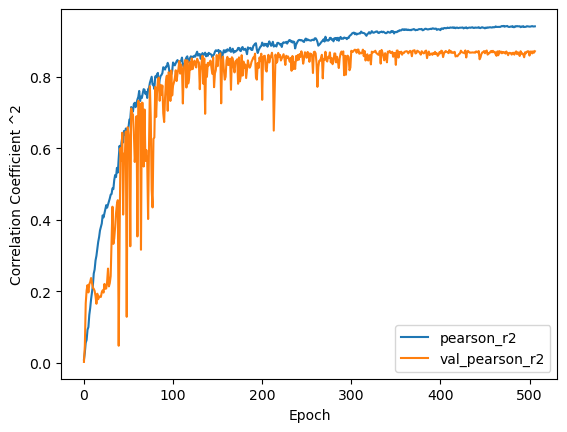

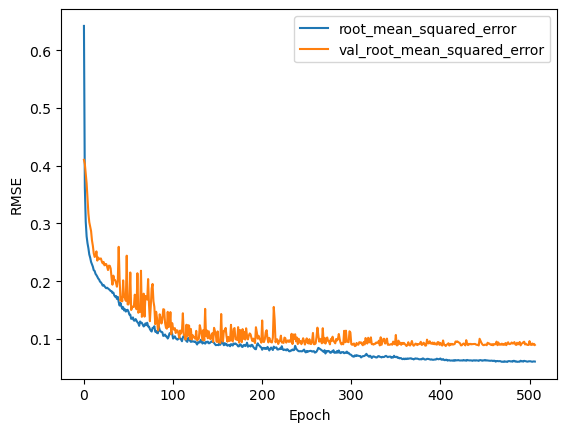

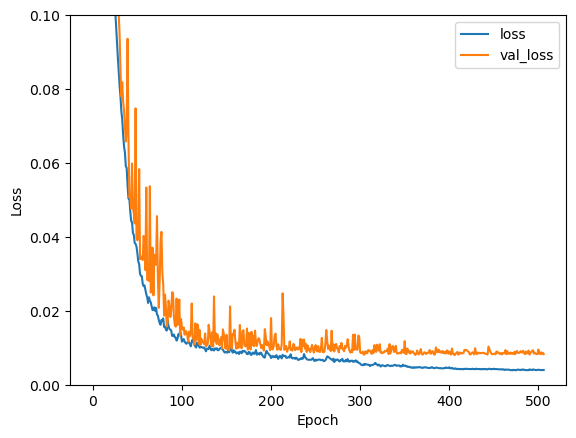

(913, 20, 20, 14)
67/67 [==============================] - 0s 4ms/step
(913, 5)
(913, 5)
[ 1.  9.  6. 10. 32. 12. 21.  6.  4.  9.  8. 14. 35. 13. 11.  5. 22.  0.
 13. 10. 18. 12. 23.  6.  1. 16. 10. 11.  1.  1. 18. 22. 30. 23.  0.  0.
  2.  4.  3. 12.  1.  2.  8.  8. 17.  0. 12. 16. 29. 18. 21.  2.  6. 15.
  6. 15.]


In [36]:
# Step 4: Evaluation and Predictions
# Evaluate the model
plt.clf()
plt.plot(CNN_specs.history['pearson_r2'], label='pearson_r2')
plt.plot(CNN_specs.history['val_pearson_r2'], label = 'val_pearson_r2')
plt.xlabel('Epoch')
plt.ylabel('Correlation Coefficient ^2')
plt.legend(loc='lower right')
plt.show()
plt.plot(CNN_specs.history['root_mean_squared_error'], label='root_mean_squared_error')
plt.plot(CNN_specs.history['val_root_mean_squared_error'], label = 'val_root_mean_squared_error')
plt.xlabel('Epoch')
plt.ylabel('RMSE')
#plt.ylim([-0.1, 0.95])

plt.legend(loc='upper right')
plt.show()
plt.plot(CNN_specs.history['loss'], label='loss')
plt.plot(CNN_specs.history['val_loss'], label = 'val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.ylim([0, 0.1])
plt.legend(loc='upper right')
plt.show()

#model = model_for_export
# Make a prediction on test data
prediction_data = X_test
print(prediction_data.shape)
prediction = model.predict(prediction_data)
prediction_of_training = model.predict(X_train)
# Prepare prediction data shape to compare with labels
print(prediction.shape)
print (y_test.shape)

print(opt_arr_all)

Ground Truth for sample:  0 is  [0.23694118 0.2286592  0.36920454 0.23924757 0.73995999]
Prediction   for sample:  0 is  [0.21408936 0.20395511 0.32603818 0.26487708 0.7664989 ]


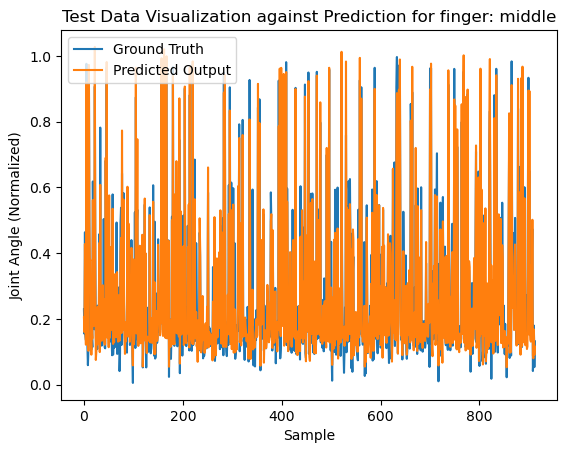

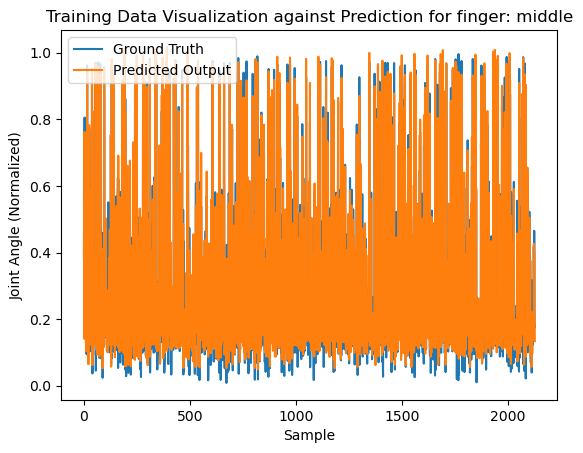

In [26]:
prediction_sample = 0
finger_to_plot = 1
print ("Ground Truth for sample: ", prediction_sample, "is ", y_test[prediction_sample])
print ("Prediction   for sample: ", prediction_sample, "is ",prediction[prediction_sample])

if (finger_to_plot == 0):
    finger = 'index'
elif (finger_to_plot == 1):
    finger = 'middle'
elif (finger_to_plot == 2):
    finger = 'ring'
elif (finger_to_plot == 3):
    finger = 'pinky'
elif (finger_to_plot == 4):
    finger = 'thumb'


    
plt.figure()
plt.plot(y_test[:,finger_to_plot])
plt.plot(prediction[:,finger_to_plot])
plt.title("Test Data Visualization against Prediction for finger: "+finger)
plt.xlabel('Sample')
plt.ylabel('Joint Angle (Normalized)')
plt.legend(labels= ['Ground Truth', 'Predicted Output'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_train[:,finger_to_plot])
plt.plot(prediction_of_training[:,finger_to_plot])
plt.title("Training Data Visualization against Prediction for finger: "+finger)
plt.xlabel('Sample')
plt.ylabel('Joint Angle (Normalized)')
plt.legend(labels= ['Ground Truth', 'Predicted Output'], loc='upper left')
plt.show()

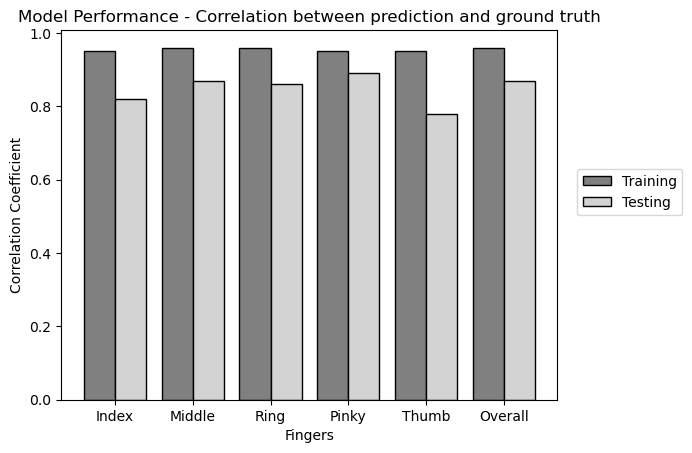

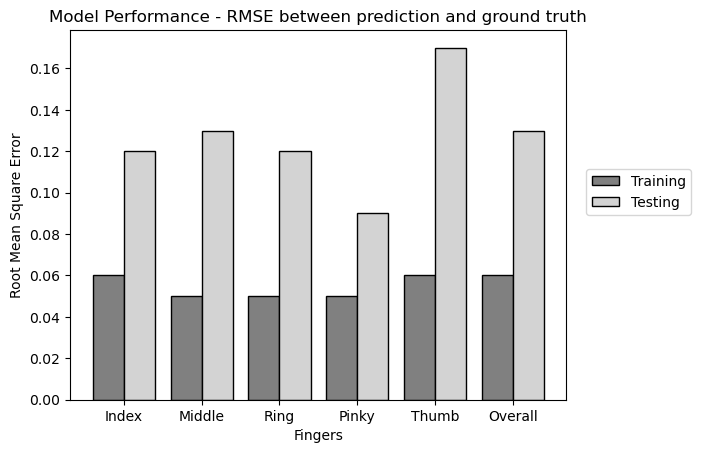

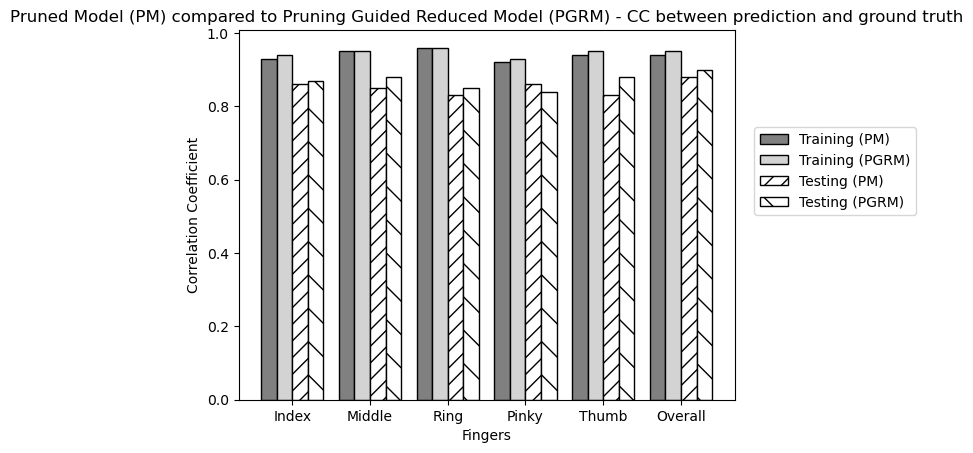

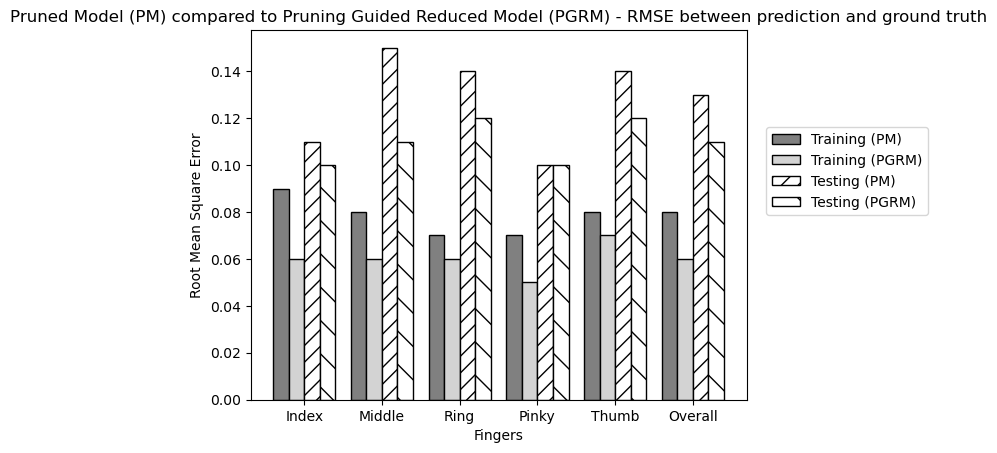

In [12]:
# Bar Graph of Model Performance in Training and Testing

# list the degrees of freedom analyized
X = ['Index','Middle','Ring','Pinky', 'Thumb', 'Overall'] 
train_r2 = [0.95, 0.96,0.96,0.95,0.95,0.96] 
test_r2 =  [0.82, 0.87,0.86,0.89,0.78,0.87] 

train_rmse = [0.06, 0.05,0.05,0.05,0.06,0.06] 
test_rmse =  [0.12, 0.13,0.12,0.09,0.17,0.13] 
  
X_axis = np.arange(len(X)) 
  

# Plot Correlation Coefficients of main developed model
plt.bar(X_axis - 0.2, train_r2, 0.4, color = 'grey', edgecolor = 'black', label = 'Training') 
plt.bar(X_axis + 0.2, test_r2, 0.4,  color = 'lightgrey', edgecolor = 'black',label = 'Testing') 
  
plt.xticks(X_axis, X) 
plt.xlabel("Fingers") 
plt.ylabel("Correlation Coefficient") 
plt.title("Model Performance - Correlation between prediction and ground truth") 
plt.legend(loc=(1.04, 0.5)) 
plt.show() 


# Plot RMSE of main developed model
plt.bar(X_axis - 0.2, train_rmse, 0.4, color = 'grey', edgecolor = 'black', label = 'Training') 
plt.bar(X_axis + 0.2, test_rmse, 0.4,  color = 'lightgrey', edgecolor = 'black',label = 'Testing') 
  
plt.xticks(X_axis, X) 
plt.xlabel("Fingers") 
plt.ylabel("Root Mean Square Error") 
plt.title("Model Performance - RMSE between prediction and ground truth") 
plt.legend(loc=(1.04, 0.5)) 
plt.show() 

# Get data of pruned and pruning guided reduced model for comparison
train_r2_p =     [0.93, 0.95,0.96,0.92,0.94,0.94] 
test_r2_p =      [0.86, 0.85,0.83,0.86,0.83,0.88] 
  
train_r2_pgr =   [0.94, 0.95,0.96,0.93,0.95,0.95] 
test_r2_pgr =    [0.87, 0.88,0.85,0.84,0.88,0.90]
  
train_rmse_p =   [0.09, 0.08,0.07,0.07,0.08,0.08] 
test_rmse_p =    [0.11, 0.15,0.14,0.10,0.14,0.13] 

train_rmse_pgr = [0.06, 0.06,0.06,0.05,0.07,0.06] 
test_rmse_pgr =  [0.10, 0.11,0.12,0.10,0.12,0.11]

# Plot Correlation Coefficients of pruned and pruning guided reduced model
plt.bar(X_axis - 0.3, train_r2_p, 0.2, color = 'grey', edgecolor = 'black', label = 'Training (PM)') 
plt.bar(X_axis - 0.1, train_r2_pgr, 0.2,  color = 'lightgrey', edgecolor = 'black',label = 'Training (PGRM)')
plt.bar(X_axis + 0.1, test_r2_p, 0.2, color = 'white', edgecolor = 'black',hatch="//", label = 'Testing (PM)') 
plt.bar(X_axis + 0.3, test_r2_pgr, 0.2, color = 'white', edgecolor = 'black',hatch="\\", label = 'Testing (PGRM)') 
  
plt.xticks(X_axis, X) 
plt.xlabel("Fingers") 
plt.ylabel("Correlation Coefficient") 
plt.title("Pruned Model (PM) compared to Pruning Guided Reduced Model (PGRM) - CC between prediction and ground truth") 
plt.legend(loc=(1.04, 0.5)) 
plt.show() 


# Plot RMSE of pruned and pruning guided reduced model
plt.bar(X_axis - 0.3, train_rmse_p, 0.2, color = 'grey', edgecolor = 'black', label = 'Training (PM)') 
plt.bar(X_axis - 0.1, train_rmse_pgr, 0.2,  color = 'lightgrey', edgecolor = 'black',label = 'Training (PGRM)')
plt.bar(X_axis + 0.1, test_rmse_p, 0.2, color = 'white', edgecolor = 'black',hatch="//", label = 'Testing (PM)') 
plt.bar(X_axis + 0.3, test_rmse_pgr, 0.2, color = 'white', edgecolor = 'black',hatch="\\", label = 'Testing (PGRM)') 
  
plt.xticks(X_axis, X) 
plt.xlabel("Fingers") 
plt.ylabel("Root Mean Square Error") 
plt.title("Pruned Model (PM) compared to Pruning Guided Reduced Model (PGRM) - RMSE between prediction and ground truth") 
plt.legend(loc=(1.04, 0.5)) 
plt.show()

In [58]:
# Make the spider diagram showing the importance of each selected MRMR feature
import plotly.express as px
import pandas as pd

df = pd.DataFrame(dict(
    r=[77, 71, 66, 64, 51, 51, 48, 48, 46, 46, 40, 40, 40, 37],
    theta=['EMG 13','EMG 5','ACCy 5','ACCz 7','ACCx 9','ACCy 6','ACCx 3',
           'ACCy 4','EMG 7','ACCz 9','ACCx 7','ACCy 3','ACCz 8','ACCz 3']))
fig = px.line_polar(df, r='r', theta='theta', line_close=True)
fig.update_traces(fill='toself', line_color='black', fillcolor='rgba(0, 0, 0, 0.2)') 

    
# Update layout for font sizes and axis format
fig.update_layout(
    polar=dict(
        angularaxis=dict(
            tickfont=dict(size=14),  # Change font size for angular labels
            linewidth=1,
            linecolor='black'
        )
    ),
    font=dict(
        size=14  # Global font size for labels and titles
    ),
    title='Top 14 sensor channels selection percentage from MRMR study'  # Title for the plot
)

    
fig.show()

all_sensor_percentages = (opt_arr_all/45)*100

df2 = pd.DataFrame(dict(
    r=all_sensor_percentages,
    theta=['EMG 1','EMG 2','EMG 3','EMG 4','EMG 5','EMG 6','EMG 7','EMG 8','EMG 9','EMG 10','EMG 11','EMG 12','EMG 13','EMG 14',
           'ACCx 1','ACCx 2','ACCx 3','ACCx 4','ACCx 5','ACCx 6','ACCx 7','ACCx 8','ACCx 9','ACCx 10','ACCx 11','ACCx 12','ACCx 13','ACCx 14',
           'ACCy 1','ACCy 2','ACCy 3','ACCy 4','ACCy 5','ACCy 6','ACCy 7','ACCy 8','ACCy 9','ACCy 10','ACCy 11','ACCy 12','ACCy 13','ACCy 14',
           'ACCz 1','ACCz 2','ACCz 3','ACCz 4','ACCz 5','ACCz 6','ACCz 7','ACCz 8','ACCz 9','ACCz 10','ACCz 11','ACCz 12','ACCz 13','ACCz 14']))


fig = px.line_polar(df2, r='r', theta='theta', line_close=True)
fig.update_traces(fill='toself', line_color='black', fillcolor='rgba(0, 0, 0, 0.2)')
                  

    
# Update layout for font sizes and axis format
fig.update_layout(
    width=1100,  # Adjust width of the plot
    height=1100,  # Adjust height of the plot
    polar=dict(
        angularaxis=dict(
            tickfont=dict(size=14),  # Change font size for angular labels
            linewidth=1,
            linecolor='black'
        )
    ),
    font=dict(
        size=14  # Global font size for labels and titles
    ),
    title='Selection Percentage of each sensor channel in the MRMR study'  # Title for the plot
)

    
fig.show()


96/96 [==============================] - 2s 16ms/step
Prediction results R2 for Overall Testing Data: 0.7660307814624627
Prediction results R2 for Overall Training Data: 0.9439079449577242
Prediction results RMSE for  Overall Testing Data: 0.1320182712024122
Prediction results RMSE for Overall Training Data: 0.06028495260246453
Prediction results R2 for testing of finger: 0.6833688707548162
Prediction results R2 for Training of finger: 0.9195983839072747
Prediction results RMSE for for testing of finger: 0.12723581667774492
Prediction results RMSE for for Training of finger: 0.06433868333844844


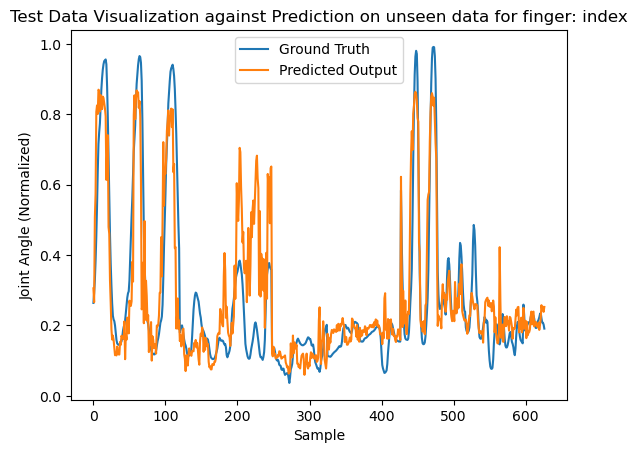

Prediction results R2 for testing of finger: 0.7548120104069993
Prediction results R2 for Training of finger: 0.9424578374438121
Prediction results RMSE for for testing of finger: 0.1343970651676081
Prediction results RMSE for for Training of finger: 0.058322011618781554


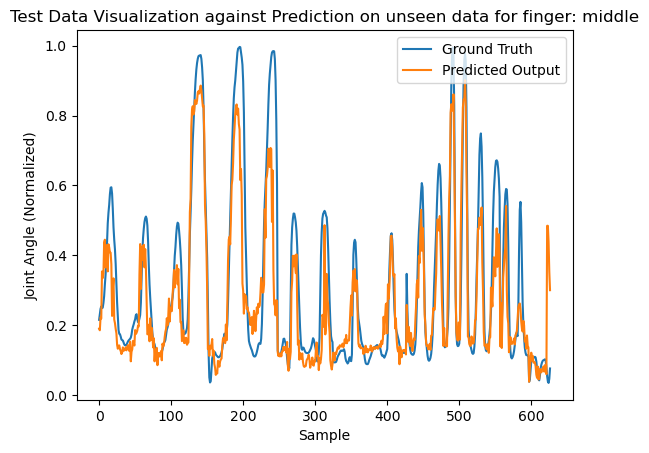

Prediction results R2 for testing of finger: 0.7483856937657166
Prediction results R2 for Training of finger: 0.9442788094262592
Prediction results RMSE for for testing of finger: 0.12460432879161723
Prediction results RMSE for for Training of finger: 0.054830857383079856


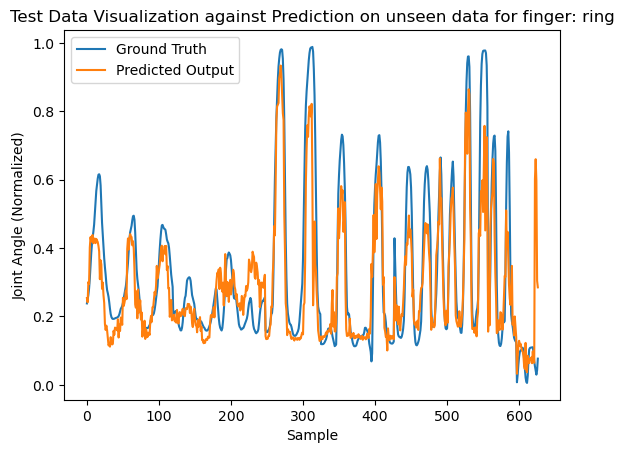

Prediction results R2 for testing of finger: 0.7900806321079212
Prediction results R2 for Training of finger: 0.9103464862537616
Prediction results RMSE for for testing of finger: 0.09062254054724635
Prediction results RMSE for for Training of finger: 0.055462933221125714


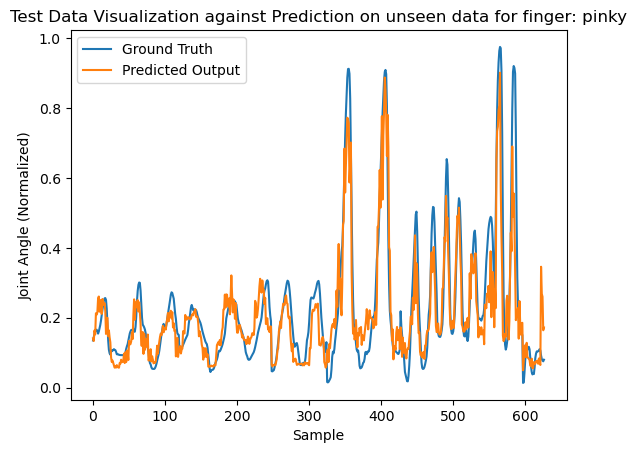

Prediction results R2 for testing of finger: 0.6110959788382394
Prediction results R2 for Training of finger: 0.9238690232911587
Prediction results RMSE for for testing of finger: 0.17074516647976454
Prediction results RMSE for for Training of finger: 0.06743807867641137


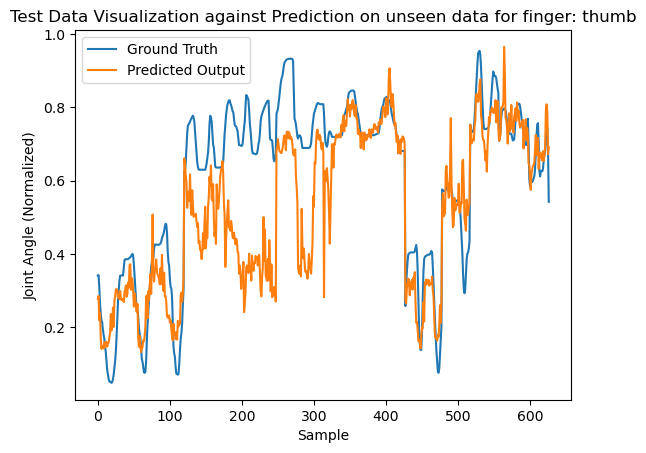

In [12]:
# Testing on other data not seen

#Random Motion
#s2_t4_mat6 = scipy.io.loadmat('../10- Kinematics Extraction/Python Pipeline/Dataset_Processed/Subject2/Trial 4/HO_random_Processed.mat')


#print("Finished Reading Data of Subject 2")

# Shaping extracted dataset

all_inputs, test_inputs = HCM_split_data(*S2T4_EMG_3D_SET_optimized, *S2T5_EMG_3D_SET_optimized, percentage = 0.83)
all_outputs, test_outputs = HCM_split_data(*S2T4_KIN_NORM_SET, *S2T5_KIN_NORM_SET, percentage = 0.83)

#randomize data order
from sklearn.utils import shuffle
#test_inputs, test_outputs = shuffle(test_inputs, test_outputs)

#[EMG_per_trial, S2T4_ALL_EMG_NORM_TEST, S2T4_EMG_SEQ_SET_TEST,
# S2T4_EMG_3D_SET_TEST, S2T4_ALL_KIN_OVERSAMPLE_TEST, S2T4_KIN_RAW_SET_TEST,
# S2T4_KIN_NORM_SET_TEST, S2T4_ALL_EMG_TEST, S2T4_ALL_EMG_UP_TEST,
# S2T4_ALL_EMG_REC_TEST, S2T4_ALL_KIN_TEST] = HCM_EMG_PIPELINE(s2_t4_mat6, 
#                                                              window_duration_sec = 0.208, 
#                                                              window_overlap_percentage=50,
#                                                              rows = 20, thickness = 20,
#                                                              return_all = True,
#                                                              EMG_mode = EMG_MODE,
#                                                              ACC_Data = ACC_DATA,
#                                                              Up_Sample = UP_SAMPLE)

# loading Model to Test
with keras.utils.custom_object_scope({'pearson_r2': pearson_r2}):
    model = load_model('HCM_CNN_model_rand_big.h5')

# Testing Model Prediction
test_prediction = model.predict(test_inputs)#test_inputs)#S2T4_EMG_3D_SET_TEST[0])
ground_truth = test_outputs#test_outputs #S2T4_KIN_NORM_SET_TEST[0]

train_prediction = model.predict(all_inputs)#test_inputs)#S2T4_EMG_3D_SET_TEST[0])
train_ground_truth = all_outputs#test_outputs #S2T4_KIN_NORM_SET_TEST[0]

print("Prediction results R2 for Overall Testing Data:",pearson_r2_evaluate(ground_truth, test_prediction))
print("Prediction results R2 for Overall Training Data:",pearson_r2_evaluate(train_ground_truth, train_prediction))

print("Prediction results RMSE for  Overall Testing Data:",rmse(ground_truth, test_prediction))
print("Prediction results RMSE for Overall Training Data:",rmse(train_ground_truth, train_prediction))

prediction_sample = 0
finger_to_plot = 0

for i in range(5):
    finger_to_plot = i
    if (finger_to_plot == 0):
        finger = 'index'
    elif (finger_to_plot == 1):
        finger = 'middle'
    elif (finger_to_plot == 2):
        finger = 'ring'
    elif (finger_to_plot == 3):
        finger = 'pinky'
    elif (finger_to_plot == 4):
        finger = 'thumb'
    
    
    print("Prediction results R2 for testing of finger:",pearson_r2_evaluate(ground_truth[:,finger_to_plot], test_prediction[:,finger_to_plot]))
    print("Prediction results R2 for Training of finger:",pearson_r2_evaluate(train_ground_truth[:,finger_to_plot], train_prediction[:,finger_to_plot]))
    
    print("Prediction results RMSE for for testing of finger:",rmse(ground_truth[:,finger_to_plot], test_prediction[:,finger_to_plot]))
    print("Prediction results RMSE for for Training of finger:",rmse(train_ground_truth[:,finger_to_plot], train_prediction[:,finger_to_plot]))
    
    plt.figure()
    plt.plot(ground_truth[:,finger_to_plot])
    plt.plot(test_prediction[:,finger_to_plot])
    plt.title("Test Data Visualization against Prediction on unseen data for finger: "+finger)
    plt.xlabel('Sample')
    plt.ylabel('Joint Angle (Normalized)')
    plt.legend(labels= ['Ground Truth', 'Predicted Output'], loc='best')
    plt.show()
    
    
    
####### Export the unseen data to be later used by the edhge deployed system for validation
####### Assume data is a numpy array with shape (samples, length, width, channels)
######print(test_inputs.shape)
####### Convert data to a DataFrame
######data_df = pd.DataFrame(test_inputs.reshape(test_inputs.shape[0], -1))  # Reshape to (samples, length*width*channels)
######print(data_df.shape)
####### Save DataFrame to CSV file
######data_df.to_csv('data_for_testing.csv', index=False)
######
####### Load data from CSV file
######loaded_data_df = pd.read_csv('data_for_testing.csv')
######print(loaded_data_df.shape)
####### Convert DataFrame back to numpy array
######loaded_data = loaded_data_df.to_numpy().reshape(loaded_data_df.shape[0], test_inputs.shape[1], test_inputs.shape[2], test_inputs.shape[3])
######print(loaded_data.shape)

96/96 [==============================] - 0s 4ms/step
Prediction results R2 for pruned model: 0.7814114603318802
Prediction results R2 for pruning guided reduced model: 0.8135956805180317
Prediction results RMSE for pruned model: 0.13458307499215058
Prediction results RMSE for pruning guided reduced model: 0.11642678084327417
Prediction results R2 for pruned model in training: 0.9079033144552027
Prediction results R2 for pruning guided reduced model in training: 0.9292691037269605
Prediction results RMSE for pruned model in training: 0.08226141423153446
Prediction results RMSE for pruning guided reduced model in training: 0.06672055260085492
Prediction results R2 for pruned model of finger: 0.7455348307106996
Prediction results R2 for pruning guided reduced model of finger: 0.7624167182828696
Prediction results RMSE for pruned model of finger: 0.1167749618116081
Prediction results RMSE for pruning guided reduced model of finger: 0.10947811074919322
Prediction results R2 for pruned model

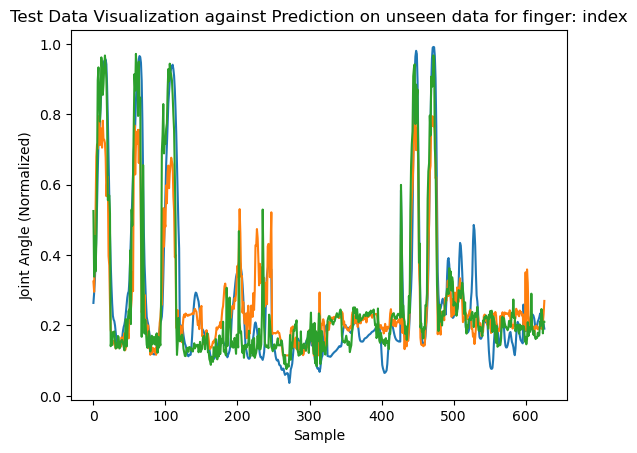

Prediction results R2 for pruned model of finger: 0.7394326777811132
Prediction results R2 for pruning guided reduced model of finger: 0.7830294116131188
Prediction results RMSE for pruned model of finger: 0.15287542713022895
Prediction results RMSE for pruning guided reduced model of finger: 0.11960821526302975
Prediction results R2 for pruned model of finger in training: 0.9147182181960095
Prediction results R2 for pruning guided reduced model of finger in training: 0.9124749678060216
Prediction results RMSE for pruned model of finger in training: 0.08737497599097475
Prediction results RMSE for pruning guided reduced model of finger in training: 0.06920893927254611


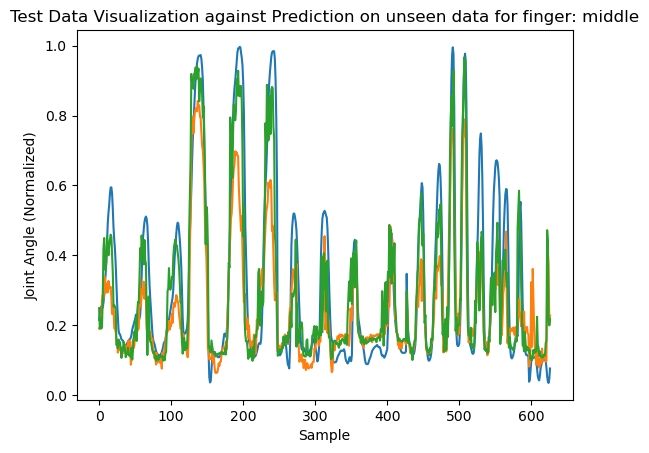

Prediction results R2 for pruned model of finger: 0.699092699305271
Prediction results R2 for pruning guided reduced model of finger: 0.7358618288263841
Prediction results RMSE for pruned model of finger: 0.14433867233582373
Prediction results RMSE for pruning guided reduced model of finger: 0.12577208977517287
Prediction results R2 for pruned model of finger in training: 0.9345385172767716
Prediction results R2 for pruning guided reduced model of finger in training: 0.9246830085857839
Prediction results RMSE for pruned model of finger in training: 0.07506331281184525
Prediction results RMSE for pruning guided reduced model of finger in training: 0.06218495401467334


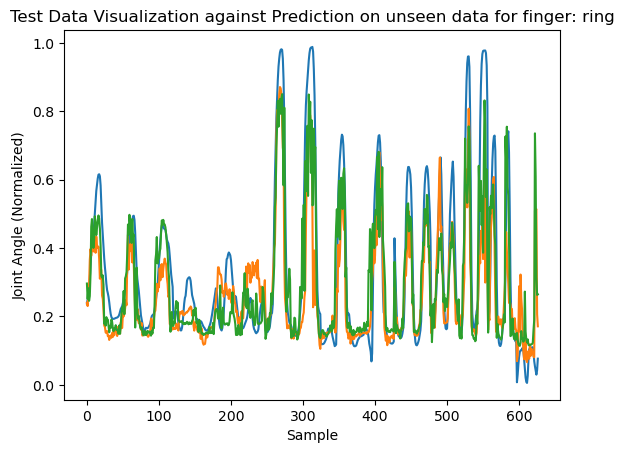

Prediction results R2 for pruned model of finger: 0.7485584133660361
Prediction results R2 for pruning guided reduced model of finger: 0.7138675720241265
Prediction results RMSE for pruned model of finger: 0.10663680793601041
Prediction results RMSE for pruning guided reduced model of finger: 0.10205128840125254
Prediction results R2 for pruned model of finger in training: 0.8675454827561845
Prediction results R2 for pruning guided reduced model of finger in training: 0.8882200883921766
Prediction results RMSE for pruned model of finger in training: 0.07667045749932568
Prediction results RMSE for pruning guided reduced model of finger in training: 0.059271856286098615


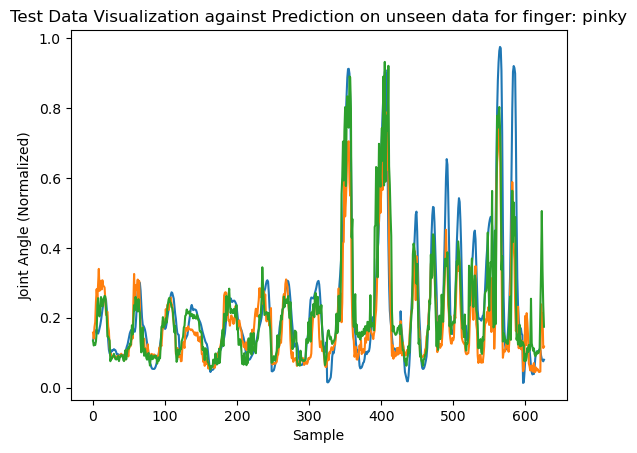

Prediction results R2 for pruned model of finger: 0.692519718422566
Prediction results R2 for pruning guided reduced model of finger: 0.7818366648503065
Prediction results RMSE for pruned model of finger: 0.1461186891089288
Prediction results RMSE for pruning guided reduced model of finger: 0.12349619656187524
Prediction results R2 for pruned model of finger in training: 0.9029966684178085
Prediction results R2 for pruning guided reduced model of finger in training: 0.907229138553442
Prediction results RMSE for pruned model of finger in training: 0.08051936293993174
Prediction results RMSE for pruning guided reduced model of finger in training: 0.0737535417874006


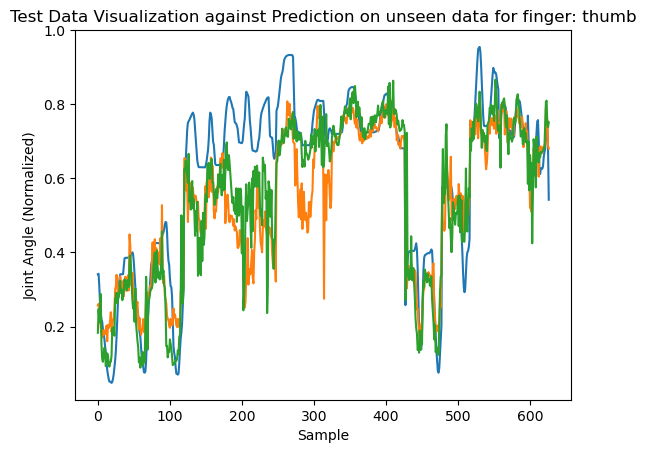

In [11]:
def rmse(targets, predictions):
    return np.sqrt(((predictions - targets) ** 2).mean())

# Plot pruned model and pruning guiuded model reduction results for comparison

#get data and split
all_inputs, test_inputs = HCM_split_data(*S2T4_EMG_3D_SET_optimized, *S2T5_EMG_3D_SET_optimized, percentage = 0.83)
all_outputs, test_outputs = HCM_split_data(*S2T4_KIN_NORM_SET, *S2T5_KIN_NORM_SET, percentage = 0.83)

#load pruned model
with keras.utils.custom_object_scope({'pearson_r2': pearson_r2}):
    model1 = load_model('HCM_CNN_model_rand_big_pruned.h5')
    
#load pruning guiuded reduced model 
with keras.utils.custom_object_scope({'pearson_r2': pearson_r2}):
    model2 = load_model('HCM_CNN_model_rand.h5')
    
# Testing Model Prediction
test_prediction1 = model1.predict(test_inputs)
test_prediction2 = model2.predict(test_inputs)
ground_truth = test_outputs

train_prediction1 = model1.predict(all_inputs)#test_inputs)#S2T4_EMG_3D_SET_TEST[0])
train_prediction2 = model2.predict(all_inputs)#test_inputs)#S2T4_EMG_3D_SET_TEST[0])
train_ground_truth = all_outputs#test_outputs #S2T4_KIN_NORM_SET_TEST[0]

print("Prediction results R2 for pruned model:",pearson_r2_evaluate(ground_truth, test_prediction1))
print("Prediction results R2 for pruning guided reduced model:",pearson_r2_evaluate(ground_truth, test_prediction2))

print("Prediction results RMSE for pruned model:",rmse(ground_truth, test_prediction1))
print("Prediction results RMSE for pruning guided reduced model:",rmse(ground_truth, test_prediction2))

print("Prediction results R2 for pruned model in training:",pearson_r2_evaluate(train_ground_truth, train_prediction1))
print("Prediction results R2 for pruning guided reduced model in training:",pearson_r2_evaluate(train_ground_truth, train_prediction2))

print("Prediction results RMSE for pruned model in training:",rmse(train_ground_truth, train_prediction1))
print("Prediction results RMSE for pruning guided reduced model in training:",rmse(train_ground_truth, train_prediction2))

prediction_sample = 0
finger_to_plot = 0

for i in range(5):
    finger_to_plot = i
    if (finger_to_plot == 0):
        finger = 'index'
    elif (finger_to_plot == 1):
        finger = 'middle'
    elif (finger_to_plot == 2):
        finger = 'ring'
    elif (finger_to_plot == 3):
        finger = 'pinky'
    elif (finger_to_plot == 4):
        finger = 'thumb'
        
    print("Prediction results R2 for pruned model of finger:",pearson_r2_evaluate(ground_truth[:,finger_to_plot], test_prediction1[:,finger_to_plot]))
    print("Prediction results R2 for pruning guided reduced model of finger:",pearson_r2_evaluate(ground_truth[:,finger_to_plot], test_prediction2[:,finger_to_plot]))

    print("Prediction results RMSE for pruned model of finger:",rmse(ground_truth[:,finger_to_plot], test_prediction1[:,finger_to_plot]))
    print("Prediction results RMSE for pruning guided reduced model of finger:",rmse(ground_truth[:,finger_to_plot], test_prediction2[:,finger_to_plot]))
    
    print("Prediction results R2 for pruned model of finger in training:",pearson_r2_evaluate(train_ground_truth[:,finger_to_plot], train_prediction1[:,finger_to_plot]))
    print("Prediction results R2 for pruning guided reduced model of finger in training:",pearson_r2_evaluate(train_ground_truth[:,finger_to_plot], train_prediction2[:,finger_to_plot]))

    print("Prediction results RMSE for pruned model of finger in training:",rmse(train_ground_truth[:,finger_to_plot], train_prediction1[:,finger_to_plot]))
    print("Prediction results RMSE for pruning guided reduced model of finger in training:",rmse(train_ground_truth[:,finger_to_plot], train_prediction2[:,finger_to_plot]))
    
    plt.figure()
    plt.plot(ground_truth[:,finger_to_plot])
    plt.plot(test_prediction1[:,finger_to_plot])
    plt.plot(test_prediction2[:,finger_to_plot])
    plt.title("Test Data Visualization against Prediction on unseen data for finger: "+finger)
    plt.xlabel('Sample')
    plt.ylabel('Joint Angle (Normalized)')
    #plt.legend(labels= ['Ground Truth', 'Pruned Model Predicted Output', 'Pruning Guided Reduced Model Predicted Output'], loc='best')
    plt.show()
        

In [25]:
# Visualize Model Architecture
import visualkeras
from PIL import ImageFont

font = ImageFont.truetype("arial.ttf", 32)  # using comic sans is strictly prohibited!
visualkeras.graph_view(base_model).show()  # font is optional!

IndexError: index 27 is out of bounds for axis 1 with size 27

In [28]:
# Converting the model from Tensorflow to Pytorch to use the NNI capabilities of pruning.

import tf2onnx
import onnx
from onnx2pytorch import ConvertModel

# loading Model to Test
with keras.utils.custom_object_scope({'pearson_r2': pearson_r2}):
    model = load_model('HCM_CNN_model_rand.h5')

# Convert the model to ONNX format
onnx_model, _ = tf2onnx.convert.from_keras(model)
 
# Convert ONNX model to PyTorch
pytorch_model = ConvertModel(onnx_model)

TypeError: __init__() got an unexpected keyword argument 'fn'

In [29]:
# Testing conversion from pytorch back to tensorflow when done pruning
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms
from torch.autograd import Variable
import onnx
from onnx_tf.backend import prepare


trained_model = torch.load('HCM_Pytorch_CNN_Rand.pth')
dummy_input = Variable(torch.randn(1, 40, 40, 14))
torch.onnx.export(trained_model, dummy_input, "HCM_Pytorch_CNN_Rand.onnx")


onnx_model = onnx.load('HCM_Pytorch_CNN_Rand.onnx')

# Convert ONNX model to TensorFlow
tf_rep = prepare(onnx_model)

prepare(onnx_model).export_graph('fffffffffffffff')

ModuleNotFoundError: No module named 'onnx_tf'

In [30]:
import torch
from torch.utils.data import Dataset

class CustomDataset(Dataset):
    def __init__(self, data, targets, transform=None):
        self.data = data
        self.targets = targets
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        sample = self.data[idx]
        target = self.targets[idx]

        if self.transform:
            sample = self.transform(sample)

        return sample, target

In [3]:
# Testing model predictions after pytorch conversion

import torch
import torchvision.transforms as transforms
from torch.utils.data import DataLoader

# Loading Dataset and preparing training and validation data

all_inputs, test_inputs = HCM_split_data(*S2T4_EMG_3D_SET, *S2T5_EMG_3D_SET, percentage = 0.83)
all_outputs, test_outputs = HCM_split_data(*S2T4_KIN_NORM_SET, *S2T5_KIN_NORM_SET, percentage = 0.83)

X_train, X_test, y_train, y_test = train_test_split(np.transpose(all_inputs, (0, 2, 3, 1)), all_outputs, test_size=0.3)

# Step 1: Load the pretrained model
# Replace 'your_model.pth' with the path to your pretrained model
pretrained_model = pytorch_model
pretrained_model.eval()  # Set the model to evaluation mode

# Step 2: Prepare your dataset for testing
# Example: Load your dataset and apply necessary transformations
# Replace YourDataset with the appropriate dataset class and transform as needed
test_dataset = CustomDataset(X_test.astype(np.float32), y_test.astype(np.float32), transform=transforms.ToTensor())

# Step 3: Iterate through your dataset and perform inference
results = []
for inputs, labels in DataLoader(test_dataset):
    # Perform any additional preprocessing if needed
    # For example, you may need to reshape or normalize the input data

    # Pass the input through the pretrained model for inference
    with torch.no_grad():  # Disable gradient tracking during inference
        outputs = pretrained_model(inputs)
        

    # Optionally, post-process the outputs if needed
    # For example, you may need to apply softmax or extract predictions
    
    # Store the results
    results.append(outputs)

# Step 4: Optionally, Save the model
torch.save(pretrained_model, 'HCM_Pytorch_CNN_Rand.pth')


NameError: name 'HCM_split_data' is not defined

(913, 5)
Prediction results R2: 0.9685581375971759


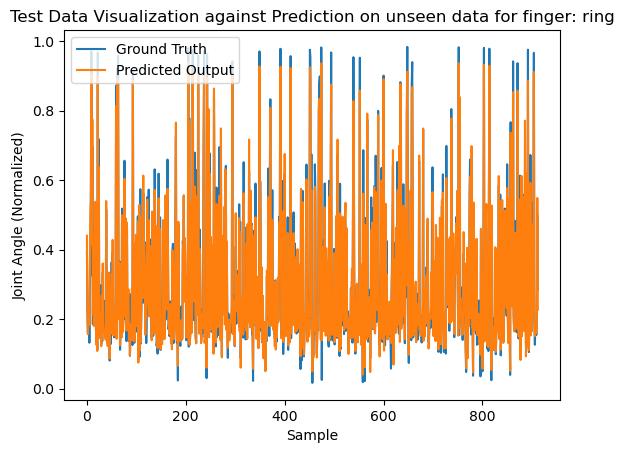

In [8]:
# Evaluate the model and compare to ground truth
prediction_results = np.array(results[0])

for i in range(len(results)-1):
    prediction_results = np.append(prediction_results, np.array(results[i+1]), axis = 0)

print(prediction_results.shape)


# Testing Model Prediction
test_prediction = prediction_results
ground_truth = y_test

print("Prediction results R2:",pearson_r2_evaluate(ground_truth, test_prediction))

prediction_sample = 0
finger_to_plot = 2

if (finger_to_plot == 0):
    finger = 'index'
elif (finger_to_plot == 1):
    finger = 'middle'
elif (finger_to_plot == 2):
    finger = 'ring'
elif (finger_to_plot == 3):
    finger = 'pinky'
elif (finger_to_plot == 4):
    finger = 'thumb'


    
plt.figure()
plt.plot(ground_truth[:,finger_to_plot])
plt.plot(test_prediction[:,finger_to_plot])
plt.title("Test Data Visualization against Prediction on unseen data for finger: "+finger)
plt.xlabel('Sample')
plt.ylabel('Joint Angle (Normalized)')
plt.legend(labels= ['Ground Truth', 'Predicted Output'], loc='upper left')
plt.show()

ConvertModel(
  (Transpose_sequential_1/conv2d_13/BiasAdd__6:0): Transpose()
  (Conv_sequential_1/conv2d_13/BiasAdd:0): PrunerModuleWrapper(
    (module): Conv2d(14, 128, kernel_size=(3, 3), stride=(1, 1))
  )
  (Relu_sequential_1/conv2d_13/Relu:0): ReLU(inplace=True)
  (Conv_sequential_1/conv2d_14/BiasAdd:0): PrunerModuleWrapper(
    (module): Conv2d(128, 64, kernel_size=(3, 3), stride=(1, 1))
  )
  (Relu_sequential_1/conv2d_14/Relu:0): ReLU(inplace=True)
  (Conv_sequential_1/conv2d_15/BiasAdd:0): PrunerModuleWrapper(
    (module): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1))
  )
  (Relu_sequential_1/conv2d_15/Relu:0): ReLU(inplace=True)
  (Conv_sequential_1/conv2d_16/BiasAdd:0): PrunerModuleWrapper(
    (module): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1))
  )
  (Relu_sequential_1/conv2d_16/Relu:0): ReLU(inplace=True)
  (Conv_sequential_1/conv2d_17/BiasAdd:0): PrunerModuleWrapper(
    (module): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1))
  )
  (Relu_sequential_1/conv

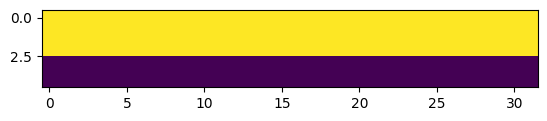

In [1]:
# Pruning using NNI library for speedup (physical prune) 1/4/2024

import torch
from nni.compression.pytorch.pruning import L1NormPruner

#Configuration Parameters
epoch_num = 30
batch_num = 128

config_list = [{
    'sparsity_per_layer': 0.4,
    'op_types': ['Linear','Conv2d']
}]

pytorch_model = torch.load('HCM_Pytorch_CNN_Rand.pth')
pruner = L1NormPruner(pytorch_model, config_list)

# show the wrapped model structure, `PrunerModuleWrapper` have wrapped the layers that configured in the config_list.
print(pytorch_model)

# compress the model and generate the masks
_, masks = pruner.compress()
# show the masks sparsity
for name, mask in masks.items():
    print(name, ' sparsity : ', '{:.2}'.format(mask['weight'].sum() / mask['weight'].numel()))

# Mask Visualization
import matplotlib.pyplot as plt

for _, mask in masks.items():
    mask = mask['weight'].detach().cpu().numpy()

print ("sparsity: {}".format(mask.sum()/mask.size))
plt.imshow(mask)

In [3]:
# speedup the model, for more information about speedup, please refer :doc:`pruning_speedup`.
#from nni.compression.pytorch import ModelSpeedup
#from torch.autograd import Variable

# speedup the model, for more information about speedup, please refer :doc:`pruning_speedup`.
from nni.compression.pytorch.speedup import ModelSpeedup
pruner._unwrap_model()

device = 'cuda' if torch.cuda.is_available() else 'cpu'
pytorch_model.to(device)

pytorch_model = ModelSpeedup(pytorch_model, torch.rand([1, 14, 40, 40]).to(device), masks).speedup_model()
print(pytorch_model)

NotImplementedError: Input with larger batch size than 1 not supported yet.

In [1]:
import torch
import torch.nn.functional as F
from torch.optim import SGD

from nni_assets.compression.mnist_model import TorchModel, trainer, evaluator, device

# define the model
model = TorchModel().to(device)

# show the model structure, note that pruner will wrap the model layer.
print(model)

# define the optimizer and criterion for pre-training

optimizer = SGD(model.parameters(), 1e-2)
criterion = F.nll_loss

# pre-train and evaluate the model on MNIST dataset
for epoch in range(3):
    trainer(model, optimizer, criterion)
    evaluator(model)


config_list = [{
    'op_types': ['Linear', 'Conv2d'],
    'exclude_op_names': ['fc3'],
    'sparse_ratio': 0.5
}]

from nni.contrib.compression.pruning import L1NormPruner
pruner = L1NormPruner(model, config_list)

# show the wrapped model structure, `PrunerModuleWrapper` have wrapped the layers that configured in the config_list.
print(model)

# compress the model and generate the masks
_, masks = pruner.compress()
# show the masks sparsity
for name, mask in masks.items():
    print(name, ' sparsity : ', '{:.2}'.format(mask['weight'].sum() / mask['weight'].numel()))


# need to unwrap the model, if the model is wrapped before speedup
pruner.unwrap_model()

# speedup the model, for more information about speedup, please refer :doc:`pruning_speedup`.
from nni.compression.pytorch.speedup.v2 import ModelSpeedup

model = ModelSpeedup(model, torch.rand([3, 1, 28, 28]).to(device), masks).speedup_model()
print(model)

optimizer = SGD(model.parameters(), 1e-2)
for epoch in range(3):
    trainer(model, optimizer, criterion)

TorchModel(
  (conv1): Conv2d(1, 6, kernel_size=(5, 5), stride=(1, 1))
  (conv2): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
  (fc1): Linear(in_features=256, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=10, bias=True)
  (relu1): ReLU()
  (relu2): ReLU()
  (relu3): ReLU()
  (relu4): ReLU()
  (pool1): MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  (pool2): MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
)
Average test loss: 0.4052, Accuracy: 8849/10000 (88%)
Average test loss: 0.2172, Accuracy: 9357/10000 (94%)
Average test loss: 0.1468, Accuracy: 9554/10000 (96%)
TorchModel(
  (conv1): Conv2d(
    1, 6, kernel_size=(5, 5), stride=(1, 1)
    (_nni_wrapper): ModuleWrapper(module=Conv2d(1, 6, kernel_size=(5, 5), stride=(1, 1)), module_name=conv1)
  )
  (conv2): Conv2d(
    6, 16, kernel_size=(5, 5), stride=(1, 1)
    (_

D:\Anaconda\anaconda3\envs\test2\lib\site-packages\nni\compression\pytorch\speedup\v2\utils.py:31: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  _register_pytree_node(immutable_dict, _idict_flatten, _idict_unflatten)
D:\Anaconda\anaconda3\envs\test2\lib\site-packages\torch\utils\_pytree.py:254: UserWarning: <class 'torch.fx.immutable_collections.immutable_dict'> is already registered as pytree node. Overwriting the previous registration.
  warnings.warn(
D:\Anaconda\anaconda3\envs\test2\lib\site-packages\nni\compression\pytorch\speedup\v2\utils.py:32: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  _register_pytree_node(immutable_list, _ilist_flatten, _ilist_unflatten)
D:\Anaconda\anaconda3\envs\test2\lib\site-packages\torch\utils\_pytree.py:254: UserWarning: <class 'torch.fx.immutable_collections.immutable_list'> is

AttributeError: 'NoneType' object has no attribute 'startswith'

In [8]:
import torch
from torchvision.models import convnext_tiny
from torchvision.models.convnext import LayerNorm2d

from nni.common.concrete_trace_utils import concrete_trace
from nni.compression.speedup import ModelSpeedup
from nni.compression.speedup.mask_updater import NoChangeMaskUpdater
from nni.compression.speedup.replacer import Replacer, DefaultReplacer

In [8]:
#### Perform Quantization - Aware Training to let the model work with 8-bit data
###
####Configuration Parameters
###epoch_num = 150
###batch_num = 128
###
#### Loading Dataset and preparing training and validation data
###
###all_inputs, test_inputs = HCM_split_data(*S2T4_EMG_3D_SET, *S2T5_EMG_3D_SET, percentage = 0.83)
###all_outputs, test_outputs = HCM_split_data(*S2T4_KIN_NORM_SET, *S2T5_KIN_NORM_SET, percentage = 0.83)
###X_train, X_test, y_train, y_test = train_test_split(all_inputs, all_outputs, test_size=0.3)
###
#### Load the model to be pruned:
###
###with tf.keras.utils.custom_object_scope({'pearson_r2': pearson_r2}):
###    base_model = load_model('HCM_CNN_model_rand.h5')
###    
###    
###def apply_quantization_to_dense(layer):
###    if (isinstance(layer, tf.keras.layers.Dense) or isinstance(layer, tf.keras.layers.Conv2D)):
###        return tfmot.quantization.keras.quantize_annotate_layer(layer)
###    return layer
###
#### Use `tf.keras.models.clone_model` to apply `apply_quantization_to_dense` 
#### to the layers of the model.
###annotated_model  = tf.keras.models.clone_model(
###    base_model,
###    clone_function=apply_quantization_to_dense,
###)
###
#### Apply the wrapper for quantization
###quant_aware_model = tfmot.quantization.keras.quantize_apply(annotated_model)
###
#### Compile Model and show summary
###quant_aware_model.summary()
###
#### Typically you train the model here.
###
###opt = tf.keras.optimizers.Adam(learning_rate = 2.4414e-07) # Learning rate previously stopped at
###reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=50, min_lr=0.00000001)
###ES_callback = EarlyStopping(monitor='val_loss', patience=200)
###log_dir = tempfile.mkdtemp()
###
###callbacks = [
###    # Log sparsity and other metrics in Tensorboard.
###    ES_callback,#tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1),
###    reduce_lr
###]
###
###
###quant_aware_model.compile(optimizer=opt, loss=tf.keras.losses.MeanSquaredError(), 
###              metrics=[pearson_r2, tf.keras.metrics.RootMeanSquaredError()])
###
###
###CNN_specs = quant_aware_model.fit(X_train, y_train, epochs=epoch_num, shuffle = True, 
###                              batch_size=batch_num, validation_data=(X_test, y_test), callbacks=callbacks)
###
###

In [5]:
# PRUNING of the Trained Model (21/2/2024)

#Configuration Parameters
epoch_num = 30  #150 if small model
batch_num = 128

# Loading Dataset and preparing training and validation data

all_inputs, test_inputs = HCM_split_data(*S2T4_EMG_3D_SET_optimized, *S2T5_EMG_3D_SET_optimized, percentage = 0.83)
all_outputs, test_outputs = HCM_split_data(*S2T4_KIN_NORM_SET, *S2T5_KIN_NORM_SET, percentage = 0.83)

X_train, X_test, y_train, y_test = train_test_split(all_inputs, all_outputs, test_size=0.3)

# Load the model to be pruned:

with tf.keras.utils.custom_object_scope({'pearson_r2': pearson_r2}):
    base_model = load_model('HCM_CNN_model_rand_big.h5')

end_step = np.ceil(len(X_train) / batch_num).astype(np.int32) * epoch_num
    
pruning_params = {
      'pruning_schedule': tfmot.sparsity.keras.PolynomialDecay(initial_sparsity=0.30, #0.10
                                                               final_sparsity=0.60,   #0.30
                                                               begin_step=0,
                                                              end_step = end_step,
                                                              frequency = 10),
    'block_size': (1, 1)  # Set block_size to (1, 1) for filter-level pruning
}    

#model_for_pruning = tfmot.sparsity.keras.prune_low_magnitude(base_model, **pruning_params)
                                                             #pruning_schedule=tfmot.sparsity.keras.ConstantSparsity(0.5, 0))
first_layer_name = base_model.layers[0].name # used to prevent pruning on first layer

# Helper function uses `prune_low_magnitude` to make only the 
# Dense layers train with pruning.
def apply_pruning_to_dense(layer):
    if (isinstance(layer, tf.keras.layers.Dense) or isinstance(layer, tf.keras.layers.Conv2D)) and layer.name != first_layer_name:
        return tfmot.sparsity.keras.prune_low_magnitude(layer, **pruning_params)
    return layer

# Use `tf.keras.models.clone_model` to apply `apply_pruning_to_dense` 
# to the layers of the model.
model_for_pruning = tf.keras.models.clone_model(
    base_model,
    clone_function=apply_pruning_to_dense,
)
    
# Compile Model and show summary
model_for_pruning.summary()

opt = tf.keras.optimizers.Adam(learning_rate =  3.9063e-06) # Learning rate previously stopped at
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=50, min_lr=0.00000001)
ES_callback = EarlyStopping(monitor='val_loss', patience=200)
log_dir = tempfile.mkdtemp()


callbacks = [
    tfmot.sparsity.keras.UpdatePruningStep(),
    # Log sparsity and other metrics in Tensorboard.
    tfmot.sparsity.keras.PruningSummaries(log_dir=log_dir),
    ES_callback,#tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1),
    reduce_lr
]


model_for_pruning.compile(optimizer=opt, loss=tf.keras.losses.MeanSquaredError(), 
              metrics=[pearson_r2, tf.keras.metrics.RootMeanSquaredError()])


CNN_specs = model_for_pruning.fit(X_train, y_train, epochs=epoch_num, shuffle = True, 
                              batch_size=batch_num, validation_data=(X_test, y_test), callbacks=callbacks)

model_for_export = tfmot.sparsity.keras.strip_pruning(model_for_pruning)

pruned_keras_file_path = "HCM_CNN_model_rand_big_pruned.h5"
model_for_export.save(pruned_keras_file_path)
print('Saved pruned Keras model to:', pruned_keras_file_path)

print("final model")
model_for_export.summary()




Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_13 (Conv2D)          (None, 20, 20, 128)       16256     
                                                                 
 prune_low_magnitude_conv2d  (None, 20, 20, 64)        147522    
 _14 (PruneLowMagnitude)                                         
                                                                 
 prune_low_magnitude_conv2d  (None, 18, 18, 64)        73794     
 _15 (PruneLowMagnitude)                                         
                                                                 
 prune_low_magnitude_conv2d  (None, 18, 18, 64)        73794     
 _16 (PruneLowMagnitude)                                         
                                                                 
 prune_low_magnitude_conv2d  (None, 18, 18, 64)        73794     
 _17 (PruneLowMagnitude)                            

Epoch 10/30
17/17 [==============================] - 4s 265ms/step - loss: 0.0086 - pearson_r2: 0.8712 - root_mean_squared_error: 0.0906 - val_loss: 0.0142 - val_pearson_r2: 0.8189 - val_root_mean_squared_error: 0.1175 - lr: 3.9063e-06
Epoch 11/30
17/17 [==============================] - 5s 272ms/step - loss: 0.0094 - pearson_r2: 0.8582 - root_mean_squared_error: 0.0950 - val_loss: 0.0154 - val_pearson_r2: 0.7863 - val_root_mean_squared_error: 0.1223 - lr: 3.9063e-06
Epoch 12/30
17/17 [==============================] - 4s 260ms/step - loss: 0.0103 - pearson_r2: 0.8453 - root_mean_squared_error: 0.0993 - val_loss: 0.0148 - val_pearson_r2: 0.7988 - val_root_mean_squared_error: 0.1198 - lr: 3.9063e-06
Epoch 13/30
17/17 [==============================] - 5s 274ms/step - loss: 0.0098 - pearson_r2: 0.8532 - root_mean_squared_error: 0.0969 - val_loss: 0.0135 - val_pearson_r2: 0.8352 - val_root_mean_squared_error: 0.1142 - lr: 3.9063e-06
Epoch 14/30
17/17 [==============================] - 4s 

 dropout_4 (Dropout)         (None, 14, 14, 32)        0         
                                                                 
 flatten_1 (Flatten)         (None, 6272)              0         
                                                                 
 dense_4 (Dense)             (None, 128)               802944    
                                                                 
 dense_5 (Dense)             (None, 64)                8256      
                                                                 
 dropout_5 (Dropout)         (None, 64)                0         
                                                                 
 dense_6 (Dense)             (None, 32)                2080      
                                                                 
 dense_7 (Dense)             (None, 5)                 165       
                                                                 
Total params: 1208965 (4.61 MB)
Trainable params: 1208581 (4.61 MB)
Non-trai

D:\Anaconda\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [12]:
#### Perform Quantization Aware Training after Pruning (PQAT)
###
#### Load Model
###with tf.keras.utils.custom_object_scope({'pearson_r2': pearson_r2}):
###    stripped_pruned_model = load_model('HCM_CNN_model_rand_pruned.h5')
###    
#### Load Data
###all_inputs, test_inputs = HCM_split_data(*S2T4_EMG_3D_SET, *S2T5_EMG_3D_SET, percentage = 0.83)
###all_outputs, test_outputs = HCM_split_data(*S2T4_KIN_NORM_SET, *S2T5_KIN_NORM_SET, percentage = 0.83)
###X_train, X_test, y_train, y_test = train_test_split(all_inputs, all_outputs, test_size=0.3)
###    
#### PQAT
###quant_aware_annotate_model = tfmot.quantization.keras.quantize_annotate_model(
###              stripped_pruned_model)
###with tfmot.quantization.keras.quantize_scope({'pearson_r2': pearson_r2}):
###    pqat_model = tfmot.quantization.keras.quantize_apply(
###              quant_aware_annotate_model,
###              tfmot.experimental.combine.Default8BitPrunePreserveQuantizeScheme())
###
###opt = tf.keras.optimizers.Adam(learning_rate = 2.4414e-07) # Learning rate previously stopped at
###pqat_model.compile(optimizer=opt, loss=tf.keras.losses.MeanSquaredError(), 
###              metrics=[pearson_r2, tf.keras.metrics.RootMeanSquaredError()])
###
###
###print('Train pqat model:')
###CNN_specs = pqat_model.fit(X_train, y_train, epochs=epoch_num, shuffle = True, 
###                              batch_size=batch_num, validation_data=(X_test, y_test), callbacks=callbacks)

Layer conv2d_13: Sparsity = 0.0
Layer conv2d_14: Sparsity = 0.6000027126736112
Layer conv2d_15: Sparsity = 0.5999891493055556
Layer conv2d_16: Sparsity = 0.5999891493055556
Layer conv2d_17: Sparsity = 0.5999891493055556
Layer conv2d_18: Sparsity = 0.5999891493055556
Layer conv2d_19: Sparsity = 0.5999891493055556
Layer conv2d_20: Sparsity = 0.5999891493055556
Layer conv2d_21: Sparsity = 0.5999891493055556
Layer conv2d_22: Sparsity = 0.5999891493055556
Layer conv2d_23: Sparsity = 0.6000434027777778
Layer conv2d_24: Sparsity = 0.6000434027777778
Layer conv2d_25: Sparsity = 0.6000434027777778
Layer dense_4: Sparsity = 0.5999992526307398
Layer dense_5: Sparsity = 0.5999755859375
Layer dense_6: Sparsity = 0.60009765625
Layer dense_7: Sparsity = 0.6


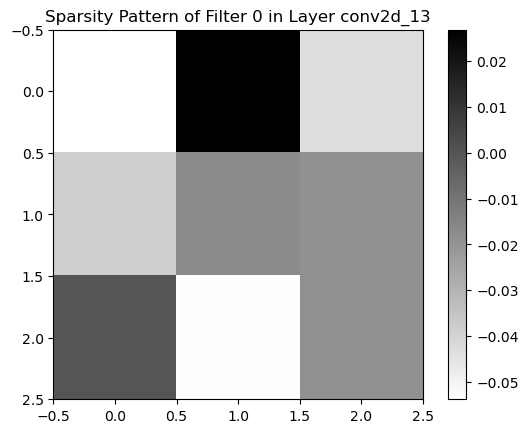

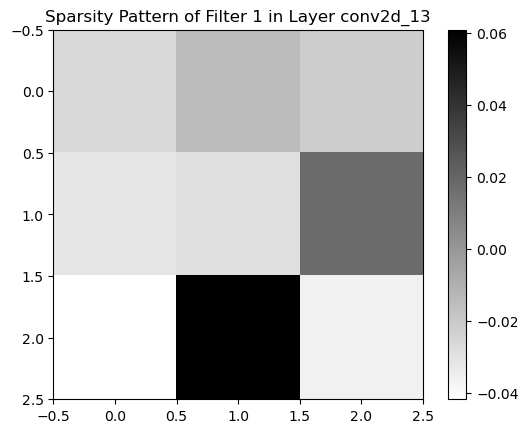

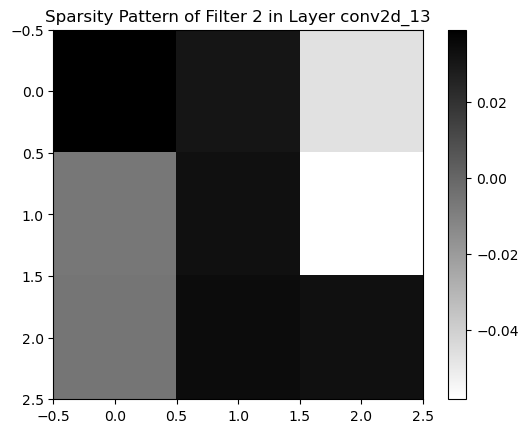

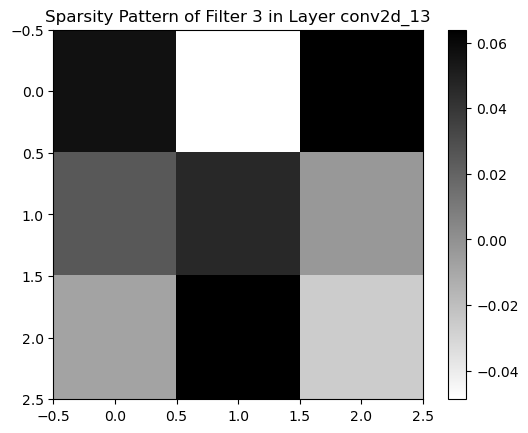

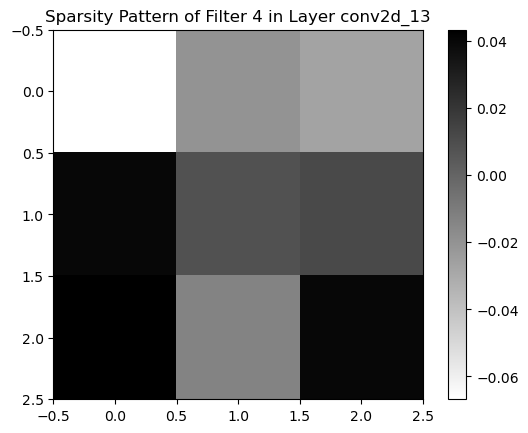

...

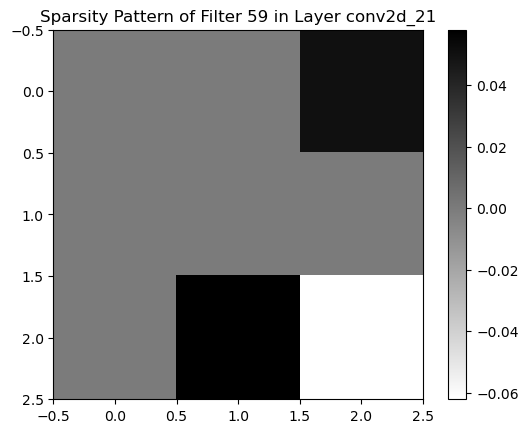

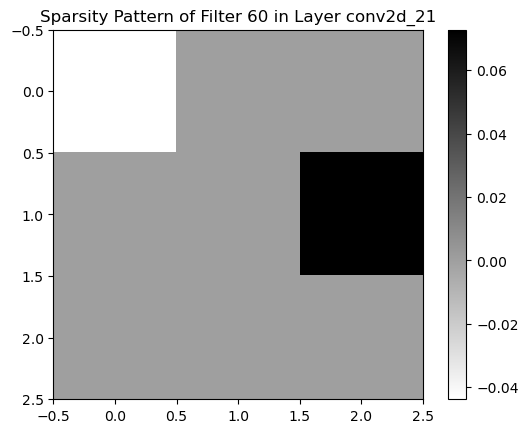

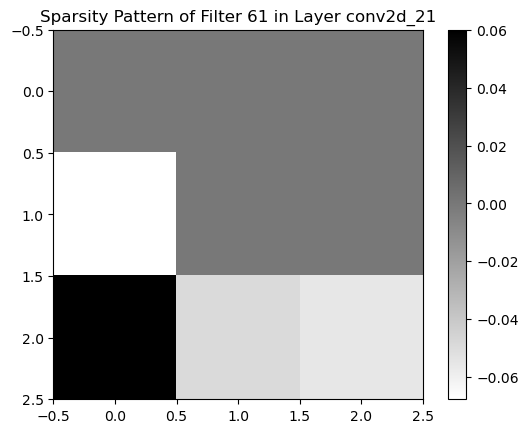

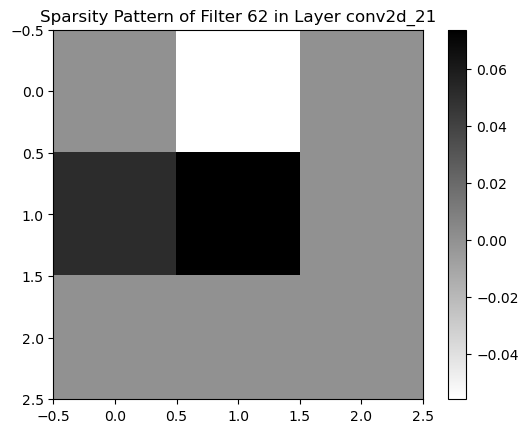

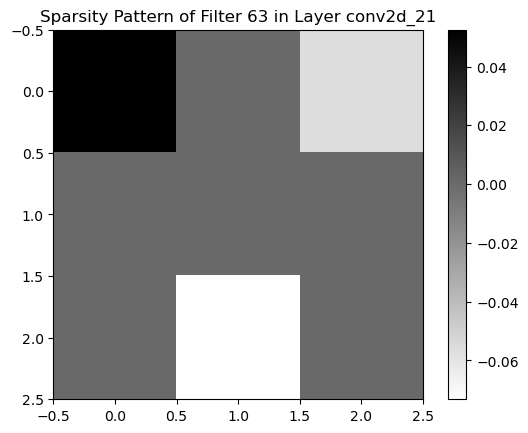

Layer batch_normalization_5 is not a Conv2D or Dense layer.
Layer dropout_3 is not a Conv2D or Dense layer.


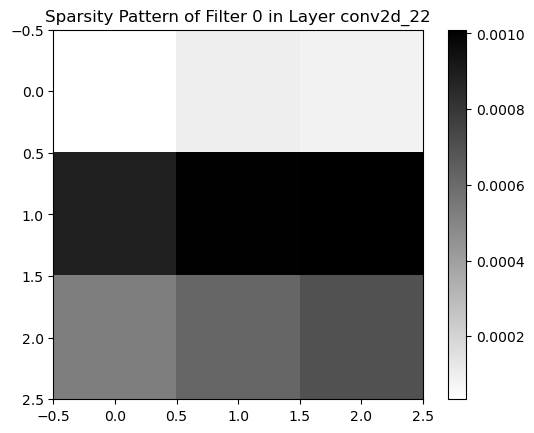

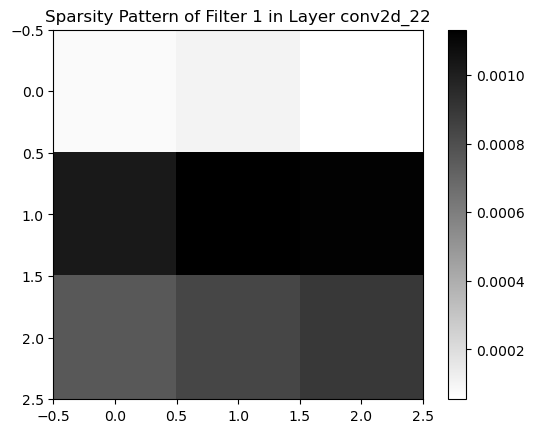

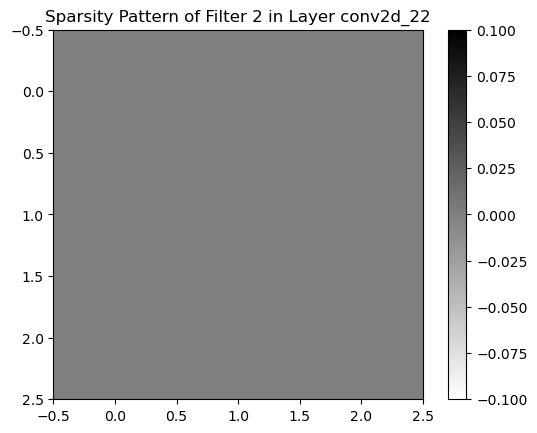

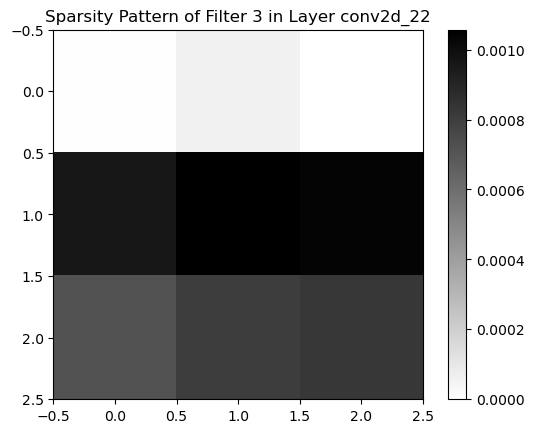

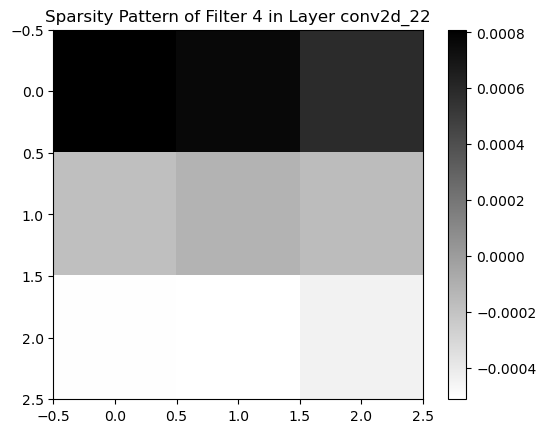

...

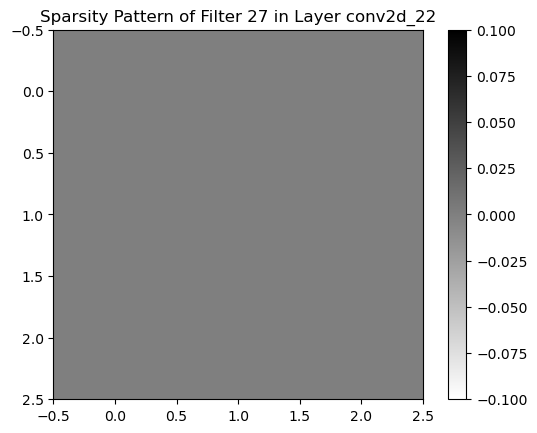

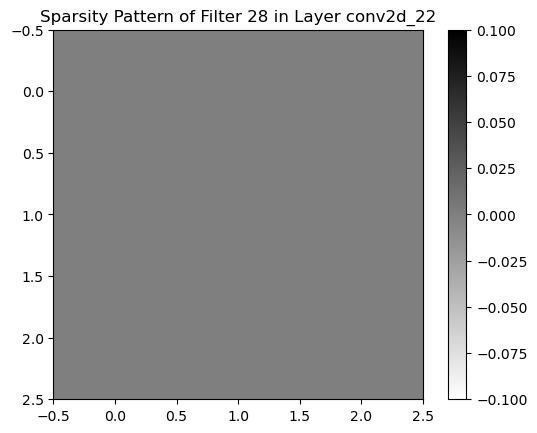

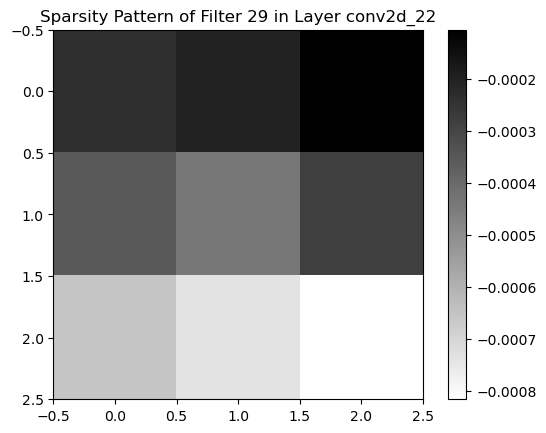

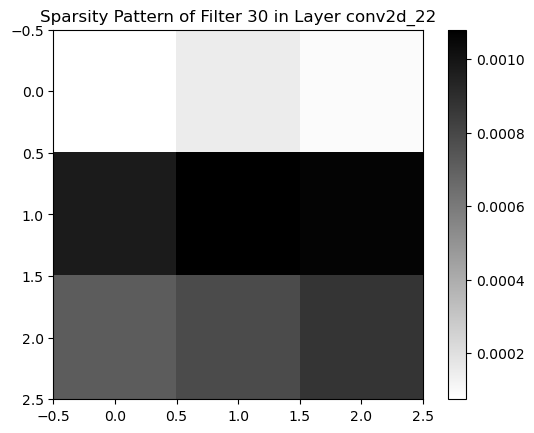

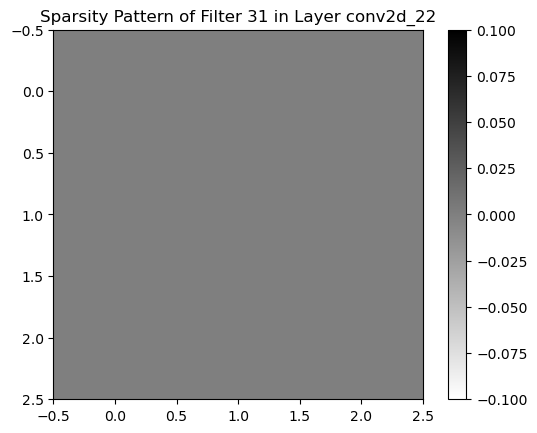

Layer batch_normalization_6 is not a Conv2D or Dense layer.


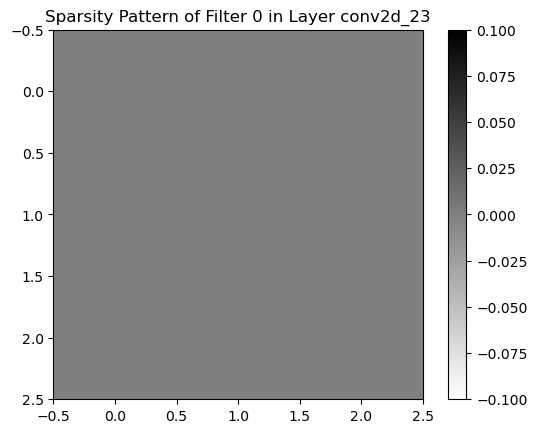

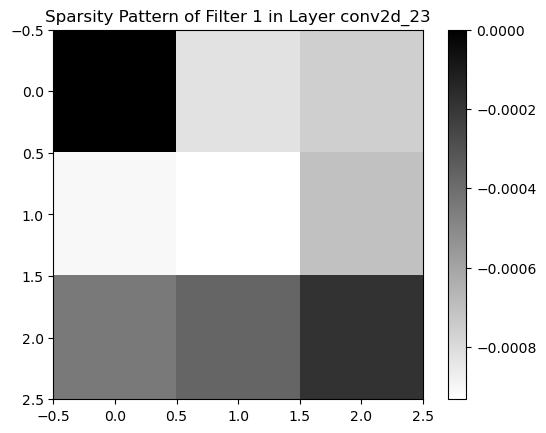

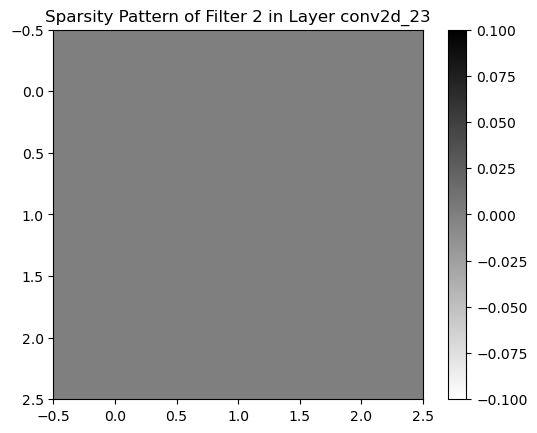

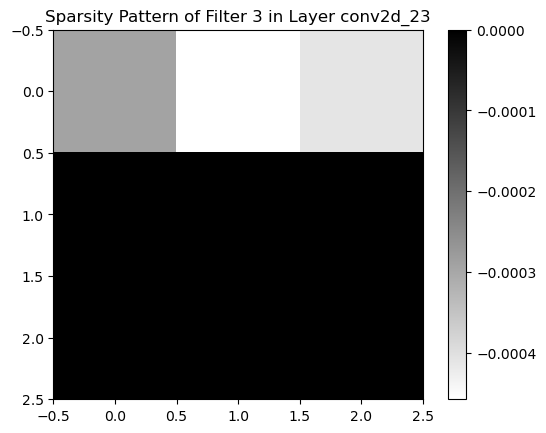

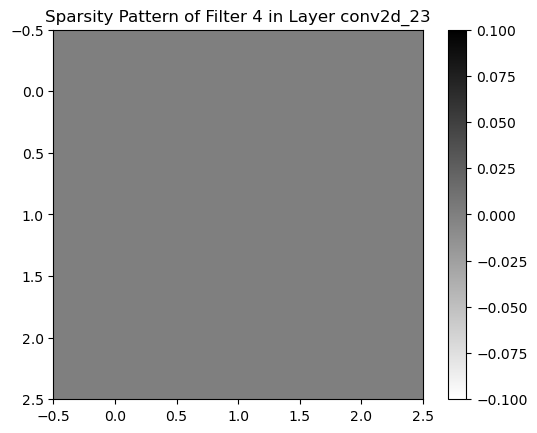

...

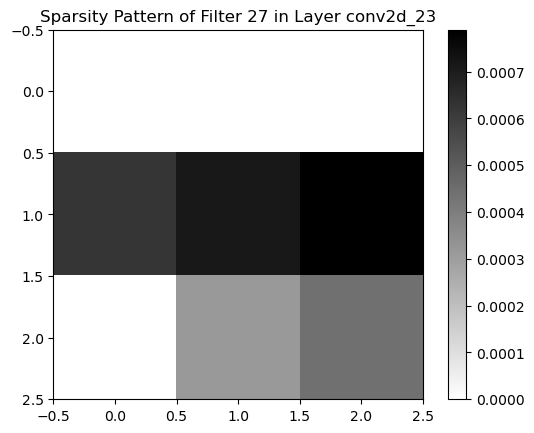

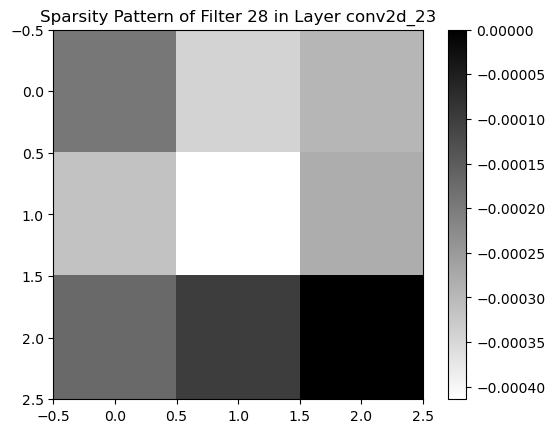

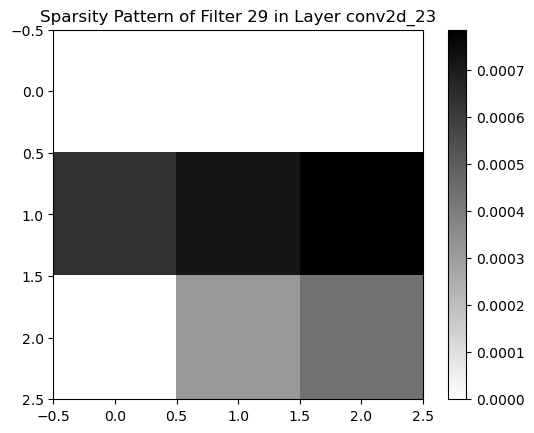

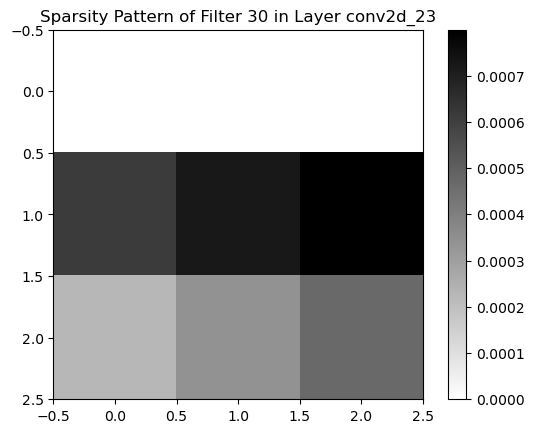

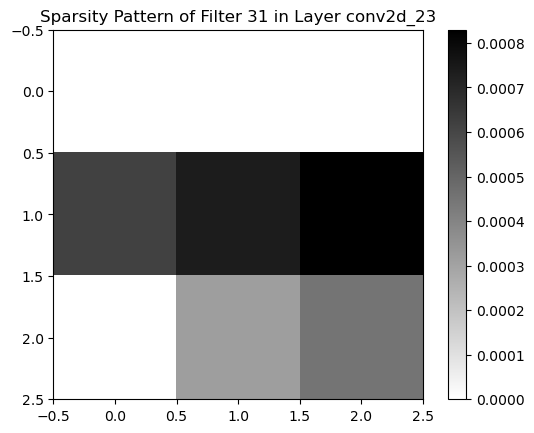

Layer batch_normalization_7 is not a Conv2D or Dense layer.


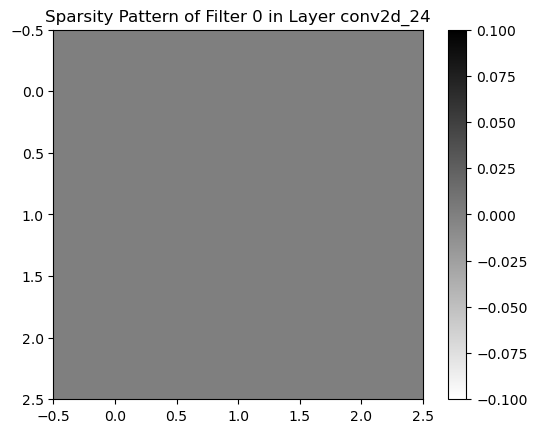

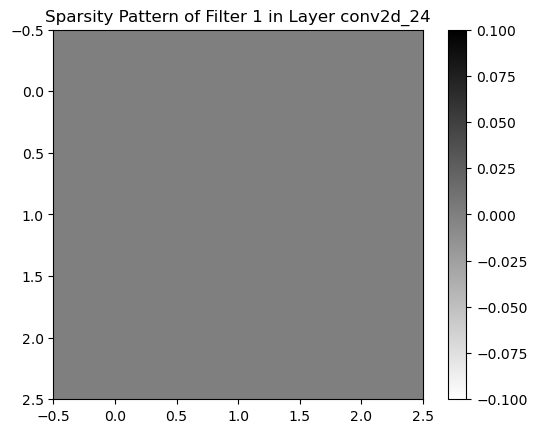

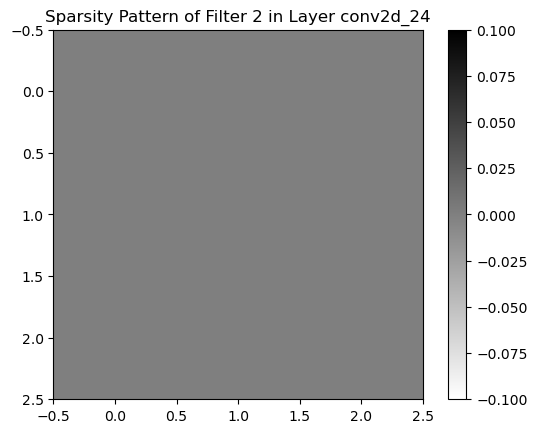

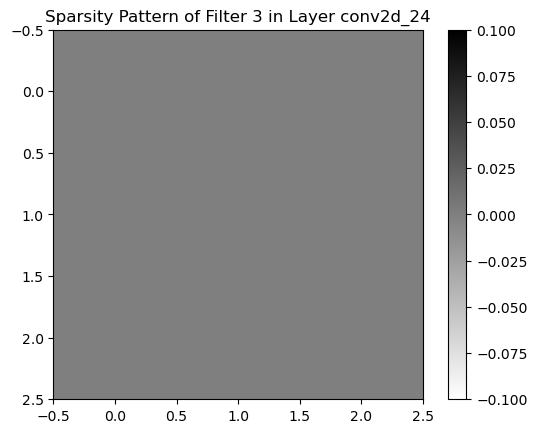

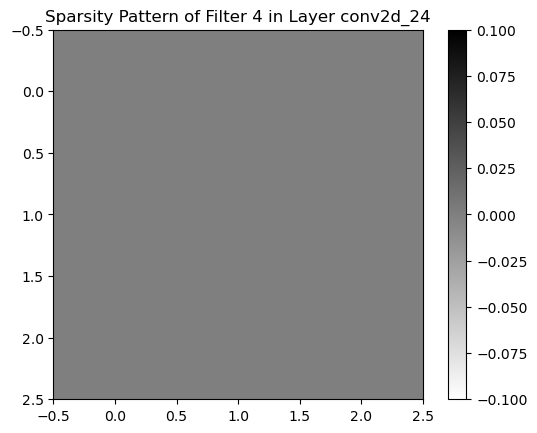

...

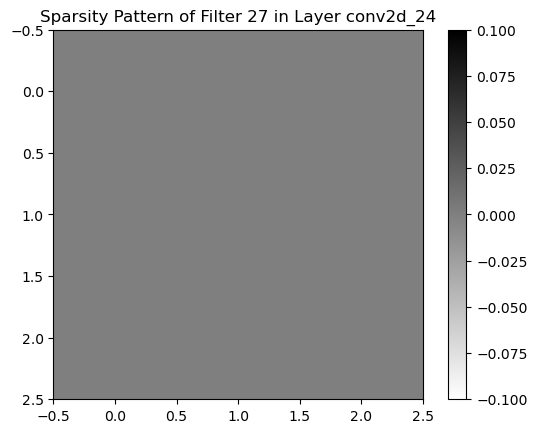

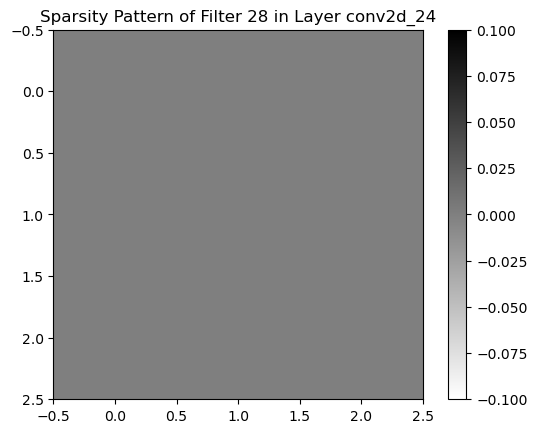

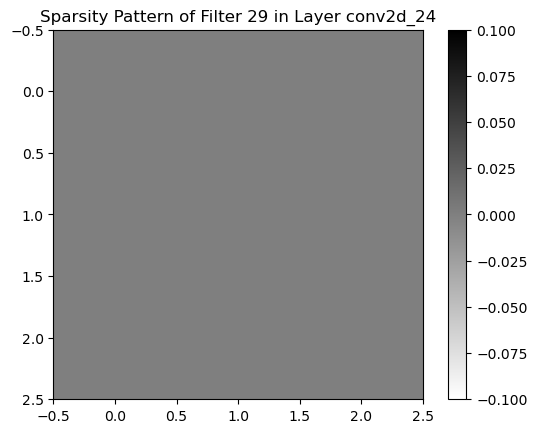

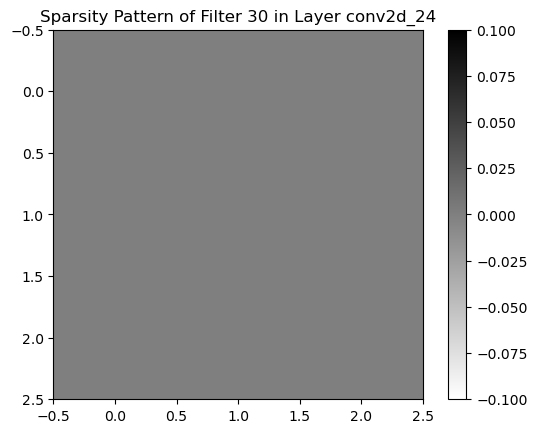

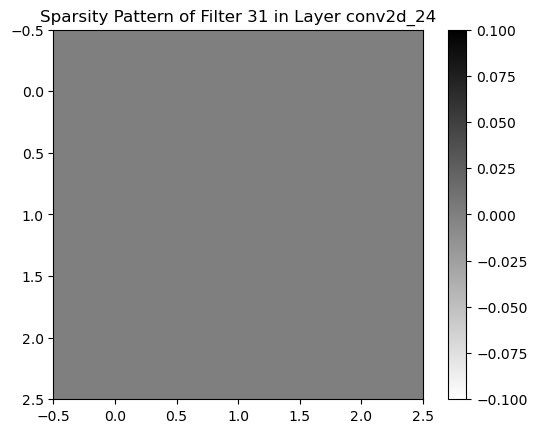

Layer batch_normalization_8 is not a Conv2D or Dense layer.


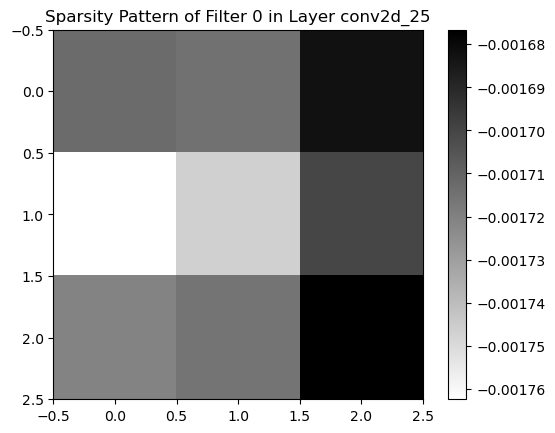

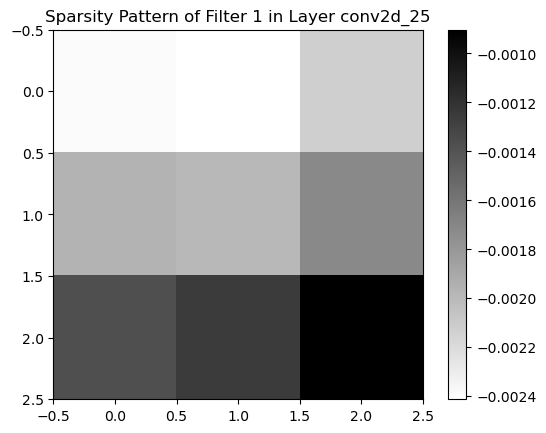

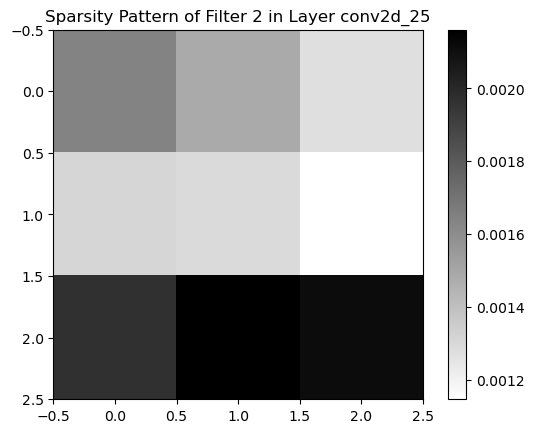

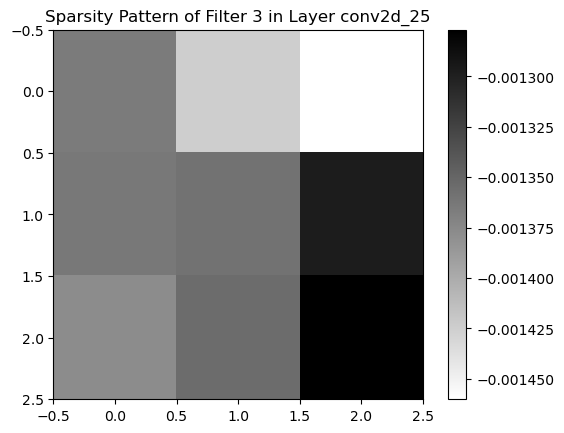

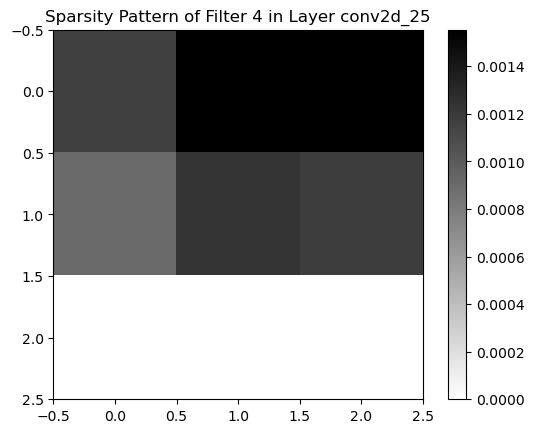

...

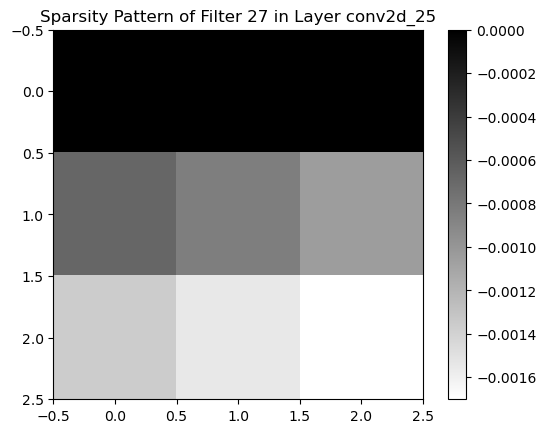

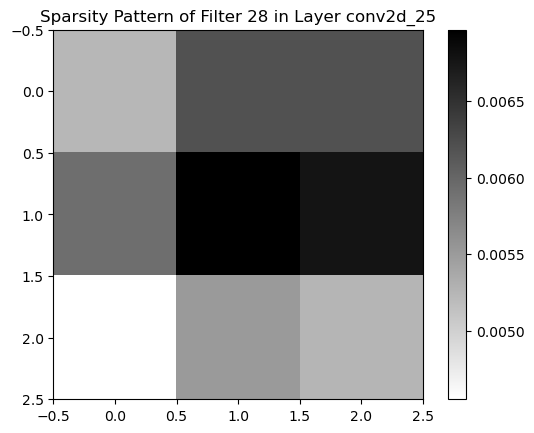

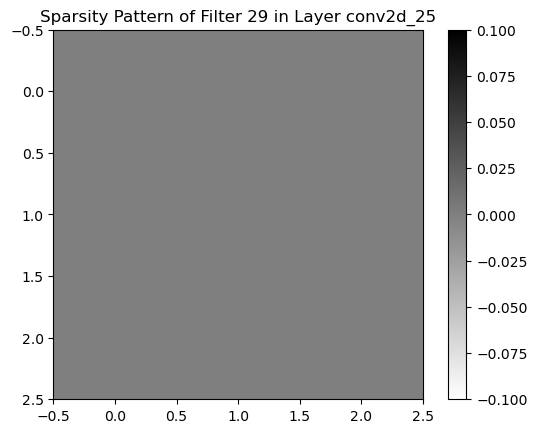

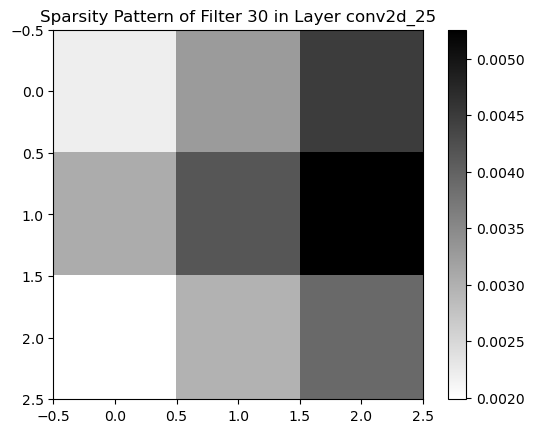

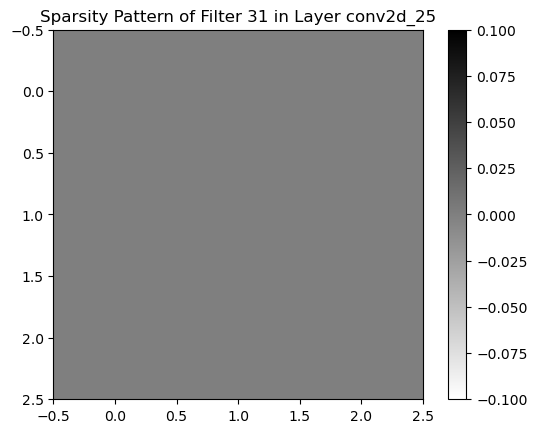

Layer batch_normalization_9 is not a Conv2D or Dense layer.
Layer dropout_4 is not a Conv2D or Dense layer.
Layer flatten_1 is not a Conv2D or Dense layer.


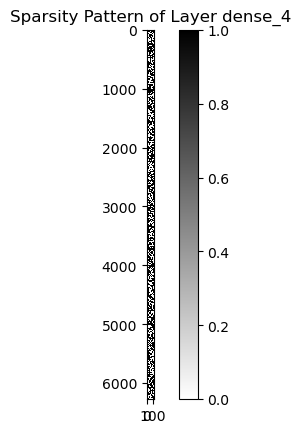

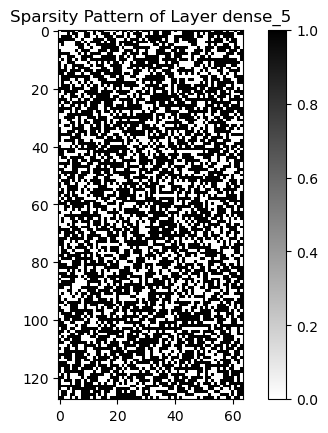

Layer dropout_5 is not a Conv2D or Dense layer.


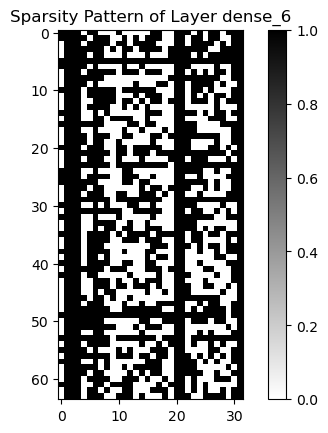

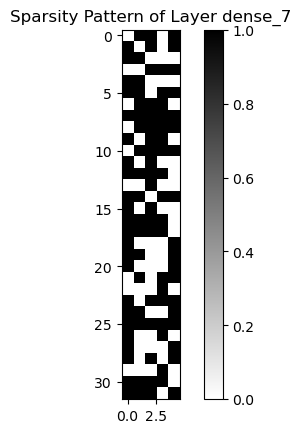

In [21]:
# Print sparsity patterns of each layer
for layer in model_for_export.layers:
    if isinstance(layer, tf.keras.layers.Conv2D) or isinstance(layer, tf.keras.layers.Dense):
        weights = layer.get_weights()
        if len(weights) > 0:
            weight_array = weights[0]  # Assuming weights are stored in the first element
            sparsity = np.mean(weight_array == 0)  # Calculate sparsity
            print(f"Layer {layer.name}: Sparsity = {sparsity}")
            
# Define a function to visualize the sparsity pattern of a layer
def visualize_sparsity(layer):
    if isinstance(layer, tf.keras.layers.Conv2D) or isinstance(layer, tf.keras.layers.Dense):
        weights = layer.get_weights()
        if len(weights) > 0:
            weight_array = weights[0]  # Assuming weights are stored in the first element
            if len(weight_array.shape) == 4:
                # Reshape the weight array to (num_filters, filter_height, filter_width, input_channels)
                weight_array = np.moveaxis(weight_array, -1, 0)  # Move the last dimension to the first
                num_filters = weight_array.shape[0]
                for i in range(num_filters):
                    plt.figure()
                    plt.imshow(weight_array[i, :, :, 0], cmap='binary', interpolation='nearest')
                    plt.title(f"Sparsity Pattern of Filter {i} in Layer {layer.name}")
                    plt.colorbar()
                    plt.show()
            else:
                plt.figure()
                plt.imshow(weight_array == 0, cmap='binary', interpolation='nearest')
                plt.title(f"Sparsity Pattern of Layer {layer.name}")
                plt.colorbar()
                plt.show()
    else:
        print(f"Layer {layer.name} is not a Conv2D or Dense layer.")

# Visualize sparsity patterns of each layer
for layer in model_for_export.layers:
    visualize_sparsity(layer)

In [6]:
# Checking the number of parameters (non zero) in the model after pruning

# Load the pruned model
with keras.utils.custom_object_scope({'pearson_r2': pearson_r2}):
    pruned_model = load_model('HCM_CNN_model_rand_big_pruned.h5')


# Initialize count
non_zero_weights_count = 0
zero_weights_count = 0

# Iterate through the layers of the model
for layer in pruned_model.layers:
        weights = layer.get_weights()
        for weight in weights:
        # Count zero and non-zero elements
            zero_weights_count += tf.reduce_sum(tf.cast(tf.equal(weight, 0), tf.int32)).numpy()
            non_zero_weights_count += tf.math.count_nonzero(weight).numpy()

print("Number of weights equal to zero in the pruned model:", zero_weights_count)
print("Number of non-zero weights in the pruned model:", non_zero_weights_count)

# Perform masking to remove zero weights
for layer in pruned_model.layers:
    if isinstance(layer, tf.keras.layers.Conv2D) or isinstance(layer, tf.keras.layers.Dense):
        mask = layer.get_weights()[0] != 0  # Get mask for non-zero weights
        pruned_weights = layer.get_weights()[0] * mask  # Apply mask to retain non-zero weights
        layer.set_weights([pruned_weights, layer.get_weights()[1]])  # Set updated weights

# Save the updated model without pruned weights
pruned_model.save('updated_model.h5')

# Load the pruned model
with keras.utils.custom_object_scope({'pearson_r2': pearson_r2}):
    pruned_model = load_model('HCM_CNN_model_rand_big_pruned.h5')

# Define a function to create a new model with non-zero weights
def create_model_with_non_zero_weights(pruned_model):
    new_model = tf.keras.Sequential()
    
    # Iterate through the layers of the pruned model
    for layer in pruned_model.layers:
        print(f"Processing layer {layer.name}")
        # Check if the layer has trainable weights
        if layer.trainable:
            # Copy the non-zero weights from the pruned model to the new layer
            new_weights = []
            for weight in layer.get_weights():
                if tf.reduce_sum(tf.abs(weight)) > 0:
                    new_weights.append(weight)
            
            # Set the weights of the new layer if there are non-zero weights
            if new_weights:
                # Create a new layer with the appropriate configuration based on the original layer
                if isinstance(layer, tf.keras.layers.Conv2D):
                    new_layer = tf.keras.layers.Conv2D(filters=new_weights[0].shape[-1], 
                                                       kernel_size=layer.kernel_size, 
                                                       strides=layer.strides, 
                                                       padding=layer.padding, 
                                                       activation=layer.activation)
                elif isinstance(layer, tf.keras.layers.Dense):
                    new_layer = tf.keras.layers.Dense(units=new_weights[0].shape[-1], 
                                                       activation=layer.activation)
                elif isinstance(layer, tf.keras.layers.BatchNormalization):
                    new_layer = tf.keras.layers.BatchNormalization()
                elif isinstance(layer, tf.keras.layers.Dropout):
                    new_layer = tf.keras.layers.Dropout(rate=layer.rate)
                else:
                    raise ValueError("Unsupported layer type")
                
                # Add the new layer to the new model
                new_model.add(new_layer)
                
                # Build the new layer with the input shape from the original layer
                new_layer.build(layer.input_shape)
                
                # Set the weights of the new layer
                new_layer.set_weights(new_weights)
            else:
                print(f"Skipping layer {layer.name} due to no non-zero weights")
        else:
            # Add non-trainable layers directly to the new model
            new_model.add(layer)
    
    return new_model

# Create a new model with non-zero weights
new_model = create_model_with_non_zero_weights(pruned_model)

# Build the new model
new_model.build((None, 40, 40, 14))

# Save the new model
new_model.save('pruned_model_without_zeros.h5')

# Load the original model
with keras.utils.custom_object_scope({'pearson_r2': pearson_r2}):
    original_model = load_model('HCM_CNN_model_rand.h5')
# Check the structure of the original model
print("Original Model Summary:")
original_model.summary()

# Check the structure of the pruned model
print("Pruned Model Summary:")
pruned_model.summary()

# Initialize count
non_zero_weights_count = 0
zero_weights_count = 0

# Iterate through the layers of the model
for layer in pruned_model.layers:
        weights = layer.get_weights()
        for weight in weights:
        # Count zero and non-zero elements
            zero_weights_count += tf.reduce_sum(tf.cast(tf.equal(weight, 0), tf.int32)).numpy()
            non_zero_weights_count += tf.math.count_nonzero(weight).numpy()

print("Number of weights equal to zero in the pruned model:", zero_weights_count)
print("Number of non-zero weights in the pruned model:", non_zero_weights_count)

# Initialize count
non_zero_weights_count = 0
zero_weights_count = 0

# Iterate through the layers of the model
for layer in original_model.layers:
        weights = layer.get_weights()
        for weight in weights:
        # Count zero and non-zero elements
            zero_weights_count += tf.reduce_sum(tf.cast(tf.equal(weight, 0), tf.int32)).numpy()
            non_zero_weights_count += tf.math.count_nonzero(weight).numpy()

print("Number of weights equal to zero in the original model:", zero_weights_count)
print("Number of non-zero weights in the original model:", non_zero_weights_count)

# Initialize count
non_zero_weights_count = 0
zero_weights_count = 0

# Iterate through the layers of the model
for layer in new_model.layers:
        weights = layer.get_weights()
        for weight in weights:
        # Count zero and non-zero elements
            zero_weights_count += tf.reduce_sum(tf.cast(tf.equal(weight, 0), tf.int32)).numpy()
            non_zero_weights_count += tf.math.count_nonzero(weight).numpy()

print("Number of weights equal to zero in the new model:", zero_weights_count)
print("Number of non-zero weights in the new model:", non_zero_weights_count)



Number of weights equal to zero in the pruned model: 714641
Number of non-zero weights in the pruned model: 494324


D:\Anaconda\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Processing layer conv2d_13
Processing layer conv2d_14
Processing layer conv2d_15
Processing layer conv2d_16
Processing layer conv2d_17
Processing layer conv2d_18
Processing layer conv2d_19
Processing layer conv2d_20
Processing layer conv2d_21
Processing layer batch_normalization_5
Processing layer dropout_3
Skipping layer dropout_3 due to no non-zero weights
Processing layer conv2d_22
Processing layer batch_normalization_6
Processing layer conv2d_23
Processing layer batch_normalization_7
Processing layer conv2d_24
Processing layer batch_normalization_8
Processing layer conv2d_25
Processing layer batch_normalization_9
Processing layer dropout_4
Skipping layer dropout_4 due to no non-zero weights
Processing layer flatten_1
Skipping layer flatten_1 due to no non-zero weights
Processing layer dense_4
Processing layer dense_5
Processing layer dropout_5
Skipping layer dropout_5 due to no non-zero weights
Processing layer dense_6
Processing layer dense_7
Original Model Summary:
Model: "sequen

 conv2d_25 (Conv2D)          (None, 14, 14, 32)        9248      
                                                                 
 batch_normalization_9 (Bat  (None, 14, 14, 32)        128       
 chNormalization)                                                
                                                                 
 dropout_4 (Dropout)         (None, 14, 14, 32)        0         
                                                                 
 flatten_1 (Flatten)         (None, 6272)              0         
                                                                 
 dense_4 (Dense)             (None, 128)               802944    
                                                                 
 dense_5 (Dense)             (None, 64)                8256      
                                                                 
 dropout_5 (Dropout)         (None, 64)                0         
                                                                 
 dense_6 (

In [9]:
# Load the pruned model
with keras.utils.custom_object_scope({'pearson_r2': pearson_r2}):
    pruned_model = load_model('HCM_CNN_model_rand.h5')  #HCM_CNN_model_rand_big_pruned.h5

converter = tf.lite.TFLiteConverter.from_keras_model ( pruned_model )
pruned_keras_file_path = "HCM_CNN_model_rand_big_pruned.h5"
pruned_tflite_model = converter.convert()

pruned_tflite_file = 'HCM_CNN_model_rand_pruned_TFLITE.tflite'
open(pruned_tflite_file, "wb").write(pruned_tflite_model)



print("Size of gzipped Original Model:")
convert_bytes(get_gzipped_model_size('HCM_CNN_model_rand_big.h5'),"MB")
print("Size of gzipped pruned model with stripping in h5:")
convert_bytes(get_gzipped_model_size(pruned_keras_file_path),"MB")
print("Size of gzipped pruned model with stripping in TFLITE:")
convert_bytes(get_gzipped_model_size(pruned_tflite_file),"MB")

INFO:tensorflow:Assets written to: C:\Users\Hamdy\AppData\Local\Temp\tmpqftgfez9\assets


INFO:tensorflow:Assets written to: C:\Users\Hamdy\AppData\Local\Temp\tmpqftgfez9\assets


Size of gzipped Original Model:
File size: 12.901 Megabytes
Size of gzipped pruned model with stripping in h5:
File size: 2.226 Megabytes
Size of gzipped pruned model with stripping in TFLITE:
File size: 0.273 Megabytes


In [11]:
# Model to TFLite and test for degredation (28/2/2023)

ACC_DATA = False
interpreter = tf.lite.Interpreter(model_path = pruned_tflite_file)
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()
print("Input Shape:", input_details[0]['shape'])
print("Input Type:", input_details[0]['dtype'])
print("Output Shape:", output_details[0]['shape'])
print("Output Type:", output_details[0]['dtype'])

# RESIZE INPUT AND OUTPUT TO HAVE ALL DATA IN ONE TRIAL
if (ACC_DATA == True):
    interpreter.resize_tensor_input(input_details[0]['index'], (627, 40, 40, 14))
else:
    interpreter.resize_tensor_input(input_details[0]['index'], (627, 20, 20, 14))
    
interpreter.resize_tensor_input(output_details[0]['index'], (627, 5))
interpreter.allocate_tensors()
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()
print("Input Shape:", input_details[0]['shape'])
print("Input Type:", input_details[0]['dtype'])
print("Output Shape:", output_details[0]['shape'])
print("Output Type:", output_details[0]['dtype'])


Input Shape: [ 1 20 20 14]
Input Type: <class 'numpy.float32'>
Output Shape: [1 5]
Output Type: <class 'numpy.float32'>
Input Shape: [627  20  20  14]
Input Type: <class 'numpy.float32'>
Output Shape: [627   5]
Output Type: <class 'numpy.float32'>


Prediction results shape: (627, 5)
Prediction results R2: 0.8135956967498433
Prediction results RMSE: 0.11642678


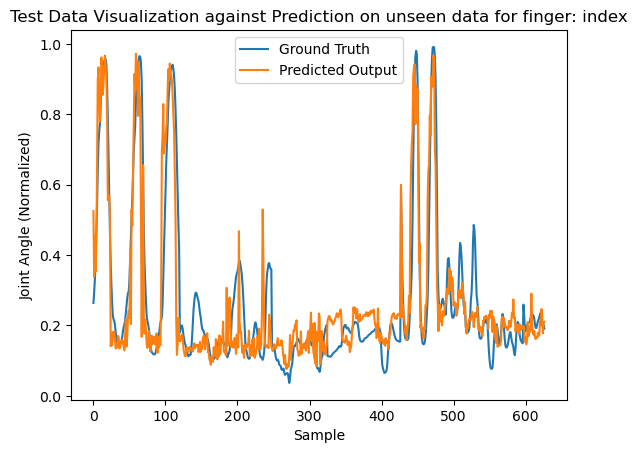

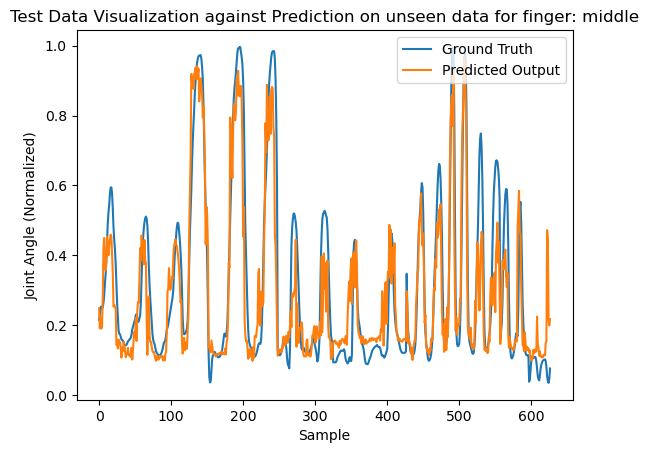

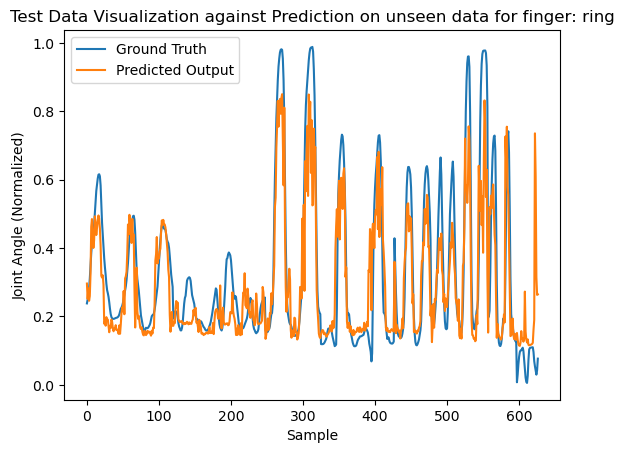

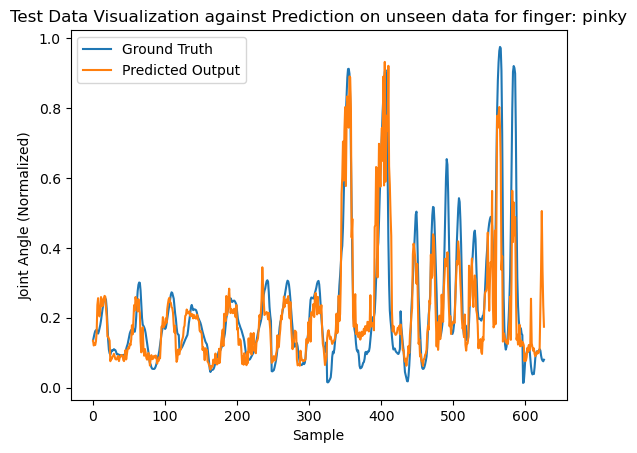

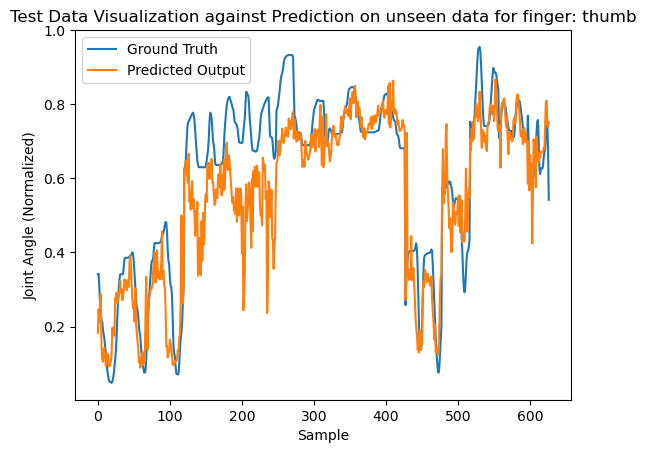

In [12]:
all_inputs, test_inputs = HCM_split_data(*S2T4_EMG_3D_SET_optimized, *S2T5_EMG_3D_SET_optimized, percentage = 0.83)
all_outputs, test_outputs = HCM_split_data(*S2T4_KIN_NORM_SET, *S2T5_KIN_NORM_SET, percentage = 0.83)



test_imgs_numpy = np.array(test_inputs, dtype=np.float32)

# Test the model in TFLITE
interpreter.set_tensor(input_details[0]['index'], test_imgs_numpy)
interpreter.invoke()
tflite_model_predictions = interpreter.get_tensor(output_details[0]['index'])
print("Prediction results shape:", tflite_model_predictions.shape)

test_prediction = tflite_model_predictions
ground_truth = np.array(test_outputs, dtype=np.float32)

print("Prediction results R2:",pearson_r2_evaluate(ground_truth, test_prediction))
print("Prediction results RMSE:",rmse(ground_truth, test_prediction))

prediction_sample = 0
finger_to_plot = 0

for i in range(5):
    finger_to_plot = i

    if (finger_to_plot == 0):
        finger = 'index'
    elif (finger_to_plot == 1):
        finger = 'middle'
    elif (finger_to_plot == 2):
        finger = 'ring'
    elif (finger_to_plot == 3):
        finger = 'pinky'
    elif (finger_to_plot == 4):
        finger = 'thumb'
    
    
        
    plt.figure()
    plt.plot(ground_truth[:,finger_to_plot])
    plt.plot(test_prediction[:,finger_to_plot])
    plt.title("Test Data Visualization against Prediction on unseen data for finger: "+finger)
    plt.xlabel('Sample')
    plt.ylabel('Joint Angle (Normalized)')
    plt.legend(labels= ['Ground Truth', 'Predicted Output'], loc='best')
    plt.show()

In [33]:
def representative_dataset_generator():
    # Iterate over the samples in your representative data
    for sample in np.array(test_inputs, dtype=np.float32):
        # Yield each sample as a batch
        yield [sample.reshape(1, *sample.shape)]

In [34]:
# Perform Full Model Quantization to be Compatible with Microcontrollers

# load pruned model
with keras.utils.custom_object_scope({'pearson_r2': pearson_r2}):
    pruned_model = load_model('HCM_CNN_model_rand.h5')    #HCM_CNN_model_rand_big_pruned.h5
    
# load Representative data for Full Quantization
all_inputs, test_inputs = HCM_split_data(*S2T4_EMG_3D_SET_optimized, *S2T5_EMG_3D_SET_optimized, percentage = 0.83)
all_outputs, test_outputs = HCM_split_data(*S2T4_KIN_NORM_SET, *S2T5_KIN_NORM_SET, percentage = 0.83)
X_train, X_test, y_train, y_test = train_test_split(all_inputs, all_outputs, test_size=0.3)

TF_LITE_SIZE_QUANT_MODEL_FILE_NAME = "tf_lite_quant_model_pruned.tflite"

tf_lite_converter = tf.lite.TFLiteConverter.from_keras_model(pruned_model)
tf_lite_converter.optimizations = [
    #tf.lite.Optimize.EXPERIMENTAL_SPARSITY,  # Enables size reduction optimization. 
    tf.lite.Optimize.DEFAULT                 # Enables quantization at conversion.
]

tf_lite_converter.representative_dataset = representative_dataset_generator
tf_lite_converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS_INT8]
tf_lite_converter.inference_input_type = tf.int8  # or tf.uint8
tf_lite_converter.inference_output_type = tf.int8  # or tf.uint8

#input_details = interpreter.get_input_details()
#output_details = interpreter.get_output_details()
#print("Input Shape:", input_details[0]['shape'])
#print("Input Type:", input_details[0]['dtype'])
#print("Output Shape:", output_details[0]['shape'])
#print("Output Type:", output_details[0]['dtype'])
#
tflite_model = tf_lite_converter.convert()

tflite_model_name = TF_LITE_SIZE_QUANT_MODEL_FILE_NAME
open(tflite_model_name, "wb").write(tflite_model)
convert_bytes(get_gzipped_model_size(TF_LITE_SIZE_QUANT_MODEL_FILE_NAME), "KB")

INFO:tensorflow:Assets written to: C:\Users\Hamdy\AppData\Local\Temp\tmpy3u960oy\assets


INFO:tensorflow:Assets written to: C:\Users\Hamdy\AppData\Local\Temp\tmpy3u960oy\assets
D:\Anaconda\anaconda3\Lib\site-packages\tensorflow\lite\python\convert.py:953: UserWarning: Statistics for quantized inputs were expected, but not specified; continuing anyway.
  warnings.warn(


File size: 72.616 Kilobytes


Input Shape: [ 1 40 40 14]
Input Type: <class 'numpy.int8'>
Output Shape: [1 5]
Output Type: <class 'numpy.int8'>
Input Shape: [627  40  40  14]
Input Type: <class 'numpy.int8'>
Output Shape: [627   5]
Output Type: <class 'numpy.int8'>
Prediction results shape: (627, 5)
Prediction results R2: 0.0
[[[[6.23556446e-02 8.78543584e-03 2.90222382e-02 ... 3.13131190e-02
    5.25457031e-02 1.66121670e-01]
   [1.85185176e-01 9.67742445e-02 2.85714419e-01 ... 1.24999975e-01
    6.66666739e-01 9.37499962e-01]
   [2.66666623e-01 2.14285814e-01 4.99999728e-01 ... 1.87499911e-01
    3.33333515e-01 2.85714419e-01]
   ...
   [1.85185176e-01 9.67742445e-02 2.85714419e-01 ... 1.24999975e-01
    6.66666739e-01 9.37499962e-01]
   [2.66666623e-01 2.14285814e-01 4.99999728e-01 ... 1.87499911e-01
    3.33333515e-01 2.85714419e-01]
   [8.57142924e-01 7.14285581e-01 6.15384577e-01 ... 7.33333377e-01
    4.00000261e-01 2.49999949e-01]]

  [[6.01863546e-02 1.16334634e-01 3.31844630e-02 ... 2.52220521e-04
    1.1

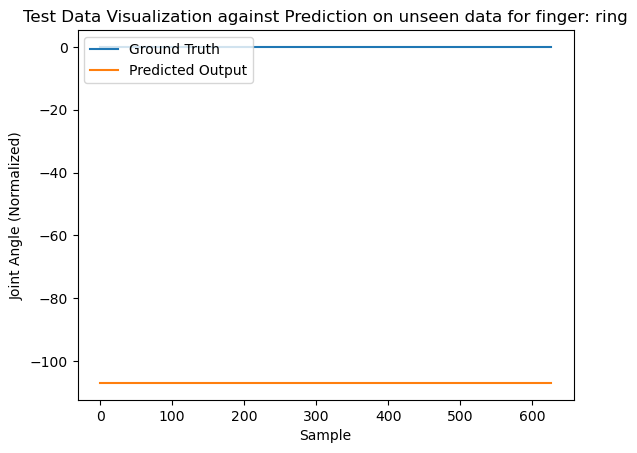

In [74]:
interpreter = tf.lite.Interpreter(model_path = TF_LITE_SIZE_QUANT_MODEL_FILE_NAME)
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()
print("Input Shape:", input_details[0]['shape'])
print("Input Type:", input_details[0]['dtype'])
print("Output Shape:", output_details[0]['shape'])
print("Output Type:", output_details[0]['dtype'])

# RESIZE INPUT AND OUTPUT TO HAVE ALL DATA IN ONE TRIAL
if (ACC_DATA == True):
    interpreter.resize_tensor_input(input_details[0]['index'], (627, 40, 40, 14))
else:
    interpreter.resize_tensor_input(input_details[0]['index'], (627, 20, 20, 14))
    
interpreter.resize_tensor_input(output_details[0]['index'], (627, 5))
interpreter.allocate_tensors()
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()
print("Input Shape:", input_details[0]['shape'])
print("Input Type:", input_details[0]['dtype'])
print("Output Shape:", output_details[0]['shape'])
print("Output Type:", output_details[0]['dtype'])


test_imgs_numpy = np.array(test_inputs, dtype=np.int8)

interpreter.set_tensor(input_details[0]['index'], test_imgs_numpy)
interpreter.invoke()
tflite_model_predictions = interpreter.get_tensor(output_details[0]['index'])
print("Prediction results shape:", tflite_model_predictions.shape)

test_prediction = tflite_model_predictions
ground_truth = np.array(test_outputs, dtype=np.int8)

print("Prediction results R2:",pearson_r2_evaluate(ground_truth, test_prediction))

prediction_sample = 0
finger_to_plot = 2

if (finger_to_plot == 0):
    finger = 'index'
elif (finger_to_plot == 1):
    finger = 'middle'
elif (finger_to_plot == 2):
    finger = 'ring'
elif (finger_to_plot == 3):
    finger = 'pinky'
elif (finger_to_plot == 4):
    finger = 'thumb'

print(test_inputs)
print("....................")
print(test_imgs_numpy)
    
plt.figure()
plt.plot(ground_truth[:,finger_to_plot])
plt.plot(test_prediction[:,finger_to_plot])
plt.title("Test Data Visualization against Prediction on unseen data for finger: "+finger)
plt.xlabel('Sample')
plt.ylabel('Joint Angle (Normalized)')
plt.legend(labels= ['Ground Truth', 'Predicted Output'], loc='upper left')
plt.show()


In [75]:
# From TFLITE to C
from tensorflow.lite.python.util import convert_bytes_to_c_source

source_text, header_text = convert_bytes_to_c_source(tflite_model,  "cnn_model")

with  open('cnn_model.h',  'w')  as  file:
    file.write(header_text)

with  open('cnn_model.cc',  'w')  as  file:
    file.write(source_text)

## NinaPro DB8 Dataset Testing

In [2]:
# Reading Data
mat1A = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 1/S1_E1_A1.mat')
mat2A = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 1/S2_E1_A1.mat')
mat3A = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 1/S3_E1_A1.mat')
mat4A = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 1/S4_E1_A1.mat')
#mat5A = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 1/S5_E1_A1.mat')
mat6A = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 1/S6_E1_A1.mat')
mat7A = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 1/S7_E1_A1.mat')
mat8A = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 1/S8_E1_A1.mat')
mat9A = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 1/S9_E1_A1.mat')
mat10A = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 1/S10_E1_A1.mat')

mat1B = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 2/S1_E1_A2.mat')
mat2B = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 2/S2_E1_A2.mat')
mat3B = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 2/S3_E1_A2.mat')
mat4B = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 2/S4_E1_A2.mat')
#mat5B = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 2/S5_E1_A2.mat')
mat6B = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 2/S6_E1_A2.mat')
mat7B = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 2/S7_E1_A2.mat')
mat8B = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 2/S8_E1_A2.mat')
mat9B = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 2/S9_E1_A2.mat')
mat10B = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 2/S10_E1_A2.mat')

mat1C = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 3/S1_E1_A3.mat')
mat2C = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 3/S2_E1_A3.mat')
mat3C = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 3/S3_E1_A3.mat')
mat4C = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 3/S4_E1_A3.mat')
#mat5C = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 3/S5_E1_A3.mat')
mat6C = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 3/S6_E1_A3.mat')
mat7C = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 3/S7_E1_A3.mat')
mat8C = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 3/S8_E1_A3.mat')
mat9C = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 3/S9_E1_A3.mat')
mat10C = scipy.io.loadmat('../10- Kinematics Extraction/NinaPro DB8/Trial 3/S10_E1_A3.mat')


In [3]:
# Preparing Dataset on all available files
DB8_emg_samples_3D, DB8_normalized_kinematics_samples = HCM_NinaProDB8_PIPELINE(mat1A, mat2A, mat3A, mat4A, mat6A, 
                                                                                mat7A, mat8A, mat9A, mat10A)
                                                                                #mat1B, mat2B, mat3B, mat4B, mat5B, 
                                                                                #mat6B, mat7B, mat8B, mat9B, mat10B)

#val_DB8_emg_samples_3D, val_DB8_normalized_kinematics_samples = HCM_NinaProDB8_PIPELINE(mat1C) #mat2C, mat3C, mat4C, mat5C, 
                                                                                        #mat6C, mat7C, mat8C, mat9C, mat10C)

started file number:  1
EMG Data shape after window splitting is:
(11461, 400, 4, 16)
Kinmatics Data shape after window splitting is:
(11461, 5)
Finished normalizing Kinematics Data for finger given data
started file number:  2
EMG Data shape after window splitting is:
(11388, 400, 4, 16)
Kinmatics Data shape after window splitting is:
(11388, 5)
Finished normalizing Kinematics Data for finger given data
started file number:  3
EMG Data shape after window splitting is:
(11347, 400, 4, 16)
Kinmatics Data shape after window splitting is:
(11347, 5)
Finished normalizing Kinematics Data for finger given data
started file number:  4
EMG Data shape after window splitting is:
(11351, 400, 4, 16)
Kinmatics Data shape after window splitting is:
(11351, 5)
Finished normalizing Kinematics Data for finger given data
started file number:  5
EMG Data shape after window splitting is:
(11403, 400, 4, 16)
Kinmatics Data shape after window splitting is:
(11403, 5)
Finished normalizing Kinematics Data fo

In [4]:
# Extracting Data
DB8_EMG_Data = mat1A["emg"] # shape (samples, EMG Channel)
DB8_ACC_Data = mat1A["acc"] # shape (samples, ACC Channel)
DB8_ALL_Kinematics_Data = mat1A["glove"] # shape (samples, Joint Angle)


# Rearrange Data to be in the form of (samples, sensor, channel) where sensors are [EMG, ACCx, ACCy, ACCz]
# Reshape var1 to have shape (samples, 16, 1)
var1_reshaped = DB8_EMG_Data[..., np.newaxis]

# Reshape var2 to have shape (samples, 16, 3)
var2_reshaped = DB8_ACC_Data.reshape(DB8_ACC_Data.shape[0], DB8_EMG_Data.shape[1], 3)

# Concatenate var1 and var2 along the last axis
combined = np.concatenate([var1_reshaped, var2_reshaped], axis=2)

# Transpose the combined array to have shape (samples, 4, 16)
DB8_input_Data = np.transpose(combined, (0, 2, 1))

print("Input Shape is: ")
print(DB8_input_Data.shape)  # (samples, 4, 16)

######################### Kinematics Extraction ###############################
finger_indices = [5, 7, 10, 13, 1] # Corresponding to [index, middle, ring, pinky, thumb] pip
DB8_output_Data = DB8_ALL_Kinematics_Data[:, finger_indices]

print("Output Shape is: ")
print(DB8_output_Data.shape)  # (samples, 5)


Input Shape is: 
(2292526, 4, 16)
Output Shape is: 
(2292526, 5)


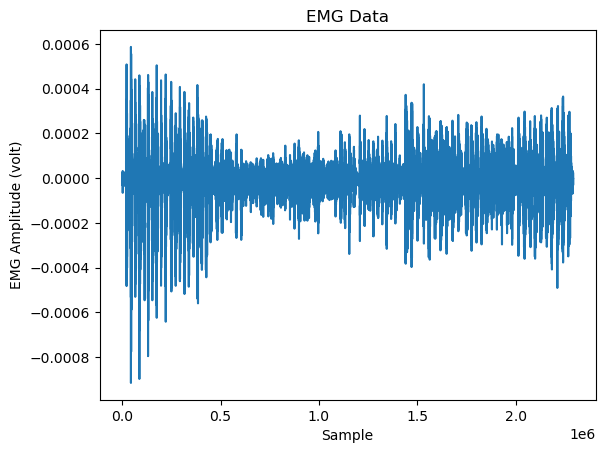

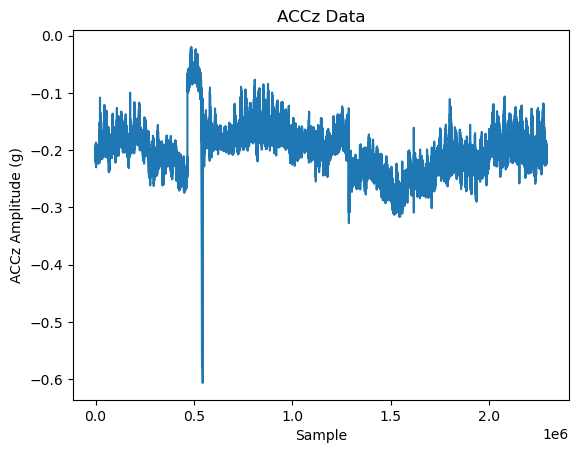

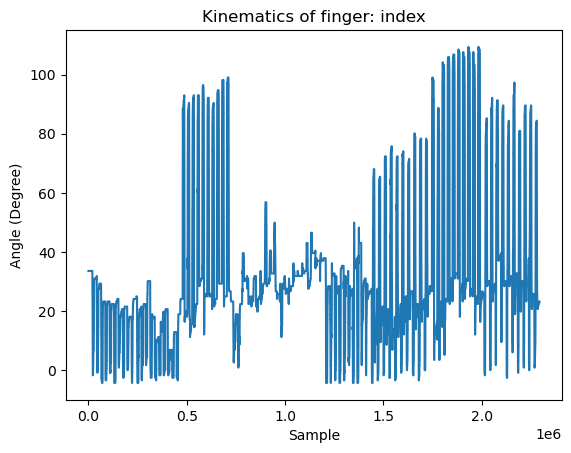

In [5]:
# Plotting data for validation

#plotting EMG data
plt.figure()
plt.plot(DB8_input_Data[:, 0, 0])
plt.title("EMG Data")
plt.xlabel('Sample')
plt.ylabel('EMG Amplitude (volt)')
#plt.legend(labels= [1,2,3,4,5,6,7], loc='upper right')
plt.show()

#plotting ACCx data
plt.figure()
plt.plot(DB8_input_Data[:, 3, 0])
plt.title("ACCz Data")
plt.xlabel('Sample')
plt.ylabel('ACCz Amplitude (g)')
plt.show()

#plotting Kinematics Data
finger_to_plot = 0

if (finger_to_plot == 0):
    finger = 'index'
elif (finger_to_plot == 1):
    finger = 'middle'
elif (finger_to_plot == 2):
    finger = 'ring'
elif (finger_to_plot == 3):
    finger = 'pinky'
elif (finger_to_plot == 4):
    finger = 'thumb'
    
plt.figure()
plt.plot(DB8_output_Data[:, finger_to_plot])
plt.title("Kinematics of finger: "+finger)
plt.xlabel('Sample')
plt.ylabel('Angle (Degree)')
plt.show()

In [6]:
# Dataset Creation (Pipeline)

# Calculating the minimum and maximum values for each channel in the whole EMG data set to be used in normalization (Do this for ACC too)
# Output will be shaped like (4*12) for each variable to represent EMG, ACCx, ACCy, ACCz, and the 12 channels
DB8_EMG_data_min, DB8_EMG_data_max = HCM_get_Min_Max(DB8_input_Data)
    
# Calculating the minimum and maximum values for each joint in the whole Kinematics data set to be used in normalization
DB8_joint_data_min, DB8_joint_data_max = HCM_get_Min_Max(DB8_output_Data)

# Normalizing Input Data
DB8_normalized_EMG_Data = HCM_normalize_EMG_data(DB8_input_Data, DB8_EMG_data_min, DB8_EMG_data_max, normalization_range="[-1,1]")

# Prepare dataset trials by sizing windows of EMG and averaged Kinematics data.
DB8_emg_samples, DB8_kinematics_samples, DB8_EMG_per_trial = HCM_Create_Dataset(DB8_normalized_EMG_Data, DB8_output_Data,
                                                                    emg_sampling_rate = 2000,
                                                                    kinematics_sampling_rate = 2000,
                                                                    window_duration_sec = 0.2,
                                                                    window_overlap_percentage=50,
                                                                    ACC_Data = True)
        
# Shape EMG data into 3D images if needed
DB8_emg_samples_3D = HCM_reshape_trials_to_3d(DB8_emg_samples, rows=20, thickness=20, ACC_Data = True)
print("EMG Data shape for CNN training is:")
print(DB8_emg_samples_3D.shape)

print("Kinematic Data shape for CNN training is:")
print(DB8_kinematics_samples.shape)
        
# Normalize Joint Angles to have better training results
DB8_normalized_kinematics_samples = HCM_normalize_joint_angles(DB8_kinematics_samples, DB8_joint_data_min, DB8_joint_data_max)
print("Finished normalizing Kinematics Data for finger given data")
        

EMG Data shape after window splitting is:
(11461, 400, 4, 16)
Kinmatics Data shape after window splitting is:
(11461, 5)
EMG Data shape for CNN training is:
(11461, 40, 40, 16)
Kinematic Data shape for CNN training is:
(11461, 5)
Finished normalizing Kinematics Data for finger given data


In [ ]:
# CNN Model for Proportional Control

# Step 1: Build the model

# Building CNN Model
model = models.Sequential()
model.add(layers.Conv2D(128, (3, 3), activation='relu', input_shape=(40, 40, 16)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(tf.keras.layers.BatchNormalization())

model.add(layers.Dropout(0.4))
model.add(layers.Conv2D(32, (3, 3), activation='relu', kernel_regularizer=l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())
model.add(layers.Conv2D(32, (3, 3), activation='relu', kernel_regularizer=l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())
model.add(layers.Conv2D(32, (3, 3), activation='relu', kernel_regularizer=l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())
model.add(layers.Conv2D(32, (3, 3), activation='relu', kernel_regularizer=l2(0.01)))
model.add(tf.keras.layers.BatchNormalization())


model.add(layers.Dropout(0.4))
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dense(64, activation='relu'))
model.add(layers.Dropout(0.2))
model.add(layers.Dense(32, activation='relu', kernel_regularizer=l2(0.01)))
model.add(layers.Dense(5, activation='linear')) #leaky_relu

model.summary()


# Step 2: Prepare the data Training and Validation Sets

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(DB8_emg_samples_3D, DB8_normalized_kinematics_samples, test_size=0.3)

#X_train = DB8_emg_samples_3D
#X_test  = val_DB8_emg_samples_3D
#y_train = DB8_normalized_kinematics_samples
#y_test  = val_DB8_normalized_kinematics_samples

#X_train, X_test = HCM_split_data(DB8_emg_samples_3D)
#y_train, y_test = HCM_split_data(DB8_normalized_kinematics_samples)

# Print the shapes to verify
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)
print("X_test shape:", X_test.shape)
print("y_test shape:", y_test.shape)

# Uncomment the following code if you want to load a previously trained model to train it
## Load the model
#with keras.utils.custom_object_scope({'pearson_r2': pearson_r2}):
#    model = load_model('DB8_HCM_CNN_model.h5')

#Step 3: Train the model

# X_train, y_train represent your training data and labels

# Compile the model
opt = keras.optimizers.Adam(learning_rate = 0.001)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=20, min_lr=0.00000001)
ES_callback = EarlyStopping(monitor='val_loss', patience=50)

model.compile(optimizer=opt, loss=keras.losses.MeanSquaredError(), 
              metrics=pearson_r2)#[tf.keras.metrics.MeanAbsolutePercentageError()])


# Define the checkpoint filepath
checkpoint_filepath = "DB8_HCM_CNN_model_all_data1.h5"

# Define the ModelCheckpoint callback
checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,  # Filepath to save the checkpoint
    monitor='val_loss',        # Quantity to monitor for saving the model
    save_best_only=True,           # Save only the best models
    save_weights_only=False,        # Save only the model's weights
    mode='min',                    # 'max' for accuracy, 'min' for loss, etc.
    verbose=1                      # Verbosity level: 0 or 1
)



# Train the model
CNN_specs = model.fit(X_train, y_train, epochs=100, shuffle = True, 
                              batch_size=128, validation_data=(X_test, y_test), callbacks=[reduce_lr, ES_callback, checkpoint_callback])




Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 38, 38, 128)       18560     
                                                                 
 conv2d_1 (Conv2D)           (None, 36, 36, 64)        73792     
                                                                 
 conv2d_2 (Conv2D)           (None, 34, 34, 64)        36928     
                                                                 
 conv2d_3 (Conv2D)           (None, 32, 32, 64)        36928     
                                                                 
 conv2d_4 (Conv2D)           (None, 30, 30, 64)        36928     
                                                                 
 conv2d_5 (Conv2D)           (None, 28, 28, 64)        36928     
                                                                 
 conv2d_6 (Conv2D)           (None, 26, 26, 64)       

C:\Users\Hamdy\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


559/559 [==============================] - ETA: 0s - loss: 0.0595 - pearson_r2: 0.4544
Epoch 2: val_loss improved from 0.14528 to 0.03669, saving model to DB8_HCM_CNN_model_all_data1.h5
559/559 [==============================] - 234s 418ms/step - loss: 0.0595 - pearson_r2: 0.4544 - val_loss: 0.0367 - val_pearson_r2: 0.5287 - lr: 0.0010
Epoch 3/1000
559/559 [==============================] - ETA: 0s - loss: 0.0294 - pearson_r2: 0.5593
Epoch 3: val_loss improved from 0.03669 to 0.03482, saving model to DB8_HCM_CNN_model_all_data1.h5
559/559 [==============================] - 246s 441ms/step - loss: 0.0294 - pearson_r2: 0.5593 - val_loss: 0.0348 - val_pearson_r2: 0.5203 - lr: 0.0010
Epoch 4/1000
559/559 [==============================] - ETA: 0s - loss: 0.0249 - pearson_r2: 0.6057
Epoch 4: val_loss improved from 0.03482 to 0.02442, saving model to DB8_HCM_CNN_model_all_data1.h5
559/559 [==============================] - 250s 447ms/step - loss: 0.0249 - pearson_r2: 0.6057 - val_loss: 0.024

Epoch 28/1000
559/559 [==============================] - ETA: 0s - loss: 0.0073 - pearson_r2: 0.8836
Epoch 28: val_loss improved from 0.00849 to 0.00778, saving model to DB8_HCM_CNN_model_all_data1.h5
559/559 [==============================] - 232s 415ms/step - loss: 0.0073 - pearson_r2: 0.8836 - val_loss: 0.0078 - val_pearson_r2: 0.8906 - lr: 0.0010
Epoch 29/1000
559/559 [==============================] - ETA: 0s - loss: 0.0069 - pearson_r2: 0.8917
Epoch 29: val_loss did not improve from 0.00778
559/559 [==============================] - 231s 413ms/step - loss: 0.0069 - pearson_r2: 0.8917 - val_loss: 0.0124 - val_pearson_r2: 0.8737 - lr: 0.0010
Epoch 30/1000
559/559 [==============================] - ETA: 0s - loss: 0.0071 - pearson_r2: 0.8890
Epoch 30: val_loss did not improve from 0.00778
559/559 [==============================] - 231s 414ms/step - loss: 0.0071 - pearson_r2: 0.8890 - val_loss: 0.0093 - val_pearson_r2: 0.8678 - lr: 0.0010
Epoch 31/1000
559/559 [======================

Epoch 55/1000
559/559 [==============================] - ETA: 0s - loss: 0.0049 - pearson_r2: 0.9235
Epoch 55: val_loss did not improve from 0.00622
559/559 [==============================] - 228s 408ms/step - loss: 0.0049 - pearson_r2: 0.9235 - val_loss: 0.0161 - val_pearson_r2: 0.7688 - lr: 0.0010
Epoch 56/1000
559/559 [==============================] - ETA: 0s - loss: 0.0047 - pearson_r2: 0.9268
Epoch 56: val_loss did not improve from 0.00622
559/559 [==============================] - 230s 411ms/step - loss: 0.0047 - pearson_r2: 0.9268 - val_loss: 0.0134 - val_pearson_r2: 0.8276 - lr: 0.0010
Epoch 57/1000
559/559 [==============================] - ETA: 0s - loss: 0.0048 - pearson_r2: 0.9258
Epoch 57: val_loss did not improve from 0.00622
559/559 [==============================] - 231s 413ms/step - loss: 0.0048 - pearson_r2: 0.9258 - val_loss: 0.0068 - val_pearson_r2: 0.9205 - lr: 0.0010
Epoch 58/1000
559/559 [==============================] - ETA: 0s - loss: 0.0045 - pearson_r2: 0.9

Epoch 82/1000
559/559 [==============================] - ETA: 0s - loss: 0.0038 - pearson_r2: 0.9412
Epoch 82: val_loss did not improve from 0.00556
559/559 [==============================] - 230s 412ms/step - loss: 0.0038 - pearson_r2: 0.9412 - val_loss: 0.0076 - val_pearson_r2: 0.9024 - lr: 0.0010
Epoch 83/1000
559/559 [==============================] - ETA: 0s - loss: 0.0038 - pearson_r2: 0.9410
Epoch 83: val_loss did not improve from 0.00556
559/559 [==============================] - 235s 421ms/step - loss: 0.0038 - pearson_r2: 0.9410 - val_loss: 0.0067 - val_pearson_r2: 0.9157 - lr: 0.0010
Epoch 84/1000
559/559 [==============================] - ETA: 0s - loss: 0.0038 - pearson_r2: 0.9414
Epoch 84: val_loss did not improve from 0.00556
559/559 [==============================] - 230s 412ms/step - loss: 0.0038 - pearson_r2: 0.9414 - val_loss: 0.0118 - val_pearson_r2: 0.8856 - lr: 0.0010
Epoch 85/1000
559/559 [==============================] - ETA: 0s - loss: 0.0037 - pearson_r2: 0.9

Epoch 109/1000
559/559 [==============================] - ETA: 0s - loss: 0.0034 - pearson_r2: 0.9478
Epoch 109: val_loss did not improve from 0.00452
559/559 [==============================] - 231s 413ms/step - loss: 0.0034 - pearson_r2: 0.9478 - val_loss: 0.0109 - val_pearson_r2: 0.9009 - lr: 0.0010
Epoch 110/1000
559/559 [==============================] - ETA: 0s - loss: 0.0032 - pearson_r2: 0.9508
Epoch 110: val_loss did not improve from 0.00452
559/559 [==============================] - 228s 407ms/step - loss: 0.0032 - pearson_r2: 0.9508 - val_loss: 0.0065 - val_pearson_r2: 0.9403 - lr: 0.0010
Epoch 111/1000
559/559 [==============================] - ETA: 0s - loss: 0.0034 - pearson_r2: 0.9485
Epoch 111: val_loss did not improve from 0.00452
559/559 [==============================] - 230s 412ms/step - loss: 0.0034 - pearson_r2: 0.9485 - val_loss: 0.0073 - val_pearson_r2: 0.9006 - lr: 0.0010
Epoch 112/1000
559/559 [==============================] - ETA: 0s - loss: 0.0035 - pearson_

Epoch 136/1000
559/559 [==============================] - ETA: 0s - loss: 0.0031 - pearson_r2: 0.9542
Epoch 136: val_loss did not improve from 0.00427
559/559 [==============================] - 227s 407ms/step - loss: 0.0031 - pearson_r2: 0.9542 - val_loss: 0.0057 - val_pearson_r2: 0.9416 - lr: 0.0010
Epoch 137/1000
559/559 [==============================] - ETA: 0s - loss: 0.0031 - pearson_r2: 0.9543
Epoch 137: val_loss did not improve from 0.00427
559/559 [==============================] - 229s 410ms/step - loss: 0.0031 - pearson_r2: 0.9543 - val_loss: 0.0049 - val_pearson_r2: 0.9346 - lr: 0.0010
Epoch 138/1000
559/559 [==============================] - ETA: 0s - loss: 0.0030 - pearson_r2: 0.9548
Epoch 138: val_loss did not improve from 0.00427
559/559 [==============================] - 230s 412ms/step - loss: 0.0030 - pearson_r2: 0.9548 - val_loss: 0.0071 - val_pearson_r2: 0.8985 - lr: 0.0010
Epoch 139/1000
559/559 [==============================] - ETA: 0s - loss: 0.0031 - pearson_

Epoch 163/1000
559/559 [==============================] - ETA: 0s - loss: 0.0028 - pearson_r2: 0.9578
Epoch 163: val_loss did not improve from 0.00422
559/559 [==============================] - 229s 410ms/step - loss: 0.0028 - pearson_r2: 0.9578 - val_loss: 0.0100 - val_pearson_r2: 0.8895 - lr: 0.0010
Epoch 164/1000
559/559 [==============================] - ETA: 0s - loss: 0.0029 - pearson_r2: 0.9577
Epoch 164: val_loss did not improve from 0.00422
559/559 [==============================] - 229s 409ms/step - loss: 0.0029 - pearson_r2: 0.9577 - val_loss: 0.0069 - val_pearson_r2: 0.9176 - lr: 0.0010
Epoch 165/1000
559/559 [==============================] - ETA: 0s - loss: 0.0029 - pearson_r2: 0.9577
Epoch 165: val_loss did not improve from 0.00422
559/559 [==============================] - 229s 410ms/step - loss: 0.0029 - pearson_r2: 0.9577 - val_loss: 0.0056 - val_pearson_r2: 0.9381 - lr: 0.0010
Epoch 166/1000
559/559 [==============================] - ETA: 0s - loss: 0.0029 - pearson_

Epoch 190/1000
559/559 [==============================] - ETA: 0s - loss: 0.0020 - pearson_r2: 0.9688
Epoch 190: val_loss did not improve from 0.00412
559/559 [==============================] - 231s 413ms/step - loss: 0.0020 - pearson_r2: 0.9688 - val_loss: 0.0045 - val_pearson_r2: 0.9489 - lr: 5.0000e-04
Epoch 191/1000
559/559 [==============================] - ETA: 0s - loss: 0.0020 - pearson_r2: 0.9692
Epoch 191: val_loss did not improve from 0.00412
559/559 [==============================] - 231s 413ms/step - loss: 0.0020 - pearson_r2: 0.9692 - val_loss: 0.0042 - val_pearson_r2: 0.9559 - lr: 5.0000e-04
Epoch 192/1000
559/559 [==============================] - ETA: 0s - loss: 0.0020 - pearson_r2: 0.9694
Epoch 192: val_loss did not improve from 0.00412
559/559 [==============================] - 230s 412ms/step - loss: 0.0020 - pearson_r2: 0.9694 - val_loss: 0.0067 - val_pearson_r2: 0.9423 - lr: 5.0000e-04
Epoch 193/1000
559/559 [==============================] - ETA: 0s - loss: 0.002

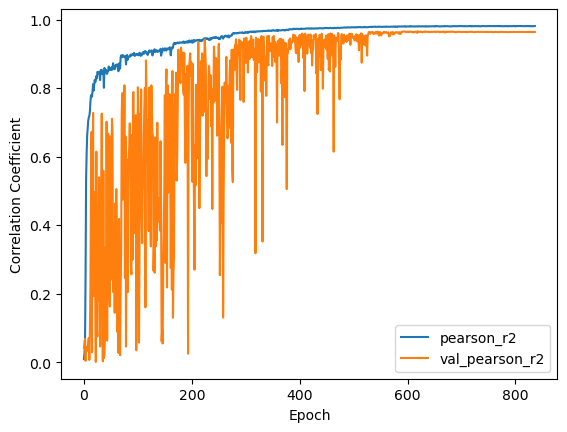

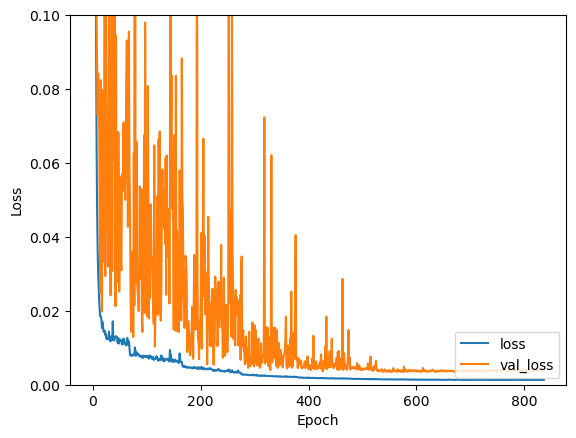

(3439, 40, 40, 16)
251/251 [==============================] - 6s 26ms/step
(3439, 5)
(3439, 5)


In [6]:
# Step 4: Evaluation and Predictions
# Evaluate the model
plt.clf()
plt.plot(CNN_specs.history['pearson_r2'], label='pearson_r2')
plt.plot(CNN_specs.history['val_pearson_r2'], label = 'val_pearson_r2')
plt.xlabel('Epoch')
plt.ylabel('Correlation Coefficient')
#plt.ylim([-0.1, 0.95])
plt.legend(loc='lower right')
plt.show()
plt.plot(CNN_specs.history['loss'], label='loss')
plt.plot(CNN_specs.history['val_loss'], label = 'val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.ylim([0, 0.1])
plt.legend(loc='lower right')
plt.show()

# Make a prediction on test data
prediction_data = X_test
print(prediction_data.shape)
prediction = model.predict(prediction_data)
prediction_of_training = model.predict(X_train)
# Prepare prediction data shape to compare with labels
print(prediction.shape)
print (y_test.shape)

Ground Truth for sample:  0 is  [0.28787874 0.26027398 0.33701786 0.19259259 0.43243242]
Prediction   for sample:  0 is  [0.2666344  0.20210066 0.26939756 0.14121804 0.3998968 ]


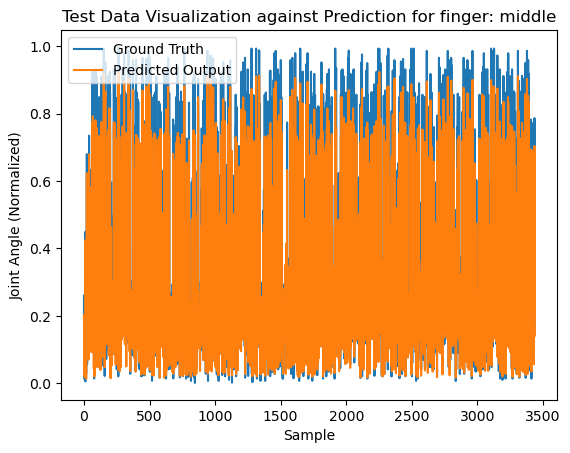

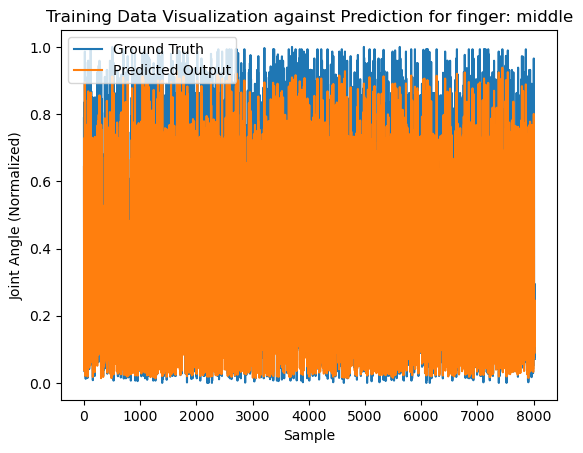

In [7]:
prediction_sample = 0
finger_to_plot = 1
print ("Ground Truth for sample: ", prediction_sample, "is ", y_test[prediction_sample])
print ("Prediction   for sample: ", prediction_sample, "is ",prediction[prediction_sample])

if (finger_to_plot == 0):
    finger = 'index'
elif (finger_to_plot == 1):
    finger = 'middle'
elif (finger_to_plot == 2):
    finger = 'ring'
elif (finger_to_plot == 3):
    finger = 'pinky'
elif (finger_to_plot == 4):
    finger = 'thumb'


    
plt.figure()
plt.plot(y_test[:,finger_to_plot])
plt.plot(prediction[:,finger_to_plot])
plt.title("Test Data Visualization against Prediction for finger: "+finger)
plt.xlabel('Sample')
plt.ylabel('Joint Angle (Normalized)')
plt.legend(labels= ['Ground Truth', 'Predicted Output'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_train[:,finger_to_plot])
plt.plot(prediction_of_training[:,finger_to_plot])
plt.title("Training Data Visualization against Prediction for finger: "+finger)
plt.xlabel('Sample')
plt.ylabel('Joint Angle (Normalized)')
plt.legend(labels= ['Ground Truth', 'Predicted Output'], loc='upper left')
plt.show()

## UJI Dataset Testing

In [ ]:
# Extracting Data
mat = scipy.io.loadmat('../10- Kinematics Extraction/kin_mus_uji data/ALL_DATA.mat')
UJI_EMG_Data = mat["EMG_data"] # shape (samples, EMG Channel)
UJI_ALL_Kinematics_Data = mat["kinematic_data"] # shape (samples, Joint Angle)


In [ ]:
# Validating Data

# Joints to use (4, 7, 9, 13, 2) corresponding to (index, middle, ring, pinky, thumb)
UJI_Index = UJI_ALL_Kinematics_Data[:,4].reshape(-1,1)
UJI_Middle = UJI_ALL_Kinematics_Data[:,7].reshape(-1,1)
UJI_Ring = UJI_ALL_Kinematics_Data[:,9].reshape(-1,1)
UJI_Pinky = UJI_ALL_Kinematics_Data[:,13].reshape(-1,1)
UJI_Thumb = UJI_ALL_Kinematics_Data[:,2].reshape(-1,1)
UJI_Kinematics_Data = np.concatenate([UJI_Index, UJI_Middle, UJI_Ring, UJI_Pinky, UJI_Thumb], axis = 1)
print(UJI_Kinematics_Data.shape)
# Checking minimum and maximum joint angle values 
UJI_Joint_data_min, UJI_Joint_data_max = HCM_get_Min_Max(UJI_Kinematics_Data)
print("minimum joint angle is: ", UJI_Joint_data_min," and maximum joint angle is: ",UJI_Joint_data_max)

#plotting EMG data
plt.figure()
plt.plot(UJI_EMG_Data)
plt.title("EMG Data")
plt.xlabel('Sample')
plt.ylabel('EMG Data (Normalized)')
plt.legend(labels= [1,2,3,4,5,6,7], loc='upper right')
plt.show()


In [ ]:
# Processing Dataset Frames and shaping

UJI_emg_samples, UJI_kinematics_samples, EMG_per_trial = HCM_Create_Dataset(UJI_EMG_Data, UJI_Kinematics_Data, 
                                                                            emg_sampling_rate = 100, 
                                                                            kinematics_sampling_rate = 100,
                                                                            window_duration_sec = 0.49, 
                                                                            window_overlap_percentage=50) 

UJI_emg_samples_3D = HCM_reshape_trials_to_3d(UJI_emg_samples, rows=7, thickness=7)

UJI_normalized_kinematics_samples = HCM_normalize_joint_angles(UJI_kinematics_samples, UJI_Joint_data_min, UJI_Joint_data_max)


In [ ]:
# CNN model
# CNN Model for Proportional Control

# Step 1: Build the model

# Building CNN Model
model = models.Sequential()
model.add(layers.Conv2D(128, (3, 3), activation='relu', input_shape=(7, 7, 7)))
#model.add(layers.MaxPooling2D((2, 2)))
#model.add(tf.keras.layers.BatchNormalization())
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
#model.add(layers.MaxPooling2D((2, 2)))
model.add(tf.keras.layers.BatchNormalization())

model.add(layers.Dropout(0.4))
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
#model.add(tf.keras.layers.BatchNormalization())
model.add(layers.Dense(64, activation='relu'))
#model.add(tf.keras.layers.BatchNormalization())
model.add(layers.Dropout(0.2))
model.add(layers.Dense(32, activation='relu', kernel_regularizer=l2(0.01)))
#model.add(tf.keras.layers.BatchNormalization())
#model.add(layers.Dropout(0.2))
model.add(layers.Dense(5, activation='linear'))

model.summary()


# Step 2: Prepare the data Training and Validation Sets

# Split the data into training and testing sets
X_train, X_test = HCM_split_data(UJI_emg_samples_3D, percentage = 0.70)#, emg_samples2_3D)
y_train, y_test = HCM_split_data(UJI_normalized_kinematics_samples
                                 , percentage = 0.70)#, kinematics_samples2[:,0]) 

# Print the shapes to verify
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)
print("X_test shape:", X_test.shape)
print("y_test shape:", y_test.shape)



#Step 3: Train the model

# X_train, y_train represent your training data and labels

# Compile the model
opt = keras.optimizers.Adam(learning_rate = 0.001)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=50, min_lr=0.00000001)
callback = EarlyStopping(monitor='val_loss', patience=200)

model.compile(optimizer=opt, loss=keras.losses.MeanSquaredError(), 
              metrics=pearson_r2)#[tf.keras.metrics.MeanAbsolutePercentageError()])

# Train the model
CNN_specs = model.fit(X_train, y_train, epochs=1000, shuffle = True, 
                              batch_size=128, validation_data=(X_test, y_test), callbacks=[reduce_lr, callback])


In [ ]:
# Step 4: Evaluation and Predictions
# Evaluate the model
plt.clf()
plt.plot(CNN_specs.history['pearson_r2'], label='pearson_r2')
plt.plot(CNN_specs.history['val_pearson_r2'], label = 'val_pearson_r2')
plt.xlabel('Epoch')
plt.ylabel('Correlation Coefficient')
#plt.ylim([-0.1, 0.95])
plt.legend(loc='lower right')
plt.show()
plt.plot(CNN_specs.history['loss'], label='loss')
plt.plot(CNN_specs.history['val_loss'], label = 'val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
#plt.ylim([60, 250])
plt.legend(loc='lower right')
plt.show()

# Make a prediction on test data
prediction_data = X_test
print(prediction_data.shape)
prediction = model.predict(prediction_data)
prediction_of_training = model.predict(X_train)
# Prepare prediction data shape to compare with labels
print(prediction.shape)
print (y_test.shape)

prediction_sample = 0
finger_to_plot = 2
print ("Ground Truth for sample: ", prediction_sample, "is ", y_test[prediction_sample])
print ("Prediction   for sample: ", prediction_sample, "is ",prediction[prediction_sample])

if (finger_to_plot == 0):
    finger = 'index'
elif (finger_to_plot == 1):
    finger = 'middle'
elif (finger_to_plot == 2):
    finger = 'ring'
elif (finger_to_plot == 3):
    finger = 'pinky'
elif (finger_to_plot == 4):
    finger = 'thumb'


    
plt.figure()
plt.plot(y_test[:,finger_to_plot])
plt.plot(prediction[:,finger_to_plot])
plt.title("Test Data Visualization against Prediction for finger: "+finger)
plt.xlabel('Sample')
plt.ylabel('Joint Angle (Normalized)')
plt.legend(labels= ['Ground Truth', 'Predicted Output'], loc='upper left')
plt.show()

plt.figure()
plt.plot(y_train[:,finger_to_plot])
plt.plot(prediction_of_training[:,finger_to_plot])
plt.title("Training Data Visualization against Prediction for finger: "+finger)
plt.xlabel('Sample')
plt.ylabel('Joint Angle (Normalized)')
plt.legend(labels= ['Ground Truth', 'Predicted Output'], loc='upper left')
plt.show()

In [ ]:
# Define the GRU-based model
model = Sequential()
model.add(GRU(128, input_shape=(None, 7), return_sequences=True))  # First GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(32))  # Third GRU layer
model.add(Dense(64,activation='relu'))
model.add(Dense(64,activation='relu'))
model.add(Dense(5, activation='linear'))  # Assuming a regression task

# Compile the model
opt = keras.optimizers.Adam(learning_rate = 0.01)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=1, min_lr=0.00000001)
callback = EarlyStopping(monitor='val_loss', patience=5)

model.compile(optimizer=opt, loss=tf.keras.losses.MeanSquaredError(), metrics=[pearson_r])

# Print the model summary
model.summary()

# Split the data into training and testing sets
X_train, X_test = HCM_split_data(UJI_emg_samples, percentage = 0.70)#, emg_samples2_3D)
y_train, y_test = HCM_split_data(UJI_kinematics_samples
                                 , percentage = 0.70)#, kinematics_samples2[:,0]) 

# Train the model
GRU_specs = model.fit(X_train, y_train, epochs=100, batch_size=8, shuffle=False, validation_data=(X_test, y_test), callbacks=[reduce_lr, callback])

# Step 4: Evaluation and Predictions
# Evaluate the model
plt.clf()
plt.plot(GRU_specs.history['pearson_r'], label='pearson_r')
plt.plot(GRU_specs.history['val_pearson_r'], label = 'val_pearson_r')
plt.xlabel('Epoch')
plt.ylabel('Correlation Coefficient')
plt.ylim([-0.1, 0.9])
plt.legend(loc='lower right')
plt.show()
plt.plot(GRU_specs.history['loss'], label='loss')
plt.plot(GRU_specs.history['val_loss'], label = 'val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.ylim([0, 1])
plt.legend(loc='lower right')
plt.show()

# Make a prediction on test data
prediction_data = X_test
print(prediction_data.shape)
prediction = model.predict(prediction_data)

# Prepare prediction data shape to compare with labels
print(prediction.shape)
print (y_test.shape)

## Nina Pro Data Visualization, Synergy Extraction, and Model Training

In [ ]:
# This code is made by Hamdy Osama on 24/11/2022
# Version 1

# This block of code is a trial only, use functions in my_helper for easier code structure

# Step 1: Read data from NinaPro database
# ......................................................
mat = scipy.io.loadmat('S1_E1_A1.mat')  # read matrix data (MATLAB Format)
acc_data = mat["acc"]                   # split dictionary into needed data based on dict keys (emg, imu, etc...)
emg_data = mat["emg"]
glove_data = mat["glove"]
inclin_data = mat["inclin"]
gesture_data = mat["stimulus"]
regesture_data = mat["restimulus"]
repetition_data = mat["repetition"]
rerepetition_data = mat["rerepetition"]
exercise_data = mat["exercise"]
subject_data = mat["subject"]

emg_sampling_freq = 2000               # based on Trigno EMG Kit system
emg_samples = emg_data[:, 1]           # The samples sent per channel (1st channel)
time_data = time_sampler(emg_samples, emg_sampling_freq)

# plt.plot(time_data, emg_samples)    # plot data of a single EMG Channel to verify output
# plt.show()

# Step 2: Extract and divide data into usable datasets
# ................................................................
emg_input_dataset, emg_label_truth = data_splitter(emg_data, gesture_data)    # split data into labels and input

# Step 3: Verification and Visualization
# ................................................................

all_samples = 0
for i in emg_input_dataset:
    all_samples += len(i[:, 1])
#print(all_samples)

i = -1
fig, axs = plt.subplots(6, 2)
fig.suptitle('EMG of Subject1 with gesture number = ' + str(emg_label_truth[i]))
axs[0, 0].plot(time_sampler(emg_input_dataset[i][:, 0], emg_sampling_freq), emg_input_dataset[i][:, 0])
axs[1, 0].plot(time_sampler(emg_input_dataset[i][:, 1], emg_sampling_freq), emg_input_dataset[i][:, 1])
axs[2, 0].plot(time_sampler(emg_input_dataset[i][:, 2], emg_sampling_freq), emg_input_dataset[i][:, 2])
axs[3, 0].plot(time_sampler(emg_input_dataset[i][:, 3], emg_sampling_freq), emg_input_dataset[i][:, 3])
axs[4, 0].plot(time_sampler(emg_input_dataset[i][:, 4], emg_sampling_freq), emg_input_dataset[i][:, 4])
axs[5, 0].plot(time_sampler(emg_input_dataset[i][:, 5], emg_sampling_freq), emg_input_dataset[i][:, 5])

axs[0, 1].plot(time_sampler(emg_input_dataset[i][:, 6], emg_sampling_freq), emg_input_dataset[i][:, 6])
axs[1, 1].plot(time_sampler(emg_input_dataset[i][:, 7], emg_sampling_freq), emg_input_dataset[i][:, 7])
axs[2, 1].plot(time_sampler(emg_input_dataset[i][:, 8], emg_sampling_freq), emg_input_dataset[i][:, 8])
axs[3, 1].plot(time_sampler(emg_input_dataset[i][:, 9], emg_sampling_freq), emg_input_dataset[i][:, 9])
axs[4, 1].plot(time_sampler(emg_input_dataset[i][:, 10], emg_sampling_freq), emg_input_dataset[i][:, 10])
axs[5, 1].plot(time_sampler(emg_input_dataset[i][:, 11], emg_sampling_freq), emg_input_dataset[i][:, 11])
plt.show()

# Step 4: Feature Extraction Experimentation
# .................................................................

# Feature 1: RMS Value Feature Extracted
emg_rms = rms_data_calc(emg_input_dataset[i], 200, 20)
plt.plot(emg_rms)
plt.xlabel('Window')
plt.ylabel('RMS Value')
plt.legend(labels= [1,2,3,4,5,6,7,8,9,10,11,12], loc='upper right')
plt.show()



CNN Model For Classification Training and Results <br> First Step: <br>
Data Preprocessing and Feature Extraction


In [ ]:
# Getting Dataset from NinaPro DB2
emg_input_dataset1, emg_label_truth1 = emg_data_extractor('S1_E1_A1.mat', gesture_option = 1, remove_label = 0)
emg_input_dataset2, emg_label_truth2 = emg_data_extractor('S2_E1_A1.mat', gesture_option = 1, remove_label = 0)
emg_input_dataset3, emg_label_truth3 = emg_data_extractor('S3_E1_A1.mat', gesture_option = 1, remove_label = 0)

emg_input_dataset5, emg_label_truth5 = emg_data_extractor('S5_E1_A1.mat', gesture_option = 1, remove_label = 0)
emg_input_dataset6, emg_label_truth6 = emg_data_extractor('S6_E1_A1.mat', gesture_option = 1, remove_label = 0)
emg_input_dataset7, emg_label_truth7 = emg_data_extractor('S7_E1_A1.mat', gesture_option = 1, remove_label = 0)
emg_input_dataset8, emg_label_truth8 = emg_data_extractor('S8_E1_A1.mat', gesture_option = 1, remove_label = 0)
emg_input_dataset9, emg_label_truth9 = emg_data_extractor('S9_E1_A1.mat', gesture_option = 1, remove_label = 0)
emg_input_dataset10, emg_label_truth10 = emg_data_extractor('S10_E1_A1.mat', gesture_option = 1, remove_label = 0)

"""
# Sizing Dataset
sized_emg_input_dataset1 = emg_data_sizer(emg_input_dataset1, emg_label_truth1)
sized_emg_input_dataset2 = emg_data_sizer(emg_input_dataset2, emg_label_truth2)
sized_emg_input_dataset3 = emg_data_sizer(emg_input_dataset3, emg_label_truth3)

sized_emg_input_dataset5 = emg_data_sizer(emg_input_dataset5, emg_label_truth5)
sized_emg_input_dataset6 = emg_data_sizer(emg_input_dataset6, emg_label_truth6)
sized_emg_input_dataset7 = emg_data_sizer(emg_input_dataset7, emg_label_truth7)
sized_emg_input_dataset8 = emg_data_sizer(emg_input_dataset8, emg_label_truth8)
sized_emg_input_dataset9 = emg_data_sizer(emg_input_dataset9, emg_label_truth9)
sized_emg_input_dataset10 = emg_data_sizer(emg_input_dataset10, emg_label_truth10)

# Extracting RMS Feature
ordered_emg_data1, ordered_emg_labels1 = feature_extractor(sized_emg_input_dataset1, emg_label_truth1)
ordered_emg_data2, ordered_emg_labels2 = feature_extractor(sized_emg_input_dataset2, emg_label_truth2)
ordered_emg_data3, ordered_emg_labels3 = feature_extractor(sized_emg_input_dataset3, emg_label_truth3)

ordered_emg_data5, ordered_emg_labels5 = feature_extractor(sized_emg_input_dataset5, emg_label_truth5)
ordered_emg_data6, ordered_emg_labels6 = feature_extractor(sized_emg_input_dataset6, emg_label_truth6)
ordered_emg_data7, ordered_emg_labels7 = feature_extractor(sized_emg_input_dataset7, emg_label_truth7)
ordered_emg_data8, ordered_emg_labels8 = feature_extractor(sized_emg_input_dataset8, emg_label_truth8)
ordered_emg_data9, ordered_emg_labels9 = feature_extractor(sized_emg_input_dataset9, emg_label_truth9)
ordered_emg_data10, ordered_emg_labels10 = feature_extractor(sized_emg_input_dataset10, emg_label_truth10)

"""
print ("###########  Finished All Data Extraction and Preprocessing ############## ")

In [ ]:
# Getting Kinematics Data from DB9 of the calibrated glove data.
#Note that Cyberlove Sampling is 25Hz, and the data is then super sampled to 2KHz to match the EMG data

mat = scipy.io.loadmat('S28_E1_A1.mat')  # read matrix data (MATLAB Format)
kinematics_data = mat["angles"]          # Get calibrated angles

#print (kinematics_data[1][1])            # Validate data printing

kinematic_dataset1, kinematic_label1, angle_names = kinematics_data_extractor('S28_E1_A1.mat', gesture_option = 1, remove_label = 0)

sized_kinematics = standardize_trials(kinematic_dataset1,target_rows = 10000)#emg_data_sizer(kinematic_dataset1, kinematic_label1) 

print (sized_kinematics.shape)


#Extract Important Angles only
columns_to_extract = [1, 4, 7, 11, 15]#[2, 6, 9, 13, 17]#These angles are for DIP #[1, 4, 7, 11, 15]#These angles are for MCP #(one angle to represent each finger)

# Use array slicing to extract the desired columns
extracted_kinematics = sized_kinematics[ : , : , columns_to_extract]

#remove NAN data

sized_kinematics = np.delete(sized_kinematics, 5, axis=2)
print (sized_kinematics.shape)
print (extracted_kinematics.shape)

#print (np.array(kinematic_label1).shape)

#print(np.array(kinematic_label1) - np.array(emg_label_truth1)) #to make sure all emg and kinematics data are syncronized, output should be zeros


In [ ]:
# Plot joint angles and determine min/max angles
plot_joint_angles(extracted_kinematics, trial_numbers=[0])


In [ ]:
#Removing Outliers from the data

num_joints = 5

# Set the threshold for outlier detection (e.g., 3 standard deviations)
threshold = 3

# Initialize lists to store cleaned joint angles and removed indices
cleaned_joint_angles_reshaped_list = []
removed_indices_list = []
removed_trial_indices = []

# Iterate over each trial
for trial in range(extracted_kinematics.shape[0]):
    # Initialize a flag to indicate whether to keep the trial or not
    keep_trial = True

    # Iterate over each studied joint
    for joint in range(extracted_kinematics.shape[2]):
        # Extract joint angles for this trial and joint
        joint_angles_trial_joint = extracted_kinematics[trial, :, joint]

        # Calculate Z-scores for this joint
        z_scores_trial_joint = zscore(joint_angles_trial_joint)

        # Create a mask for outliers
        outlier_mask_trial_joint = np.abs(z_scores_trial_joint) > threshold

        # Check if any data in this joint exceeds the threshold
        if np.any(outlier_mask_trial_joint):
            keep_trial = False
            break  # No need to check other joints if one is above the threshold

    # Process the trial based on the keep_trial flag
    if keep_trial:
        cleaned_joint_angles_reshaped_list.append(extracted_kinematics[trial])
        removed_indices_list.append([])  # No removed indices for this trial
    else:
        removed_trial_indices.append(trial)
        print(f"Removing trial {trial} due to exceeding the threshold.")

# Stack the cleaned joint angles from remaining trials
cleaned_joint_angles_reshaped = np.stack(cleaned_joint_angles_reshaped_list, axis=0)

# Print the shapes to verify
print("Original Joint Angles Shape:", extracted_kinematics.shape)
print("Cleaned Joint Angles Reshaped Shape:", cleaned_joint_angles_reshaped.shape)
print("Removed Trial Indices:", removed_trial_indices)

# Plot joint angles and determine min/max angles
plot_joint_angles(cleaned_joint_angles_reshaped, trial_numbers=[0])

In [ ]:
# Normalize joint angles
normalized_joint_data = normalize_joint_angles(cleaned_joint_angles_reshaped)#(extracted_kinematics)#(cleaned_joint_angles_reshaped)

# Print the normalized data
print("Normalized Joint Angles:")
print(normalized_joint_data.shape)
plot_joint_angles(normalized_joint_data, trial_numbers=[1])


In [ ]:
# Combine all collected datasets into one main dataset to be used in CNN training and Synergy Extraction
all_emg_input_dataset = []
all_emg_label_truth = []

for i in emg_input_dataset1:
    all_emg_input_dataset.append(i)

for i in emg_input_dataset2:
    all_emg_input_dataset.append(i)
    
for i in emg_input_dataset3:
    all_emg_input_dataset.append(i)
    
for i in emg_input_dataset5:
    all_emg_input_dataset.append(i)
    
for i in emg_input_dataset6:
    all_emg_input_dataset.append(i)
    
for i in emg_input_dataset7:
    all_emg_input_dataset.append(i)
    
for i in emg_input_dataset8:
    all_emg_input_dataset.append(i)
    
for i in emg_input_dataset9:
    all_emg_input_dataset.append(i)

for i in emg_input_dataset10:
    all_emg_input_dataset.append(i)
    
print ("###########  Finished Combining all Extracted EMG Input Datasets  ############## ")

for i in emg_label_truth1:
    all_emg_label_truth.append(i)
    
for i in emg_label_truth2:
    all_emg_label_truth.append(i)
    
for i in emg_label_truth3:
    all_emg_label_truth.append(i)
    
for i in emg_label_truth5:
    all_emg_label_truth.append(i)
    
for i in emg_label_truth6:
    all_emg_label_truth.append(i)
    
for i in emg_label_truth7:
    all_emg_label_truth.append(i)
    
for i in emg_label_truth8:
    all_emg_label_truth.append(i)
    
for i in emg_label_truth9:
    all_emg_label_truth.append(i)
    
for i in emg_label_truth10:
    all_emg_label_truth.append(i)

    
print ("###########  Finished Combining all Extracted EMG Labels  ############## ")

# Size the Combined dataset
#all_sized_emg_input_dataset = emg_data_sizer(all_emg_input_dataset, all_emg_label_truth)
print ("###########  Finished Sizing the large combined EMG dataset  ############## ")

# Extracting RMS Feature from the combined dataset
#all_ordered_emg_data, all_ordered_emg_labels = feature_extractor(all_sized_emg_input_dataset, all_emg_label_truth)


In [ ]:
# test normalization of data
sample = 29

# size emg data
all_sized_emg_input_dataset = standardize_trials(emg_input_dataset1,target_rows = 10000)#emg_data_sizer(emg_input_dataset1,emg_label_truth1) #(all_emg_input_dataset, all_emg_label_truth)

#Remove the indices of outliers from EMG data
cleaned_emg_data = np.delete(all_sized_emg_input_dataset, removed_trial_indices, axis=0)

#Remove the indices of outliers from Label data
cleaned_label_data = np.delete(all_emg_label_truth, removed_trial_indices, axis=0)

# rectify data 
all_sized_rectified_emg_input_dataset = np.abs(cleaned_emg_data)

# normalize emg data 
print(np.array(all_sized_emg_input_dataset)[sample].shape)
normalized_emg_input_dataset = normalize_emg_data(cleaned_emg_data)
normalized_rectified_emg_input_dataset = normalize_emg_data(all_sized_rectified_emg_input_dataset)
print(np.array(normalized_emg_input_dataset).shape)

print(all_emg_label_truth[sample])

plt.plot(time_sampler(all_sized_emg_input_dataset[sample].T[0], 2000), all_sized_emg_input_dataset[sample].T[0])
plt.show()
plt.plot(time_sampler(normalized_emg_input_dataset[sample][0], 2000), normalized_emg_input_dataset[sample][0])
plt.show()

In [ ]:
# Size comparison for EMG Data and Kinematics Data
print ("EMG Data Size:")
print(all_sized_emg_input_dataset.shape)
print ("Angles Data Size:")
print(normalized_joint_data.shape)

#Changing the dimension of normalized data to match transformer architecture
normalized_emg_input_dataset_trans = np.transpose(normalized_emg_input_dataset, (0, 2, 1))
print ("EMG Data Normalized:")
print(normalized_emg_input_dataset_trans.shape)

In [ ]:
for samples in normalized_emg_input_dataset:
    for channels in samples:
        channels = np.array(channels)

for samples in normalized_rectified_emg_input_dataset:
    for channels in samples:
        channels = np.array(channels)
        
print(normalized_emg_input_dataset.shape)

CNN Model for gesture Classification using EMG Data

In [ ]:
# Preparing training data size and normalization
input_size = 144
EMG_electrodes = 12

#cnn_input, for_label_data = data_reshape (normalized_emg_input_dataset, rows = input_size, columns = EMG_electrodes) #all_emg_input_dataset
#cnn_output_truth = label_extender (for_label_data, emg_label_truth1) #Change based on dataset used 
cnn_input, cnn_output_truth = data_3D_Shaper (normalized_emg_input_dataset, cleaned_label_data)#emg_label_truth1 #all_emg_label_truth

#removing rest data as it can bias results
index_of_zeros = np.where(cnn_output_truth == 0)[0]
cnn_input = np.delete(cnn_input,index_of_zeros[0:int(4*len(index_of_zeros)/5)],0)
cnn_output_truth = np.delete(cnn_output_truth,index_of_zeros[0:int(4*len(index_of_zeros)/5)],0)

print(cnn_input.shape)
print(cnn_output_truth.shape)

In [ ]:
# Splitting data 70% training 30% testing
train_input, test_input, train_labels, test_labels = train_test_split(cnn_input, cnn_output_truth, test_size=0.2)#train_test_split(all_ordered_emg_data, all_ordered_emg_labels, test_size=0.2, random_state=42)

# Note: Rectified data is not a good option here
    
# Building CNN Model
model = models.Sequential()
model.add(layers.Conv2D(128, (3, 3), activation='relu', input_shape=(12, 12, EMG_electrodes)))
#model.add(layers.MaxPooling2D((2, 2)))
#model.add(tf.keras.layers.BatchNormalization())
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
#model.add(tf.keras.layers.BatchNormalization())
model.add(layers.Conv2D(32, (3, 3), activation='relu'))
#model.add(layers.MaxPooling2D((2, 2)))
#model.add(tf.keras.layers.BatchNormalization())

model.add(layers.Dropout(0.2))
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
#model.add(tf.keras.layers.BatchNormalization())
model.add(layers.Dense(64, activation='relu'))
#model.add(tf.keras.layers.BatchNormalization())
model.add(layers.Dropout(0.2))
model.add(layers.Dense(32, activation='relu'))
#model.add(tf.keras.layers.BatchNormalization())
model.add(layers.Dropout(0.2))
model.add(layers.Dense(18, activation='softmax'))

model.summary()

# Compile and Train the model

opt = keras.optimizers.Adam(learning_rate=0.001)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.8, patience=5, min_lr=0.0001)
callback = EarlyStopping(monitor='val_loss', patience=10)
model.compile(optimizer=opt,
              loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              metrics=['accuracy'])

history = model.fit(train_input, train_labels, epochs=100, batch_size=64, validation_batch_size=64, shuffle=True, callbacks=[reduce_lr, callback],
                    validation_data=(test_input, test_labels))
    
# Evaluate the model
plt.clf()
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0.3, 1])
plt.legend(loc='lower right')
plt.show()
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label = 'val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.ylim([0, 4])
plt.legend(loc='lower right')
plt.show()

test_loss, test_acc = model.evaluate(test_input,  test_labels, verbose=2)


NinaPro Synergy Extraction using NMF

In [ ]:
# 11/1/2023
# Made by Hamdy Osama
# Synergy Extraction using NMF from Nina Pro DB2 dataset
# Synergy Extraction using AutoEncoder (CNN)

# This part of the code is to check NMF without normalizing data #(normalized_emg_input_dataset, cleaned_label_data)
nmf_input, for_nmf_label_data = data_reshape (normalized_emg_input_dataset, rows = input_size, columns = EMG_electrodes) #all_emg_input_dataset
NMF_output_truth = label_extender (for_nmf_label_data, cleaned_label_data) #emg_label_truth1)

print("input shape before removing zeros: ")
print(nmf_input.shape)
#removing rest data as it can bias results
index_of_zeros = np.where(NMF_output_truth == 0)[0]
nmf_input = np.delete(nmf_input,index_of_zeros,0)
NMF_output_truth_final = np.delete(NMF_output_truth,index_of_zeros,0)
print("input shape after removing zeros: ")
print(nmf_input.shape)

number_of_synergies = 4
data_to_NMF_calc = nmf_input  #all_sized_emg_input_dataset #ordered_emg_data

final_H = [0.0]
for i in range(len(data_to_NMF_calc)):
    init_W = np.random.rand(len(data_to_NMF_calc[i]),number_of_synergies)
    init_H = np.random.rand(number_of_synergies, len(data_to_NMF_calc[i,0]))

    W,H = multiplication_update(data_to_NMF_calc[i], number_of_synergies, thresh = 0.01,num_iter = 10000,init_W = init_W, init_H = init_H,print_enabled = True)
    final_H += (np.square(H))

final_H = np.sqrt(np.divide(final_H,float(len(data_to_NMF_calc))))
N = 12
width = 0.2


basis_vec1 = final_H[0]
basis_vec2 = final_H[1]
basis_vec3 = final_H[2]
basis_vec4 = final_H[3]

ind = np.arange(N)

plt.bar(ind, basis_vec1, width, label='basis_vec1')
plt.bar(ind + width, basis_vec2, width,label='basis_vec2')
plt.bar(ind + 2*width, basis_vec3, width, label='basis_vec3')
plt.bar(ind + 3*width, basis_vec4, width,label='basis_vec4')

plt.ylabel('Activation Strength')
plt.title('Muscle synergy')

plt.xticks(ind + width / 2, ('EMG1', 'EMG2','EMG3','EMG4','EMG5','EMG6','EMG7','EMG8','EMG9','EMG10','EMG11','EMG12'))
plt.legend(loc='best')
plt.show()

#Plotting and Visualization

width = 1
fig, axs = plt.subplots(2, 2)
fig.suptitle('Muscle synergy')
plt.setp(axs, xticks=ind, xticklabels= ['ch1', 'ch2','ch3','ch4','ch5','ch6','ch7','ch8','ch9','ch10','ch11','ch12'])


axs[0, 0].bar(ind, basis_vec1, width, label='basis_vec1')
axs[0, 0].set_title("Synergy 1")
axs[0, 0].set_ylabel('Activation Strength')


axs[1, 0].bar(ind, basis_vec2, width, label='basis_vec2')
axs[1, 0].set_title("Synergy 2")
axs[1, 0].set_ylabel('Activation Strength')

axs[0, 1].bar(ind, basis_vec3, width, label='basis_vec3')
axs[0, 1].set_title("Synergy 3")
axs[0, 1].set_ylabel('Activation Strength')

axs[1, 1].bar(ind, basis_vec4, width, label='basis_vec4')
axs[1, 1].set_title("Synergy 4")
axs[1, 1].set_ylabel('Activation Strength')
plt.show()


In [ ]:
# Transforming Raw data into EMG envelope

fs = 2000        # Sample rate of the EMG data
cutoff_freq = 50 # Low Pass cutt off frequency. Higher number means less data removed

# Example usage test
print(normalized_emg_input_dataset.shape) #(normalized_emg_input_dataset[0][0].shape)
emg_data = normalized_emg_input_dataset[0][0] #normalized_emg_input_dataset[29][0]

# Calculate the envelope of the EMG data
envelope = calculate_envelope(emg_data, cutoff_freq = cutoff_freq, fs = fs)

print(envelope.shape)
# Compare between Raw data and envelope visualization
plt.plot(time_sampler(emg_data, 2000), emg_data)
plt.plot(time_sampler(envelope, 2000), envelope)
plt.show()


# Making this envelope process for all EMG data input to autoencoder
num_channels = EMG_electrodes  # Number of channels in your EMG data
num_readings = len(normalized_emg_input_dataset)  # Number of readings per channel


# Calling data to be enveloped
emg_data = normalized_emg_input_dataset

# Initialize an array to store the envelope of each channel
envelope_data = np.zeros_like(emg_data)

# Iterate over each reading and channel
for reading in range(num_readings):
    trial = emg_data[reading]
    for channel in range(num_channels):
        # Get the EMG data for the current channel
        channel_data = trial[channel]
    
        # Calculate the envelope of the EMG data for the current channel
        envelope = calculate_envelope(channel_data, cutoff_freq = cutoff_freq, fs = fs)
    
        # Store the envelope in the envelope_data array
        envelope_data[reading][channel] = envelope

# Print the envelope shape to confirm process went successfully
print(envelope_data.shape)


In [ ]:
# Reshape input Data for autoencoder
# Determine the size of each training sample (n*m)

#AE_input, for_label_data_AE = data_reshape (normalized_rectified_emg_input_dataset, rows = input_size, columns = EMG_electrodes) #all_emg_input_dataset
#AE_output_truth = label_extender (for_label_data_AE, emg_label_truth1)

AE_input, AE_output_truth = data_3D_Shaper (envelope_data, cleaned_label_data) #emg_label_truth1)


In [ ]:
# Removing rest data for data balancing

data_input_to_AutoEncoder = AE_input #envelope_data
print("input shape before removing zeros: ")
print(data_input_to_AutoEncoder.shape)
#removing rest data as it can bias results
index_of_zeros = np.where(AE_output_truth == 0)[0]
data_input_to_AutoEncoder = np.delete(data_input_to_AutoEncoder,index_of_zeros,0)
AE_output_truth_final = np.delete(AE_output_truth,index_of_zeros,0)
print("input shape after removing zeros: ")
print(data_input_to_AutoEncoder.shape)

In [ ]:
# Added on 3/3/2023
#Made by Hamdy Osama
# A CNN Autoencoder to extract synergies from EMG data
leaky_relu = LeakyReLU(alpha=0.01)

input_img = keras.Input(shape=(12, 12, EMG_electrodes))    #12*12*12
encoder = layers.Conv2DTranspose(64, (3, 3), activation='relu',padding = 'same')(input_img) #502*139
#encoder = layers.Conv2DTranspose(4, (3, 128), activation='relu')(encoder) #504*266
#encoder = layers.Conv2DTranspose(8, (3, 128), activation='relu')(encoder) #506*393
#encoder = layers.Conv2DTranspose(1, (3, 128), activation='relu')(encoder) #508*520
encoder = layers.Conv2D(128, (3, 3), activation="relu")(encoder) #245*10
encoder = layers.Conv2D(64, (3, 3), activation="relu")(encoder)   #118*8
encoder = layers.Conv2D(32, (2, 8), activation="relu")(encoder) #23*7
encoder = layers.Conv2D(12, (4, 1), activation="relu")(encoder)   #12*4
#encoder = layers.Conv2D(2, (43, 1), activation='relu')(encoder) #42*42
#encoder = layers.Conv2D(1, (20, 2), activation='relu')(encoder)   #23*7
#encoder = layers.Conv2D(1, (12, 4), activation='relu')(encoder)   #12*4

# at this point the representation is (12, 4, 1) i.e. 48-dimensional

decoder = layers.Conv2DTranspose(128, (4, 1), activation="relu")(encoder)   #23*7
decoder = layers.Conv2DTranspose(64, (2, 8), activation="relu")(decoder) #42*42
decoder = layers.Conv2DTranspose(32, (3, 3), activation="relu")(decoder)   #84*84
decoder = layers.Conv2DTranspose(12, (3, 3), activation="relu")(decoder) #110*110
#decoder = layers.Conv2DTranspose(12, (1, 1), activation=leaky_relu)(decoder)   #220*220
#decoder = layers.Conv2DTranspose(1, (31, 3), activation='relu')(decoder) #250*250
#decoder = layers.Conv2DTranspose(32, (478, 6), activation='relu')(decoder) #250*250
#decoder = layers.Conv2DTranspose(1, (1, 1), activation='relu')(decoder) #250*250


autoencoder = keras.Model(input_img, decoder)

opt = keras.optimizers.Adam(learning_rate = 0.00001)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.8, patience=1, min_lr=0.00000001)
callback = EarlyStopping(monitor='val_loss', patience=5)

autoencoder.compile(optimizer=opt, loss=tf.keras.losses.MeanAbsolutePercentageError(), metrics=[tf.keras.metrics.RootMeanSquaredError()])

autoencoder.summary()

#train the autoencoder

# Splitting data 70% training 30% testing
train_input, test_input, train_labels, test_labels = train_test_split(data_input_to_AutoEncoder, data_input_to_AutoEncoder, test_size=0.3, random_state=42)


history = autoencoder.fit(train_input, train_labels,
                epochs=100,
                callbacks=[reduce_lr, callback],
                batch_size=16,
                shuffle=True,
                validation_data=(test_input, test_labels))



# Evaluate the model
plt.clf()
plt.plot(history.history['root_mean_squared_error'], label='root_mean_squared_error')
plt.plot(history.history['val_root_mean_squared_error'], label = 'val_root_mean_squared_error')
plt.xlabel('Epoch')
plt.ylabel('Root Mean Squared Error')
plt.ylim([0, 0.4])
plt.legend(loc='lower right')
plt.show()
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label = 'val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.ylim([0, 95])
plt.legend(loc='lower right')
plt.show()



In [ ]:
# Make a prediction on test data
prediction_data = test_input
print(prediction_data.shape)
prediction = autoencoder.predict(prediction_data)

# Prepare prediction data shape to compare with labels
print(prediction.shape)
print (test_labels.shape)

In [ ]:
prediction_sample = 51
channel = 5

concatenated_data=[]

data_to_plot = prediction[prediction_sample]

for layer in data_to_plot:
    concatenated_data = np.append(concatenated_data, layer.T[channel])
    
concatenated_label_data = []

data_to_plot_2 = test_labels[prediction_sample]

for layer in data_to_plot_2:
    concatenated_label_data = np.append(concatenated_label_data, layer.T[channel])
# Plot prediction and Input to visualize difference
#plt.plot(time_sampler(prediction[prediction_sample].T[channel], 2000), prediction[prediction_sample].T[channel])
#plt.plot(time_sampler(test_labels[prediction_sample].T[channel], 2000), test_labels[prediction_sample].T[channel])

plt.plot(time_sampler(concatenated_data, 2000), concatenated_data)
plt.plot(time_sampler(concatenated_label_data, 2000), concatenated_label_data)
plt.show()



In [ ]:
# Saving the Developed Autoencoder Syenergy Extraction Model
autoencoder.save("autoencoder_model1.h5")
print("Saved model to disk")

In [ ]:
# This cell will be used to get useful model layers in the future and for testing various functions before deploying them in helper file

"""
# Training the second layer of the Autoencoder

# Fix the weights of the input, encoder, and decoder layers
autoencoder.layers[0].trainable = False
autoencoder.layers[1].trainable = False
autoencoder.layers[2].trainable = False

# Create a new model for the second layer
second_layer_model = Sequential()

# Add the second layer with fixed weights
second_layer_model.add(autoencoder.layers[0])
second_layer_model.add(autoencoder.layers[1])

# Add the third layer (new encoder layer)
second_layer_model.add(Conv2D(1, (50, 3), activation='relu'))

# Add the next layer (new decoder layer)
second_layer_model.add(Conv2DTranspose(1, (50, 3), activation='relu'))

# Add the next layer (final decoder layer)
second_layer_model.add(autoencoder.layers[2])

# Compile and Train Model
second_layer_model.compile(optimizer=opt, loss='mse', metrics=[tf.keras.metrics.RootMeanSquaredError()])

second_layer_model.summary()

#train the autoencoder

# Splitting data 80% training 20% testing
train_input, test_input, train_labels, test_labels = train_test_split(data_input_to_AutoEncoder, data_input_to_AutoEncoder, test_size=0.3, random_state=42)


history = second_layer_model.fit(train_input, train_labels,
                epochs=10,
                batch_size=128,
                shuffle=True,
                validation_data=(test_input, test_labels))

# Evaluate the model
plt.clf()
plt.plot(history.history['root_mean_squared_error'], label='root_mean_squared_error')
plt.plot(history.history['val_root_mean_squared_error'], label = 'val_root_mean_squared_error')
plt.xlabel('Epoch')
plt.ylabel('Root Mean Squared Error')
plt.ylim([0, 0.4])
plt.legend(loc='lower right')
plt.show()
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label = 'val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.ylim([0, 0.3])
plt.legend(loc='lower right')
plt.show()

y = second_layer_model.predict(test_input)

"""


In [ ]:
# Proportional Control Model being developed from muscle synergy output



In [ ]:
# Step 2: Example usage
maxlen = 500  # Replace with the number of EMG samples per trial
embed_dim = 12  # Replace with the number of EMG channels
num_heads = 2 # Replace with your desired number of heads
ff_dim = 32  # Replace with your feed-forward dimension
num_transformer_blocks = 4  # Replace with your desired number of transformer blocks
mlp_units = [128, 64, 32]  # Replace with your desired MLP units
angles_studied = 5  # Replace with the number of angles studied

model = build_transformer_model(maxlen, embed_dim, num_heads, ff_dim, num_transformer_blocks, mlp_units)
model.summary()

In [ ]:
# Step 3: Prepare the data sahpe and form to be used to train the model

sample_window = maxlen
emg_data =  normalized_emg_input_dataset_trans[:,:,:]    #all_sized_emg_input_dataset
print(emg_data.shape)
joint_angles = normalized_joint_data [:,:,:]#extracted_kinematics

# Assuming emg_data and joint_angles are your original datasets
# emg_data.shape = (trial number, EMG Samples, EMG Channel)
# joint_angles.shape = (trial number, Angle Samples, Angles Studied)

# Reshape EMG data to 2D: (trial number * EMG Samples, EMG Channel)
reshaped_emg_data = emg_data.reshape(-1, sample_window, emg_data.shape[2])

# Reshape joint angles to 2D: (trial number * Angle Samples, Angles Studied)
reshaped_joint_angles = joint_angles.reshape(-1, sample_window, joint_angles.shape[2])

# Assuming data is your current data in the shape (trial, samples, angles_studied)
# Reshape to (trial, samples, angles_studied) -> (trial, angles_studied) to get the average kinematics data
averaged_joint_angles = np.mean(reshaped_joint_angles, axis=1)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    reshaped_emg_data, averaged_joint_angles, test_size=0.2, random_state=42
)

# Print the shapes to verify
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)
print("X_test shape:", X_test.shape)
print("y_test shape:", y_test.shape)


# This code is used to debug Kinematics Data
print(np.any(np.isnan(y_train)))
print(np.any(np.isinf(y_train)))
nan_indices = np.where(np.isnan(y_train))

print(nan_indices)

In [ ]:
#Step 4: Train the model

# Assuming you have already loaded and preprocessed your NinaPro dataset
# X_train, y_train represent your training data and labels

# Compile the model
opt = keras.optimizers.Adam(learning_rate = 0.001)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.8, patience=1, min_lr=0.00000001)
callback = EarlyStopping(monitor='val_loss', patience=5)

model.compile(optimizer=opt, loss=tf.keras.losses.MeanSquaredError(), metrics=[tf.keras.metrics.MeanAbsolutePercentageError()])

# Train the model
transformer_specs = model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_test, y_test), callbacks=[reduce_lr, callback])

# Save the trained model
model.save("transformer_model.h5")


In [ ]:
# Evaluate the model
plt.clf()
plt.plot(transformer_specs.history['mean_absolute_percentage_error'], label='mean_absolute_percentage_error')
plt.plot(transformer_specs.history['val_mean_absolute_percentage_error'], label = 'val_mean_absolute_percentage_error')
plt.xlabel('Epoch')
plt.ylabel('mean absolute percentage error')
plt.ylim([0, 0.4])
plt.legend(loc='lower right')
plt.show()
plt.plot(transformer_specs.history['loss'], label='loss')
plt.plot(transformer_specs.history['val_loss'], label = 'val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.ylim([0, 1])
plt.legend(loc='lower right')
plt.show()

In [ ]:
# Make a prediction on test data
prediction_data = X_test
print(prediction_data.shape)
prediction = model.predict(prediction_data)

# Prepare prediction data shape to compare with labels
print(prediction.shape)
print (y_test.shape)


In [ ]:
prediction_sample = 2
print (y_test[prediction_sample])
print (prediction[prediction_sample])

In [ ]:
# Developing a GRU Model to be used to validate the data. (12/12/2023)

# Define the GRU-based model
model = Sequential()
model.add(GRU(128, input_shape=(None, embed_dim), return_sequences=True))  # First GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(64, return_sequences=True))  # Second GRU layer
model.add(GRU(32))  # Third GRU layer
model.add(Dense(64,activation='relu'))
model.add(Dense(64,activation='relu'))
model.add(Dense(64,activation='relu'))
model.add(Dense(64,activation='relu'))
model.add(Dense(64,activation='relu'))
model.add(Dense(64,activation='relu'))
model.add(Dense(angles_studied, activation='linear'))  # Assuming a regression task

# Compile the model
opt = keras.optimizers.Adam(learning_rate = 0.0001)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=1, min_lr=0.00000001)
callback = EarlyStopping(monitor='val_loss', patience=5)

model.compile(optimizer=opt, loss=tf.keras.losses.MeanSquaredError(), metrics=[tf.keras.metrics.MeanAbsolutePercentageError()])

# Print the model summary
model.summary()

# Train the model
GRU_specs = model.fit(X_train, y_train, epochs=10, batch_size=32, shuffle=True, validation_data=(X_test, y_test), callbacks=[reduce_lr, callback])


# Evaluate the model
plt.clf()
plt.plot(GRU_specs.history['mean_absolute_percentage_error'], label='mean_absolute_percentage_error')
plt.plot(GRU_specs.history['val_mean_absolute_percentage_error'], label = 'val_mean_absolute_percentage_error')
plt.xlabel('Epoch')
plt.ylabel('mean absolute percentage error')
plt.ylim([0, 100])
plt.legend(loc='lower right')
plt.show()
plt.plot(GRU_specs.history['loss'], label='loss')
plt.plot(GRU_specs.history['val_loss'], label = 'val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.ylim([0, 0.1])
plt.legend(loc='lower right')
plt.show()